<a href="https://colab.research.google.com/github/MK-1729/coursera-gan-specialization/blob/main/C1%20-%20Build%20Basic%20Generative%20Adversarial%20Networks/Week%203/C1W3_WGAN_GP_original.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [23]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [24]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [25]:
# the critic does not output  a value rannge from 0 t 1
# It outputs from 0 to infinity
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride), # funny things its the same as the discirminator in the dc ggan
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [26]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [27]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [28]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [29]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [30]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = (torch.mean(gradient_norm)-1)**2
    #### END CODE HERE ####
    return penalty

In [31]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [32]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = torch.mean(crit_fake_pred)*-1
    #### END CODE HERE ####
    return gen_loss

In [33]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)),
    torch.tensor(-1.0)
)
print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [43]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss =-torch.mean(crit_real_pred) + torch.mean(crit_fake_pred)+c_lambda*(gp)
    #### END CODE HERE ####
    return crit_loss

In [44]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](https://drive.google.com/uc?id=1Tct8CPqVM5nUrHvA864ntv76XHZKqKUK&export=view)

Step 50: Generator loss: -0.07931612845510244, critic loss: 0.7283757933229207


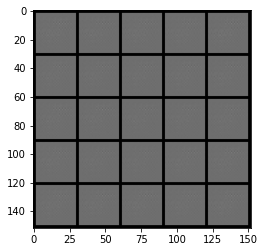

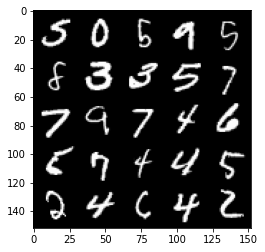

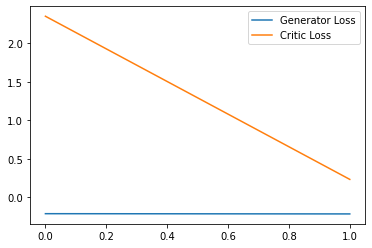

Step 100: Generator loss: 1.8143424832820891, critic loss: -3.4421964118480677


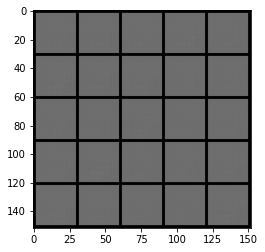

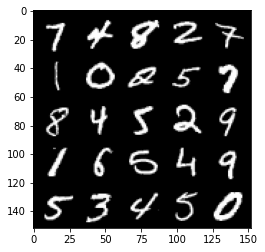

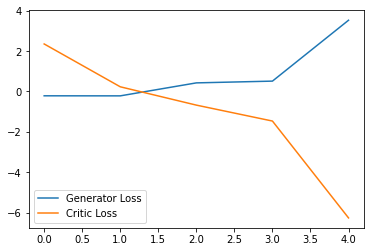

Step 150: Generator loss: 3.261689853668213, critic loss: -14.765733554840088


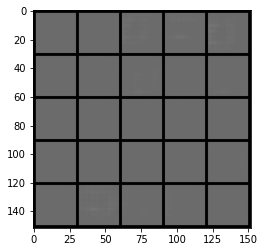

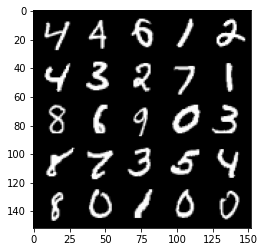

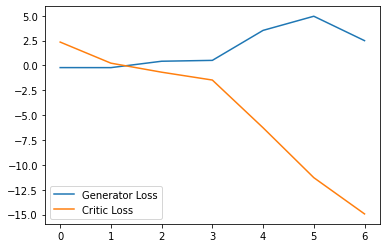

Step 200: Generator loss: 0.22595115847885608, critic loss: -35.69874993133545


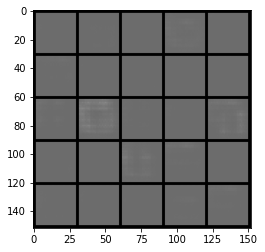

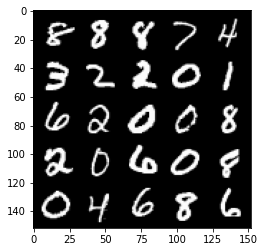

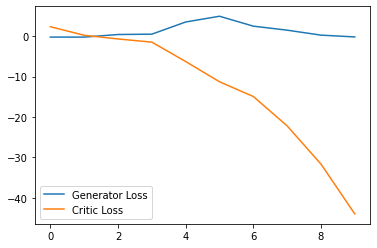

Step 250: Generator loss: -2.079320360943675, critic loss: -72.10561204528808


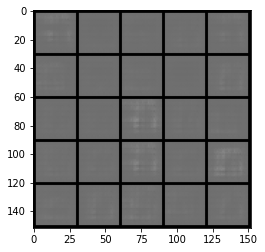

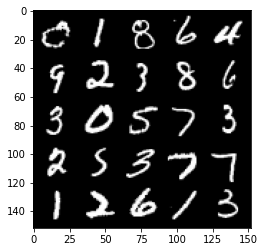

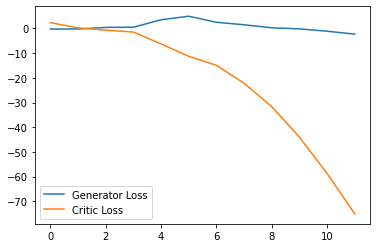

Step 300: Generator loss: -3.091930259168148, critic loss: -121.60446289062494


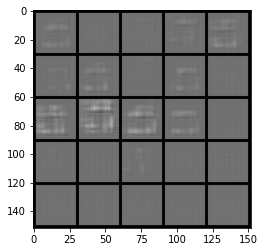

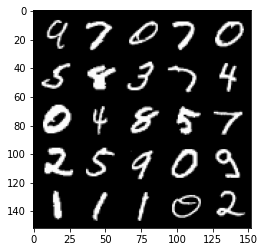

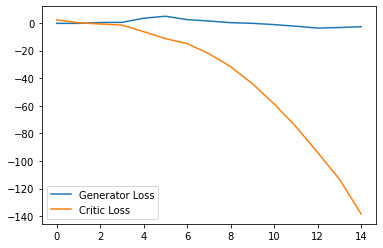

Step 350: Generator loss: -4.344660716056824, critic loss: -176.44657266235353


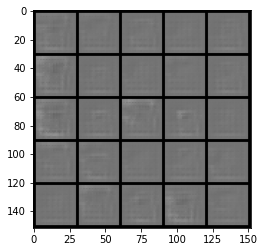

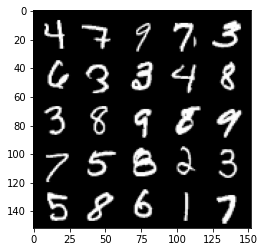

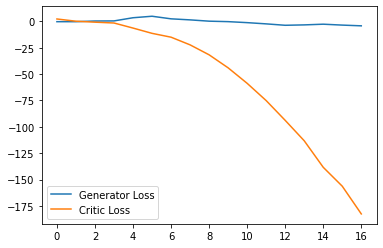

Step 400: Generator loss: -4.332872417867184, critic loss: -239.28334887695306


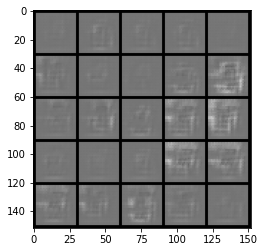

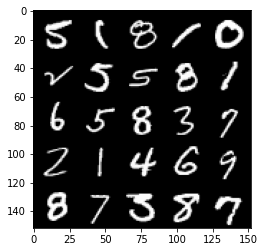

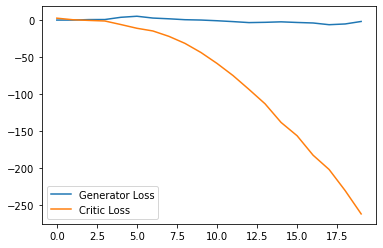

Step 450: Generator loss: 0.23547832250595094, critic loss: -298.6828146972656


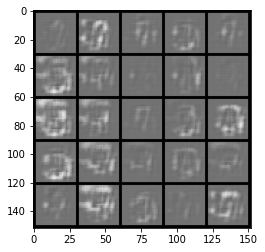

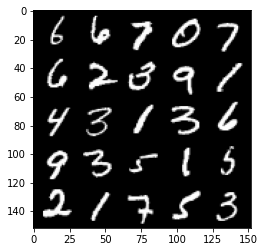

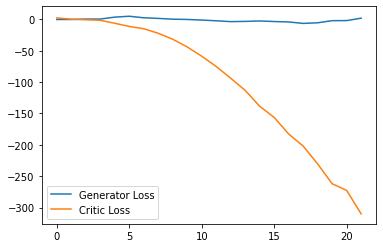

Step 500: Generator loss: -10.818220736384392, critic loss: -337.0650973205567


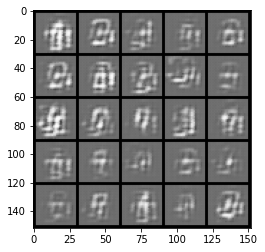

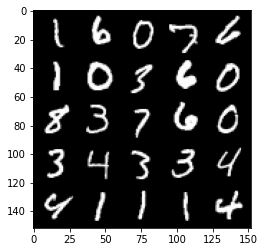

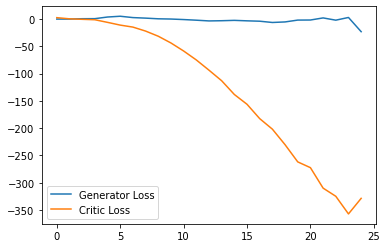

Step 550: Generator loss: -8.058092343509196, critic loss: -363.88410015869135


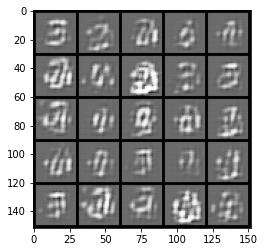

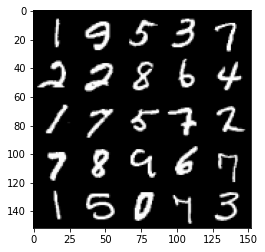

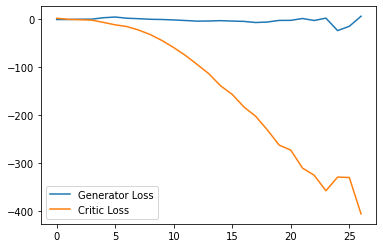

Step 600: Generator loss: -42.18468507528305, critic loss: -291.9114981994628


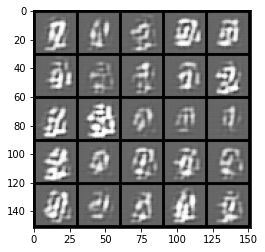

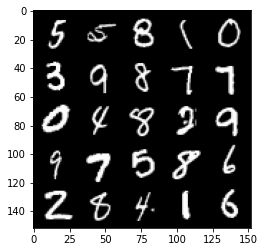

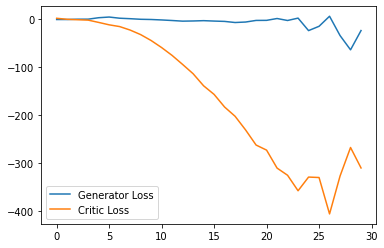

Step 650: Generator loss: -3.263658207654953, critic loss: -355.20587789917


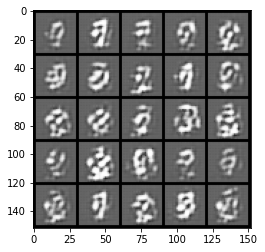

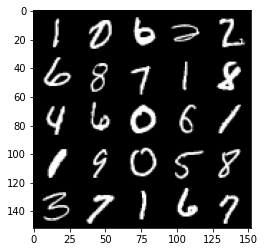

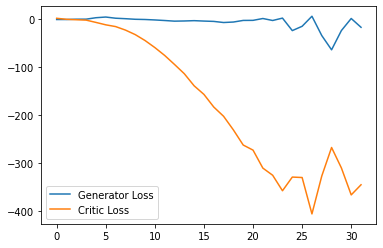

Step 700: Generator loss: 7.369963318109512, critic loss: -458.597748046875


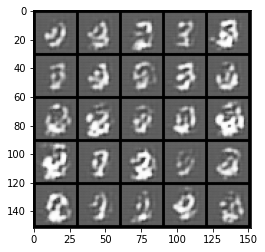

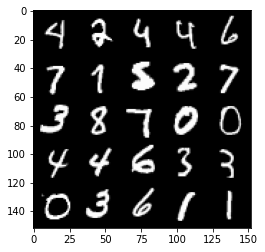

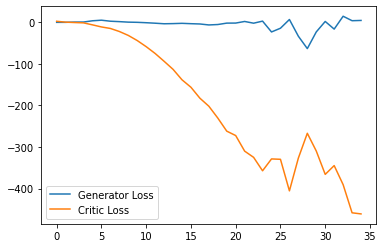

Step 750: Generator loss: -3.8064245271682737, critic loss: -456.0967751464845


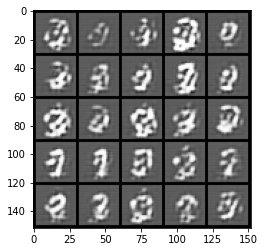

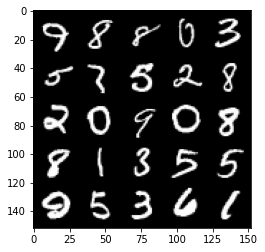

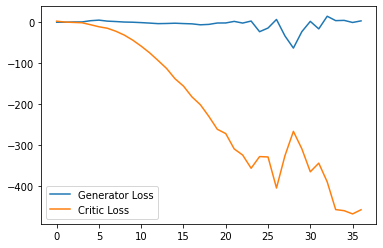

Step 800: Generator loss: -26.58583459854126, critic loss: -403.86205114746116


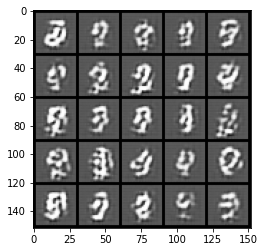

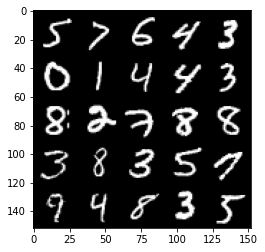

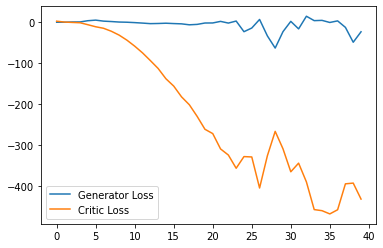

Step 850: Generator loss: -7.098232173919678, critic loss: -433.8201503601072


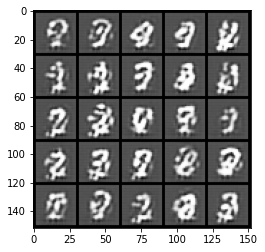

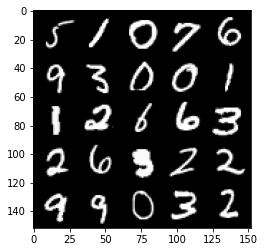

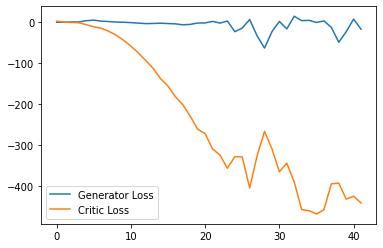

Step 900: Generator loss: -9.909745671749114, critic loss: -426.19729333496116


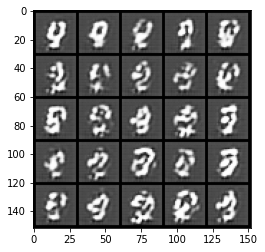

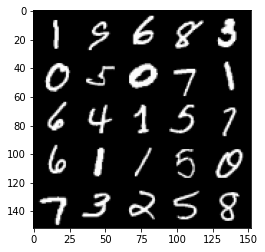

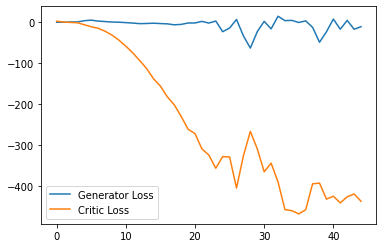

Step 950: Generator loss: -31.580263245105744, critic loss: -380.7703563537597


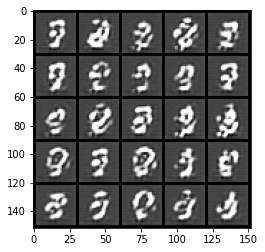

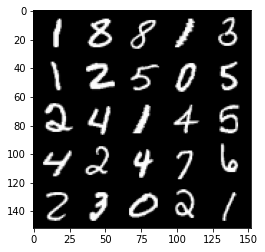

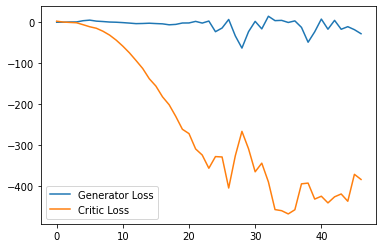

Step 1000: Generator loss: -37.06202445507049, critic loss: -395.2839322814941


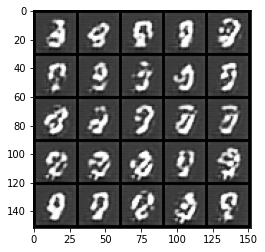

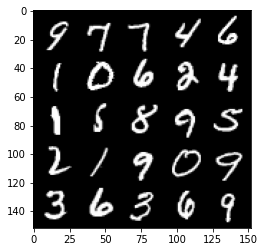

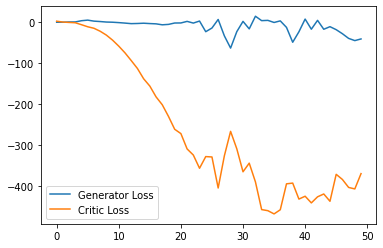

Step 1050: Generator loss: -36.65863758325577, critic loss: -321.0522920227051


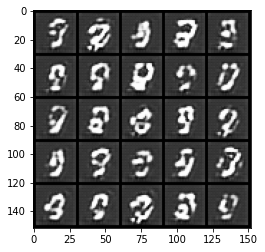

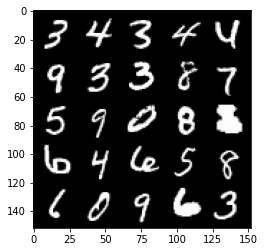

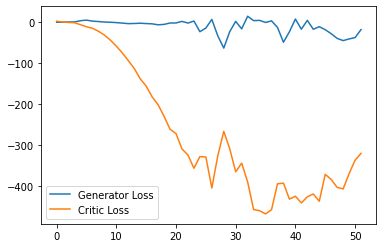

Step 1100: Generator loss: -53.822229437828064, critic loss: -213.00897053527828


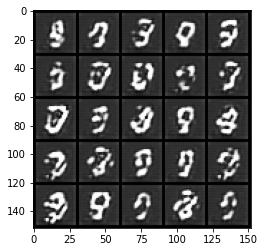

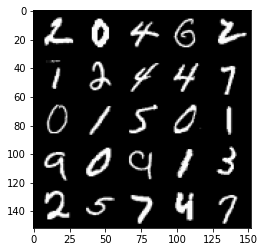

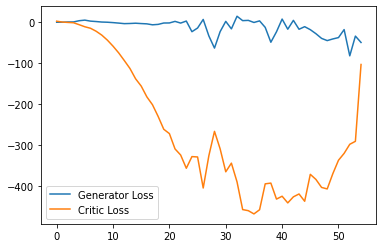

Step 1150: Generator loss: -69.16929622650146, critic loss: -178.89499060058594


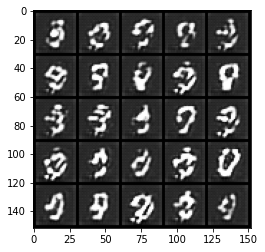

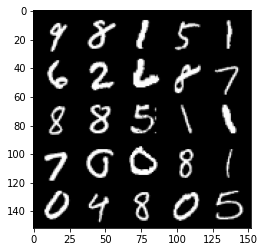

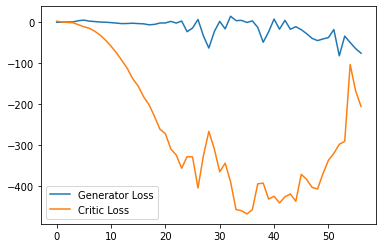

Step 1200: Generator loss: 3.5935745429992676, critic loss: 71.76260684967039


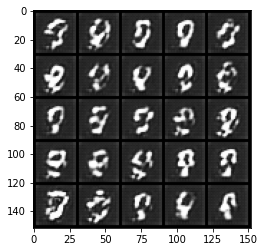

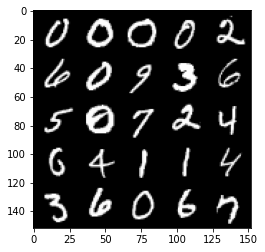

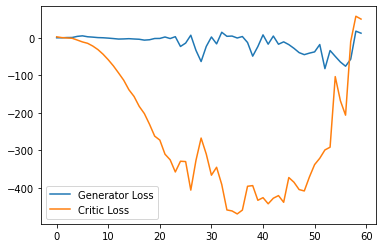

Step 1250: Generator loss: 5.14841739654541, critic loss: 35.61609298324584


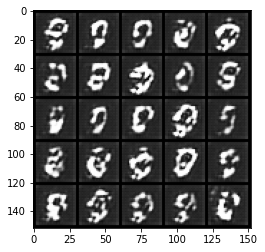

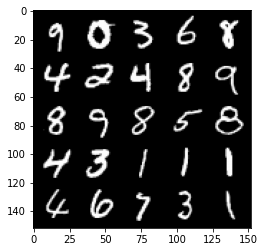

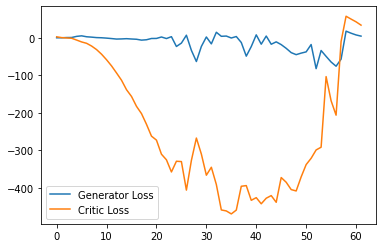

Step 1300: Generator loss: 1.9602039170265197, critic loss: 28.209185760498045


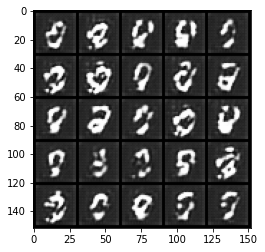

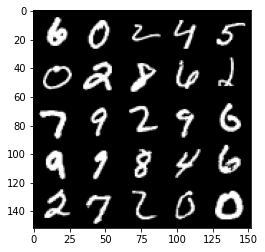

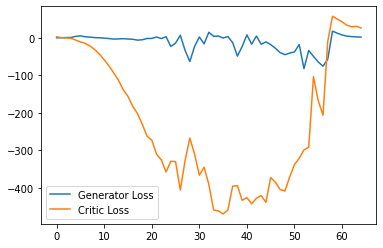

Step 1350: Generator loss: 1.1954614955186844, critic loss: 17.436128799438475


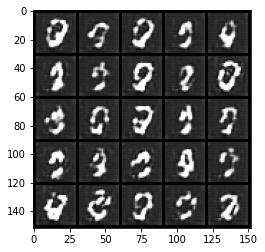

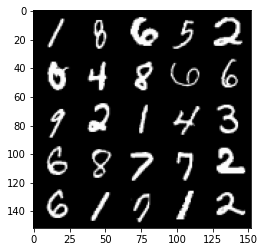

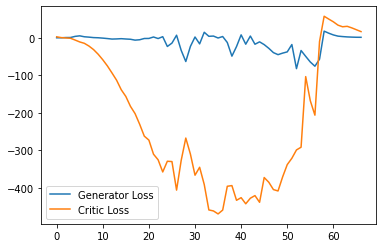

Step 1400: Generator loss: 1.8236175274848938, critic loss: 9.592158580780028


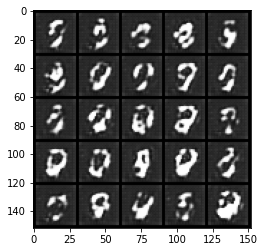

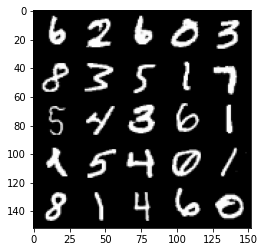

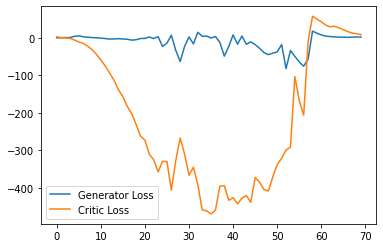

Step 1450: Generator loss: 0.47050410002470017, critic loss: 8.813685394287113


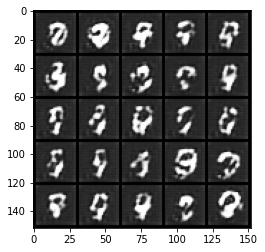

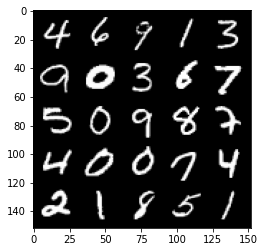

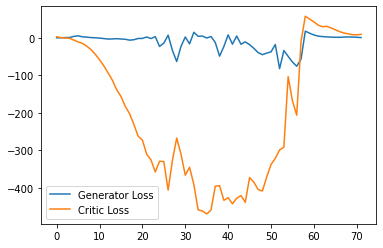

Step 1500: Generator loss: -0.8541952504217625, critic loss: 14.914309183120729


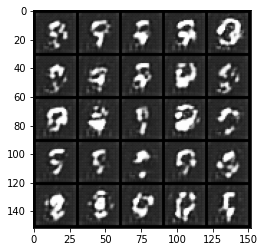

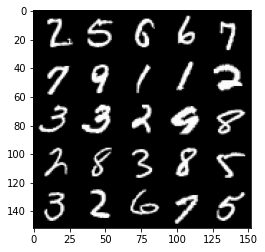

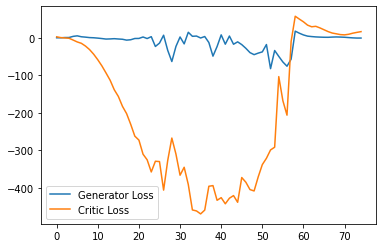

Step 1550: Generator loss: -2.5223357772827146, critic loss: 17.02784041213989


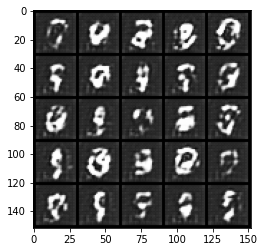

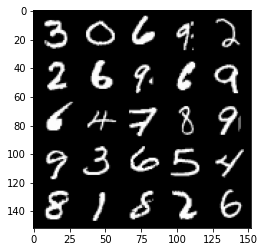

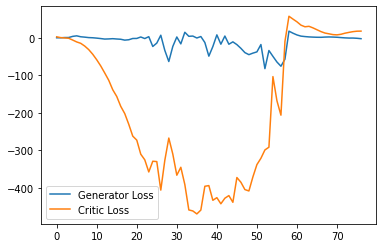

Step 1600: Generator loss: -5.13243305683136, critic loss: 12.270055578231814


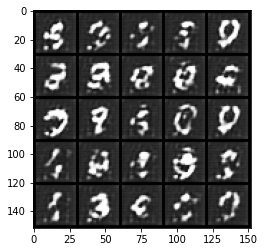

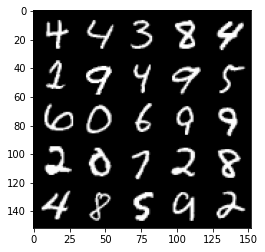

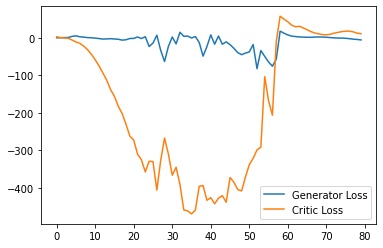

Step 1650: Generator loss: -7.32991289138794, critic loss: 8.40022766685486


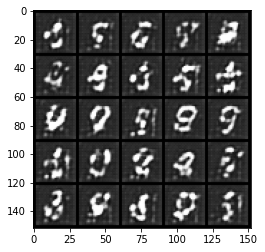

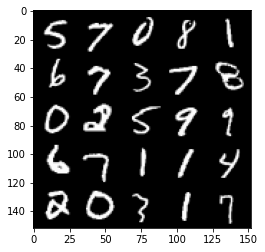

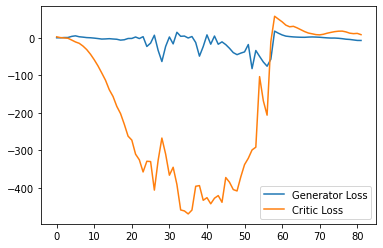

Step 1700: Generator loss: -8.809821710586547, critic loss: 3.3245817174911485


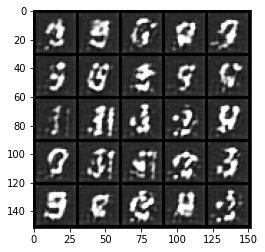

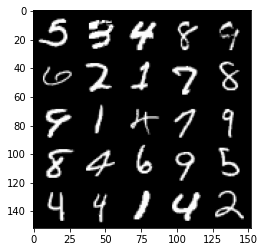

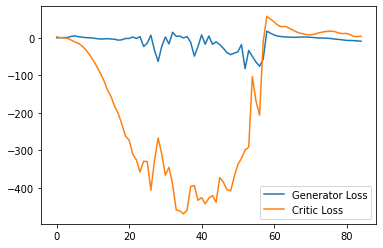

Step 1750: Generator loss: -10.424924755096436, critic loss: 3.6700599460601815


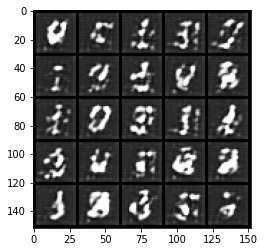

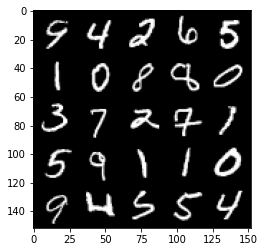

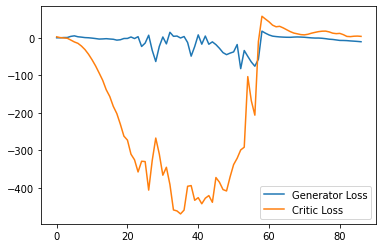

Step 1800: Generator loss: -10.432615146636962, critic loss: 1.2672779865264894


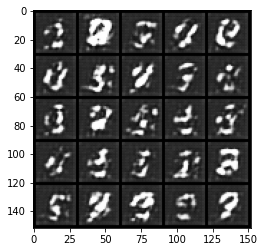

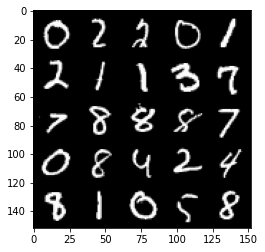

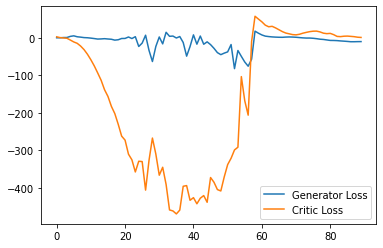

Step 1850: Generator loss: -9.798213481903076, critic loss: 0.6601825227737425


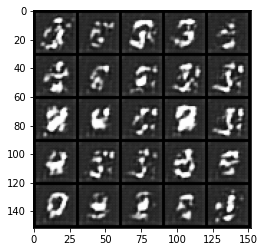

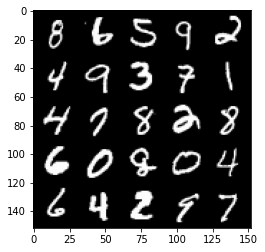

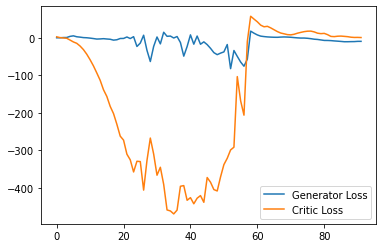

Step 1900: Generator loss: -10.688803520202637, critic loss: -0.45874497795104974


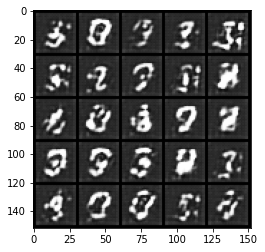

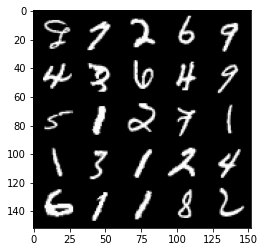

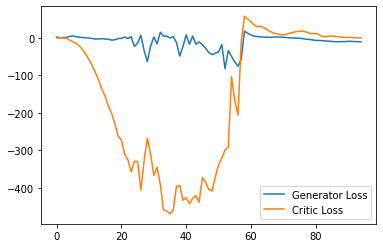

Step 1950: Generator loss: -11.30787977218628, critic loss: -1.3175687332153323


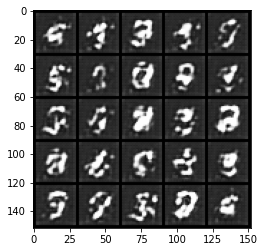

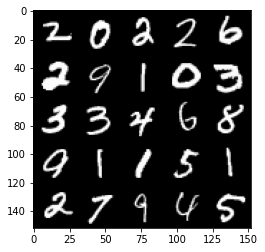

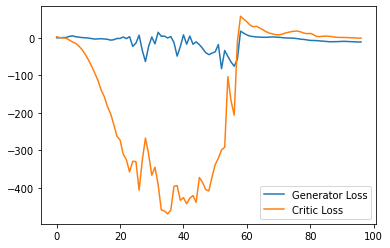

Step 2000: Generator loss: -11.05393816947937, critic loss: -2.585806922912598


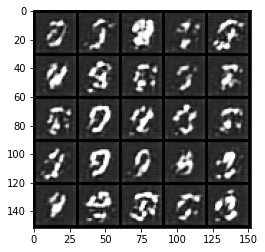

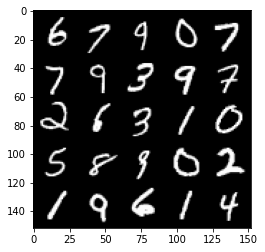

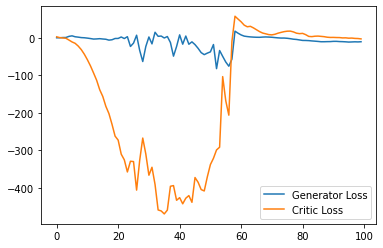

Step 2050: Generator loss: -11.049962081909179, critic loss: -4.969123596191406


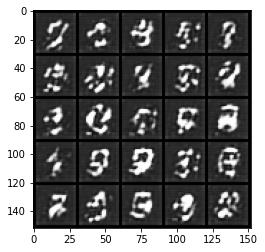

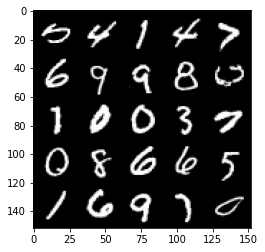

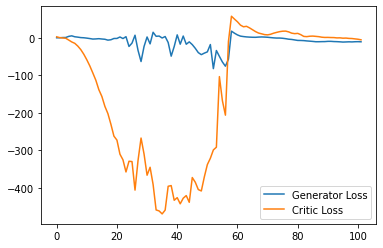

Step 2100: Generator loss: -11.280227360725403, critic loss: -7.353119659423827


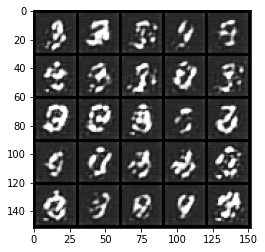

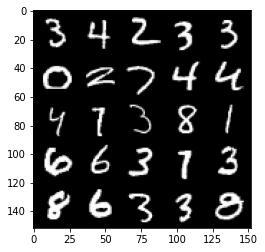

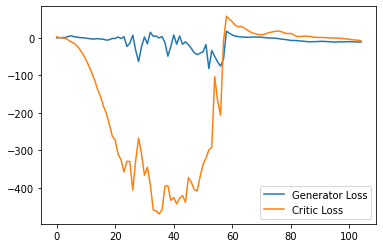

Step 2150: Generator loss: -11.231878250688315, critic loss: -12.932222476959227


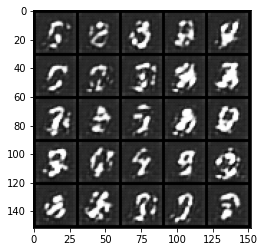

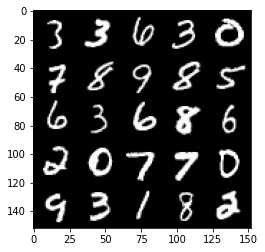

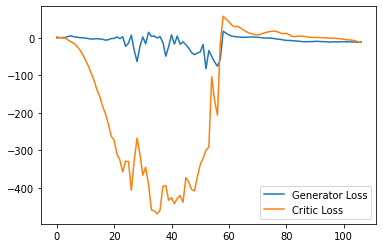

Step 2200: Generator loss: -10.418085927963256, critic loss: -18.18429631805421


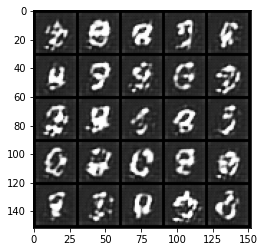

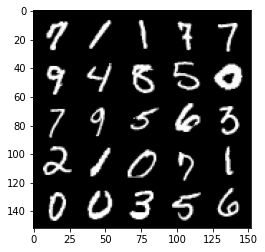

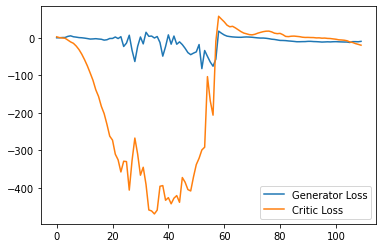

Step 2250: Generator loss: -9.673493497222662, critic loss: -21.37328456878662


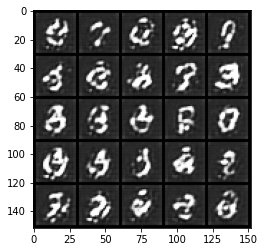

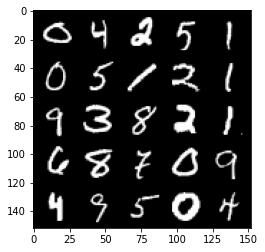

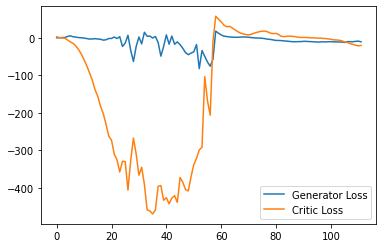

Step 2300: Generator loss: -8.143805830776692, critic loss: -21.755088722229


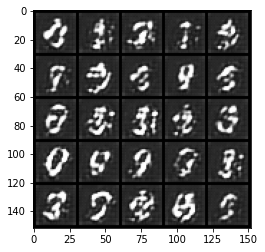

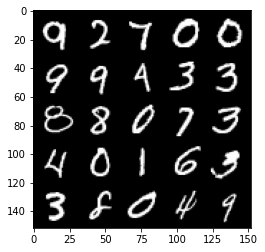

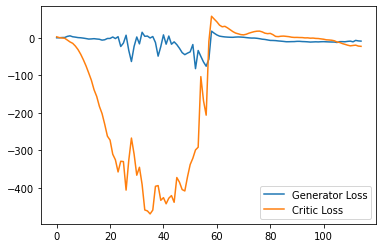

Step 2350: Generator loss: -6.258554546833039, critic loss: -27.059223632812497


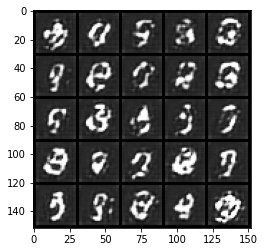

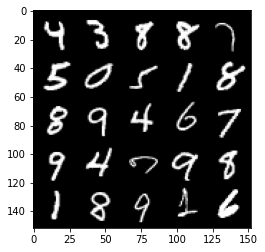

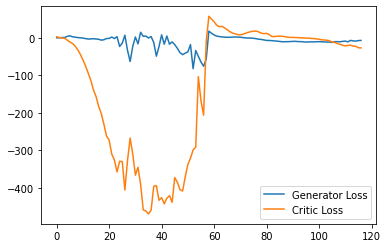

Step 2400: Generator loss: -5.93749341249466, critic loss: -23.80191843032837


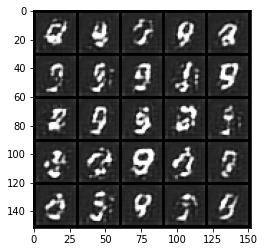

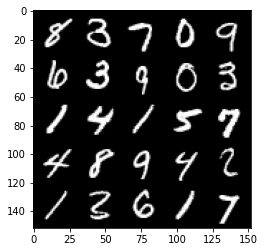

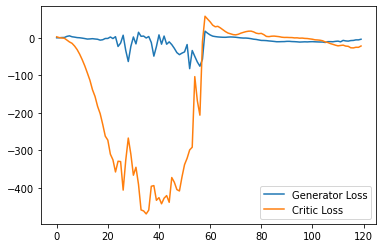

Step 2450: Generator loss: -3.134035040140152, critic loss: -27.914171142578134


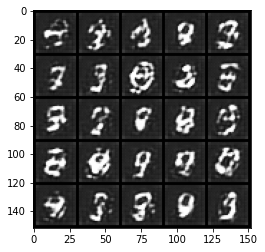

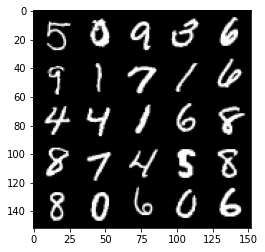

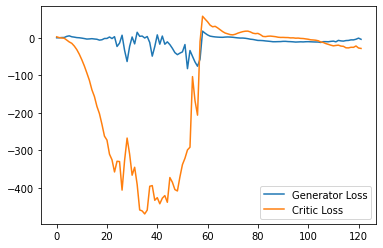

Step 2500: Generator loss: -3.8086211848258973, critic loss: -29.980761013031


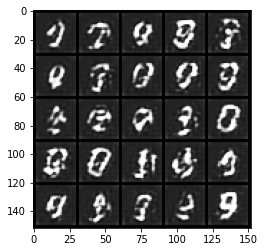

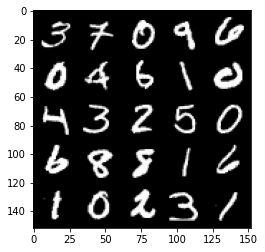

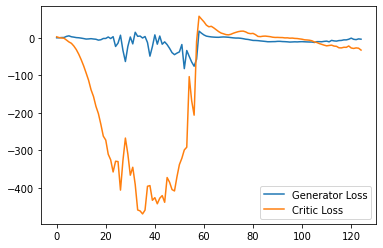

Step 2550: Generator loss: -1.0814447009563446, critic loss: -34.404960762023926


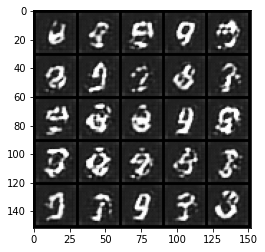

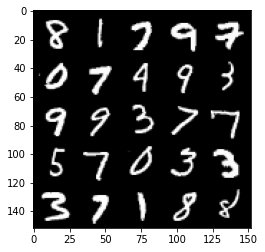

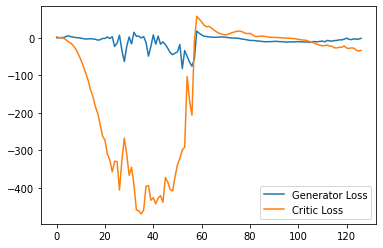

Step 2600: Generator loss: -0.09700077354907989, critic loss: -36.77468470382691


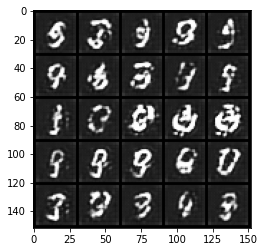

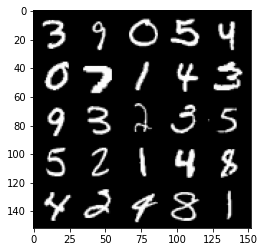

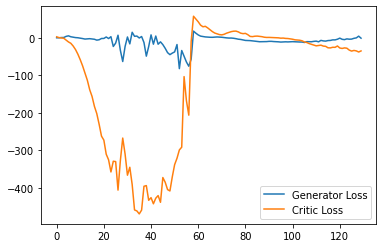

Step 2650: Generator loss: 2.0794268810749053, critic loss: -32.39235552215576


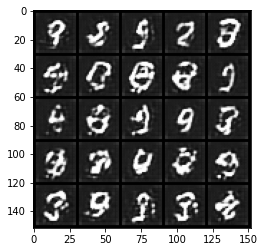

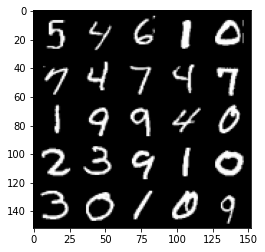

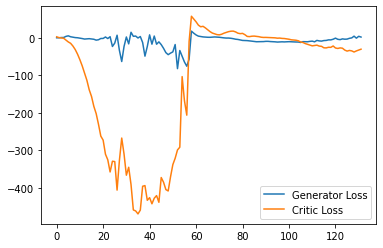

Step 2700: Generator loss: 6.503777751922607, critic loss: 9.4969227104187


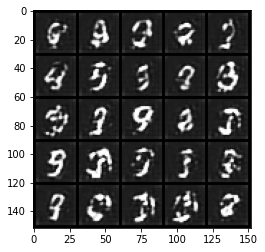

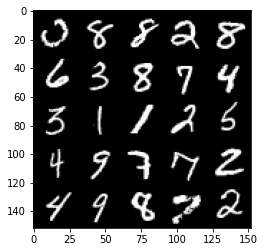

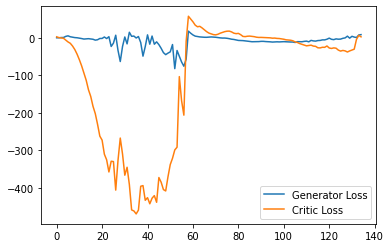

Step 2750: Generator loss: 7.913818225860596, critic loss: 0.9609254341125488


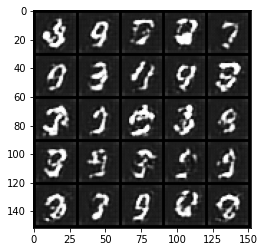

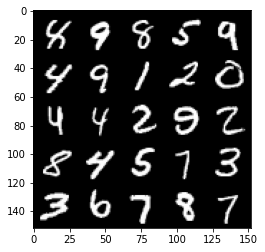

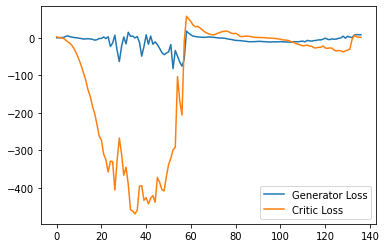

Step 2800: Generator loss: 7.104386959075928, critic loss: -0.17618009710311885


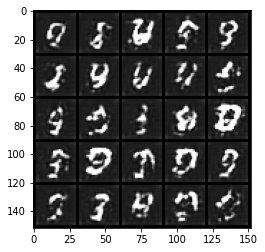

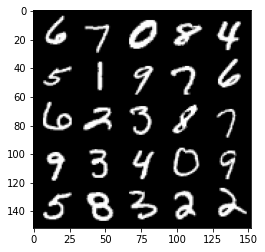

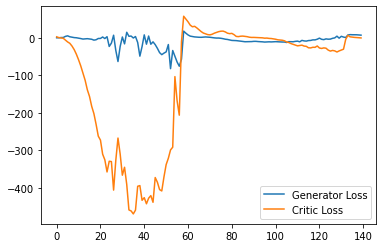

Step 2850: Generator loss: 4.587130680084228, critic loss: -0.5207698316574096


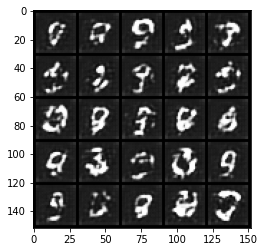

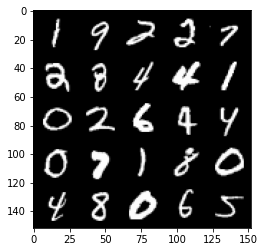

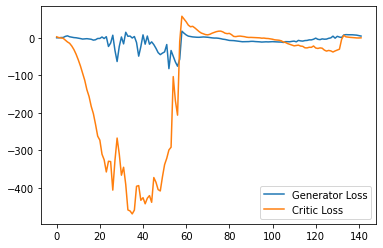

Step 2900: Generator loss: 2.3505925488471986, critic loss: -0.752100881099701


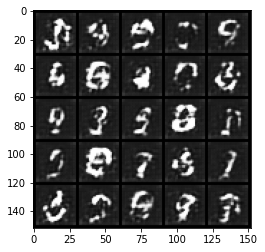

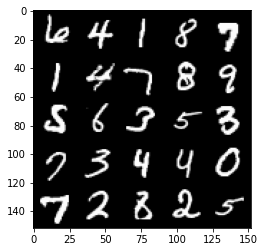

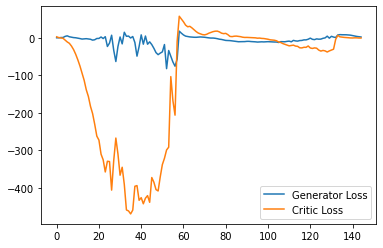

Step 2950: Generator loss: 0.8960218477249146, critic loss: -1.373083963871002


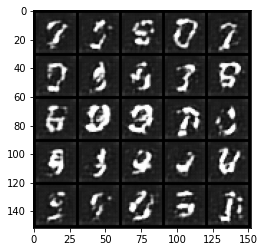

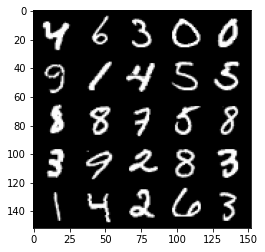

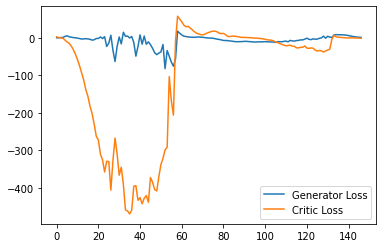

Step 3000: Generator loss: 0.27769581153988837, critic loss: -1.8852691431045532


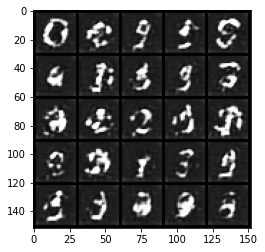

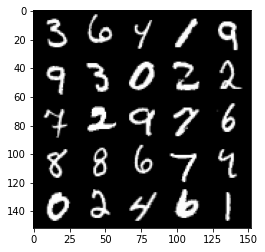

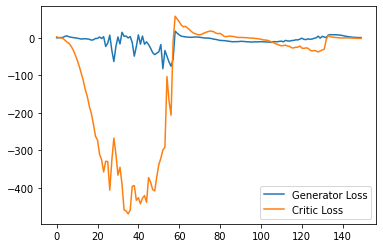

Step 3050: Generator loss: -0.5890672436356544, critic loss: -2.467374052047729


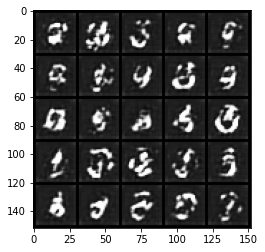

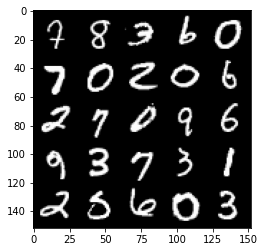

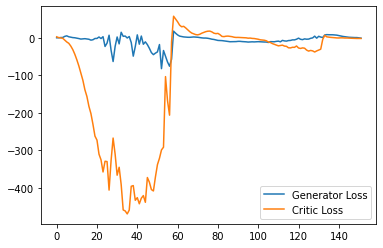

Step 3100: Generator loss: -0.9582643474638463, critic loss: -13.790636989593501


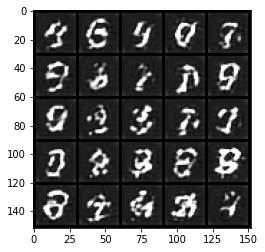

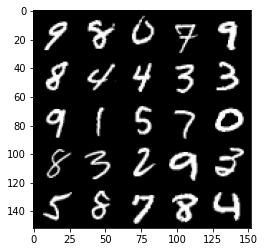

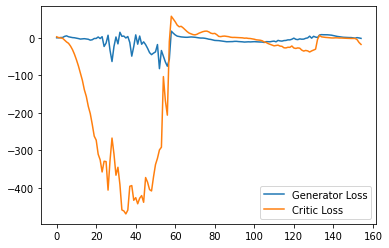

Step 3150: Generator loss: 2.334031999707222, critic loss: -16.96043170928956


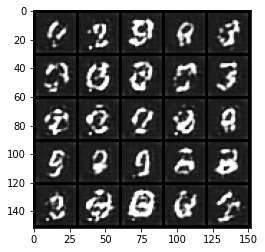

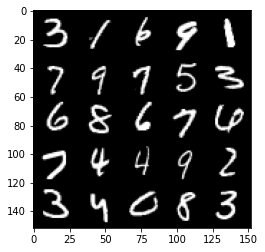

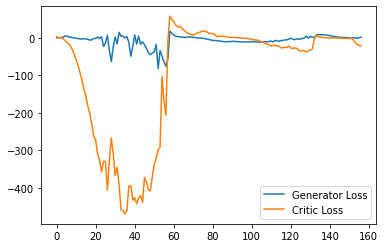

Step 3200: Generator loss: 5.207018532156944, critic loss: -17.76199840068817


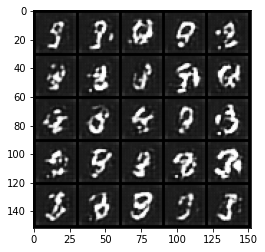

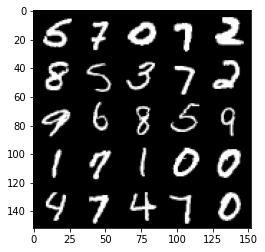

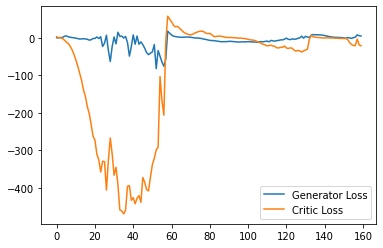

Step 3250: Generator loss: 5.01418805539608, critic loss: -23.63501583194732


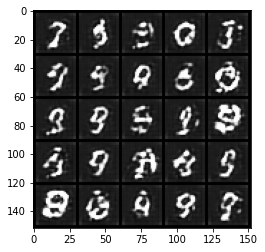

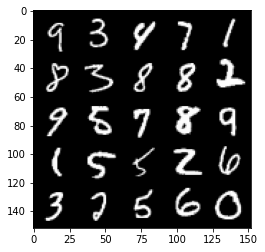

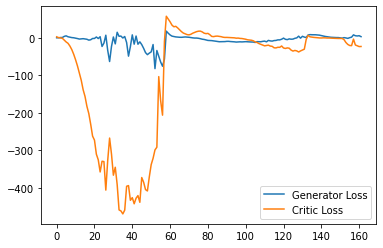

Step 3300: Generator loss: 3.879947657883167, critic loss: -20.921661432266234


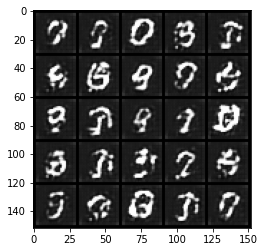

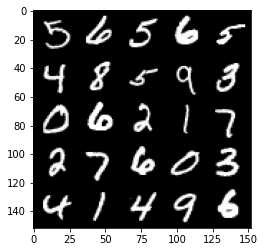

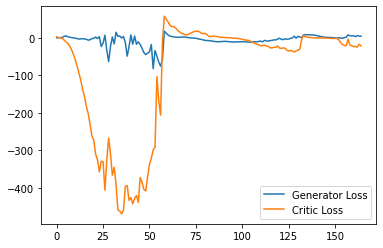

Step 3350: Generator loss: 2.3575452047586443, critic loss: -23.728736780166628


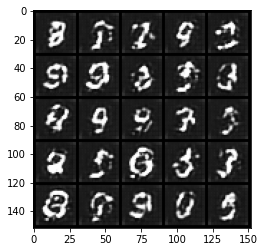

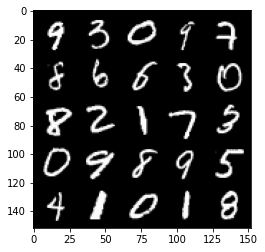

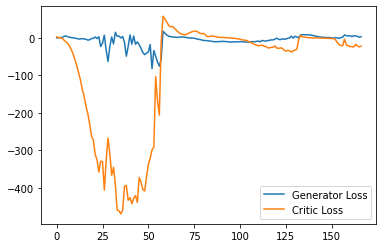

Step 3400: Generator loss: 4.729807344675064, critic loss: -22.83627274322509


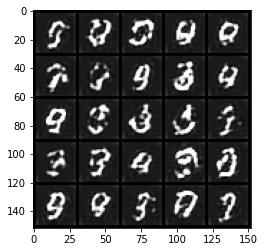

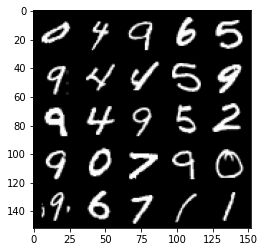

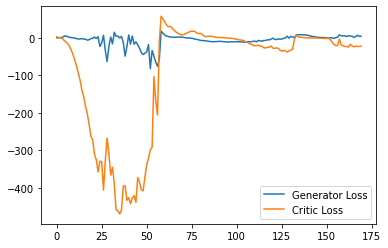

Step 3450: Generator loss: 6.114230619668961, critic loss: -22.31489072608948


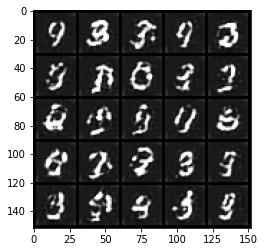

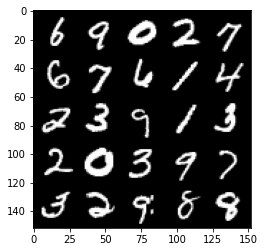

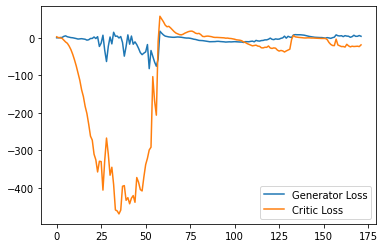

Step 3500: Generator loss: 7.454324989318848, critic loss: -19.000896042823793


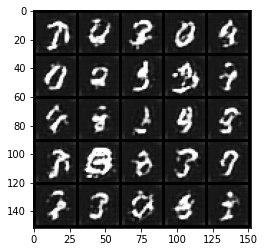

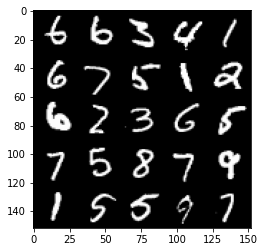

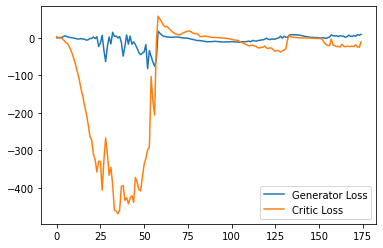

Step 3550: Generator loss: 4.464305299520492, critic loss: -20.166806100845335


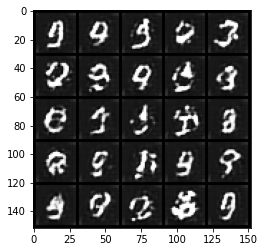

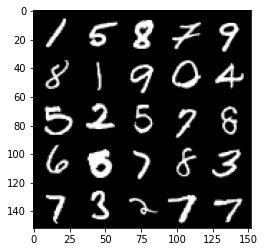

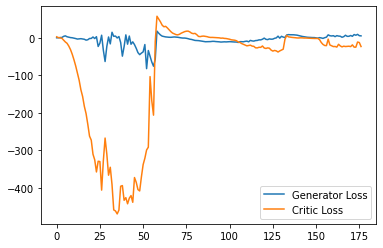

Step 3600: Generator loss: 11.660189555883408, critic loss: -8.936070262908936


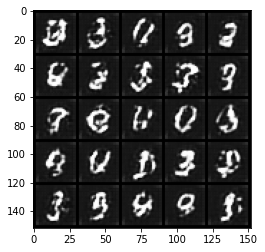

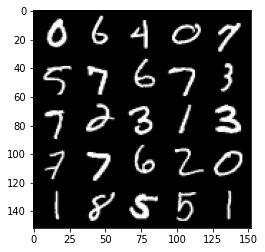

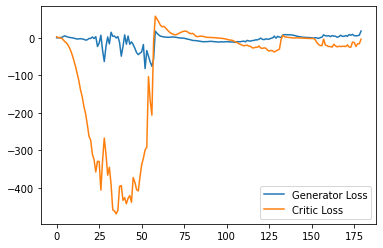

Step 3650: Generator loss: 6.03936130464077, critic loss: -20.985331439018246


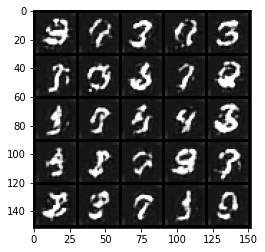

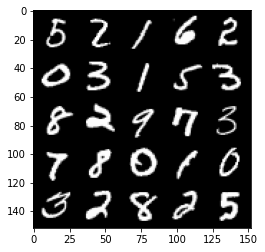

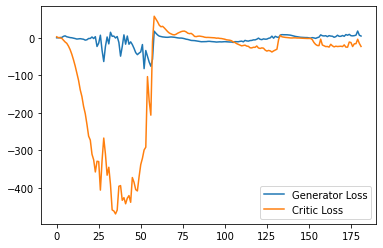

Step 3700: Generator loss: 10.985385611057282, critic loss: -16.050303129196166


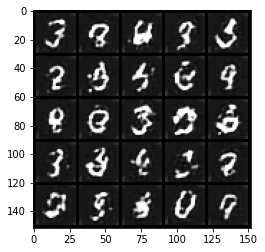

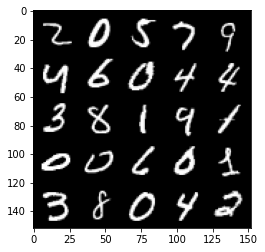

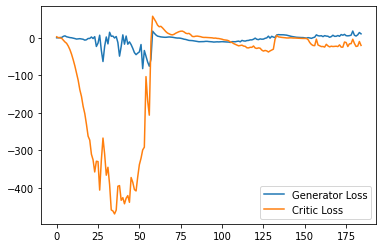

Step 3750: Generator loss: 8.170921273231507, critic loss: -23.45162905311585


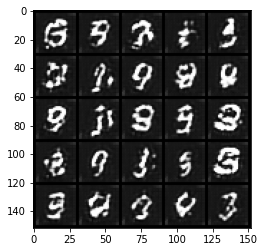

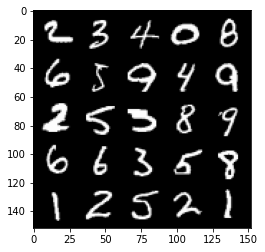

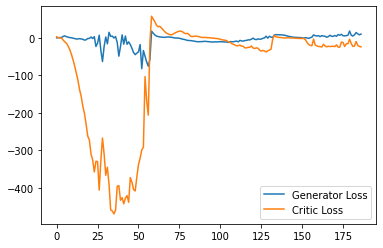

Step 3800: Generator loss: 14.21005307674408, critic loss: -19.8571382188797


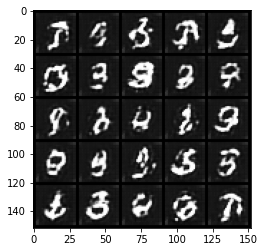

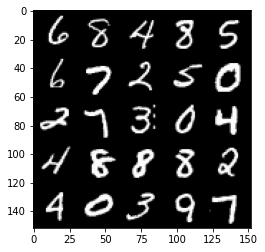

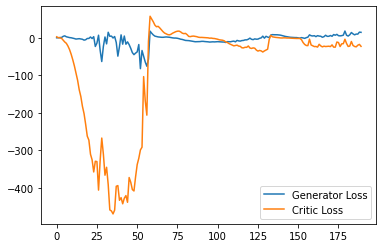

Step 3850: Generator loss: 14.461462335586548, critic loss: -21.054392665863038


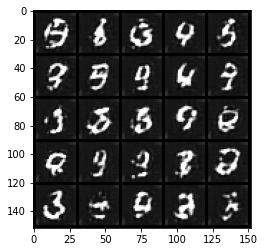

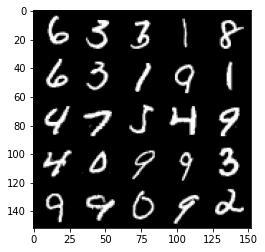

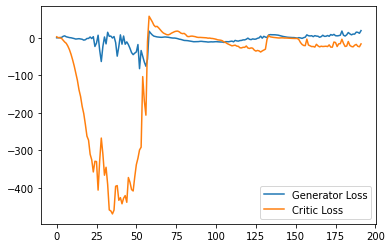

Step 3900: Generator loss: 15.782453489303588, critic loss: -22.786691160202032


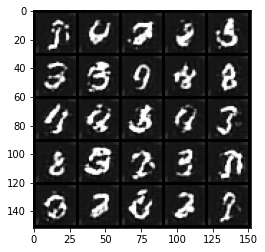

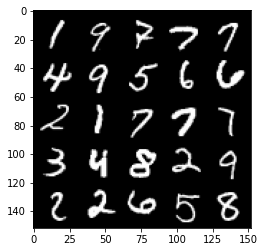

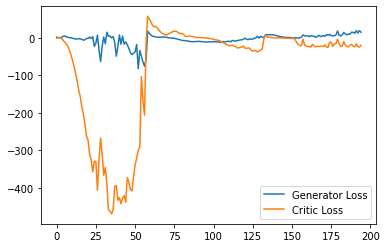

Step 3950: Generator loss: 11.047058904767036, critic loss: -21.428408836364742


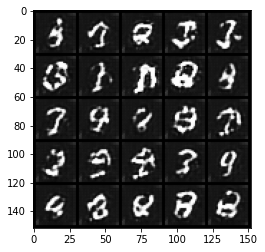

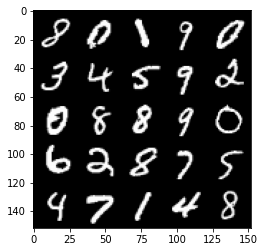

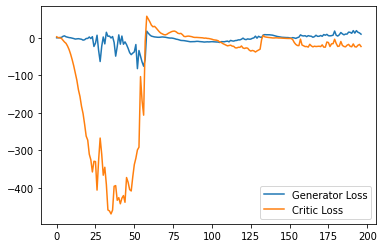

Step 4000: Generator loss: 13.007242147922517, critic loss: -26.144711471557606


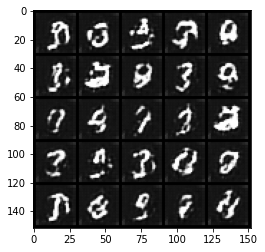

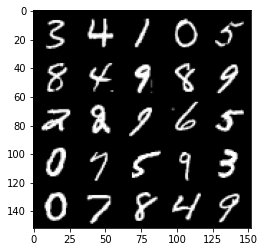

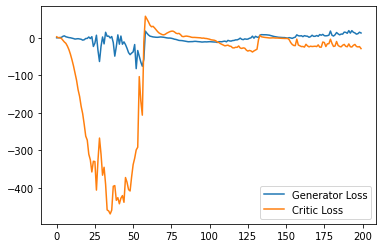

Step 4050: Generator loss: 18.302687420845032, critic loss: -9.894422464847567


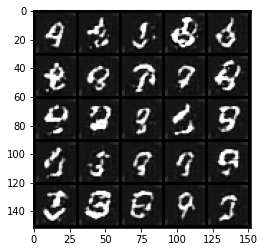

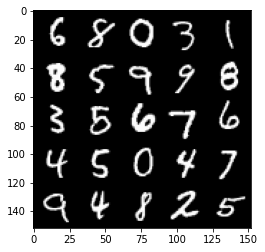

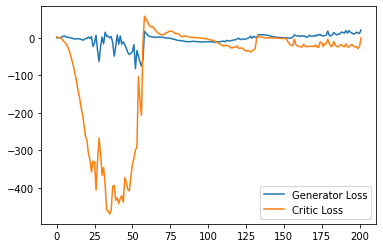

Step 4100: Generator loss: 23.752605438232422, critic loss: -3.383663372039795


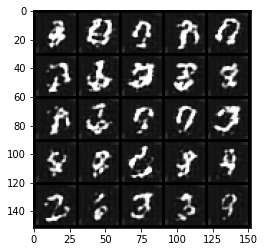

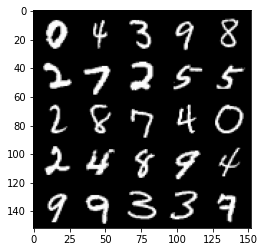

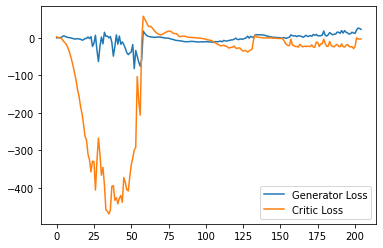

Step 4150: Generator loss: 16.372600538730623, critic loss: -6.798970022201537


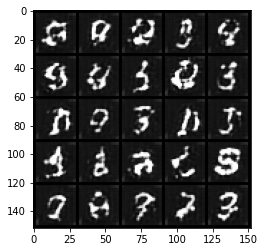

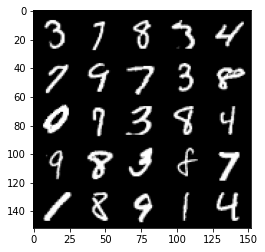

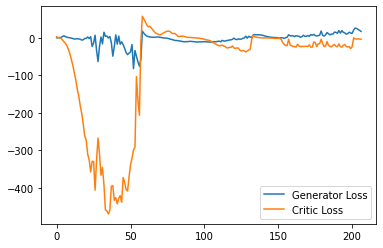

Step 4200: Generator loss: 17.344601711034773, critic loss: -2.4874292097091666


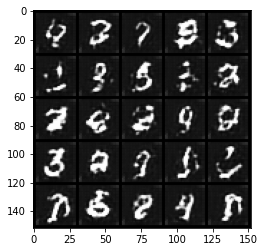

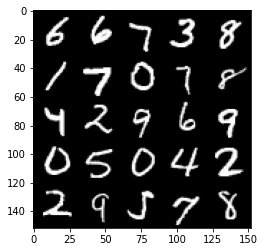

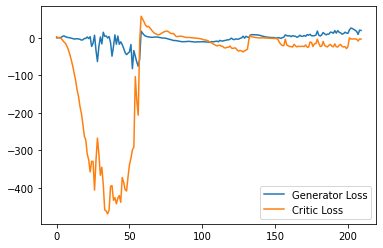

Step 4250: Generator loss: 16.837366542816163, critic loss: -3.5765383758544926


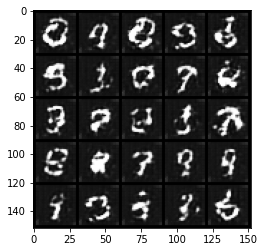

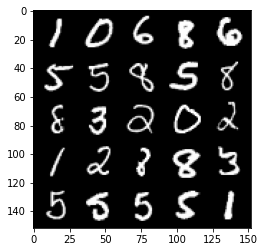

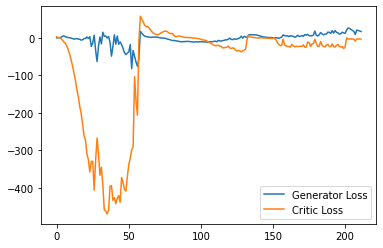

Step 4300: Generator loss: 6.591481613218784, critic loss: -22.05518814373016


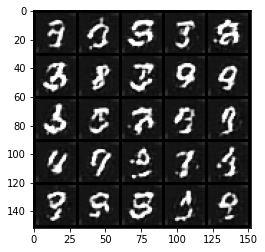

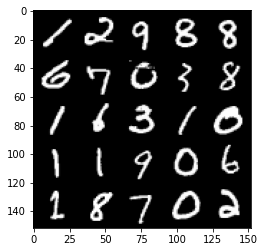

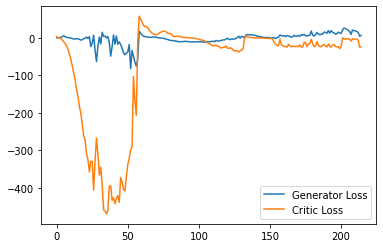

Step 4350: Generator loss: 18.914436675310135, critic loss: -3.5436416797637933


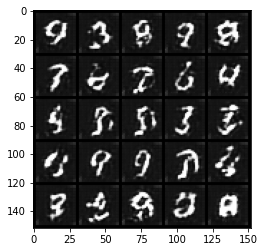

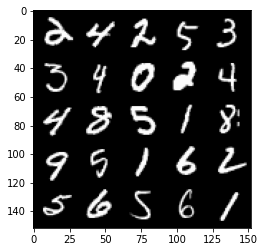

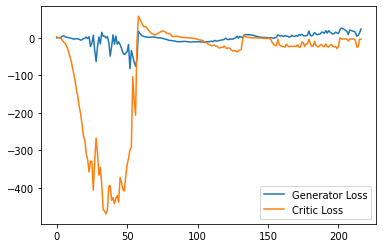

Step 4400: Generator loss: 12.517164142131806, critic loss: -10.468470070838928


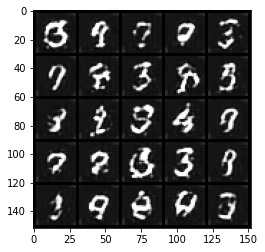

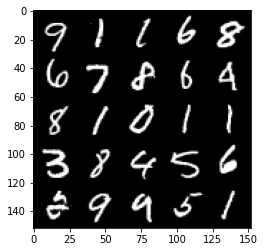

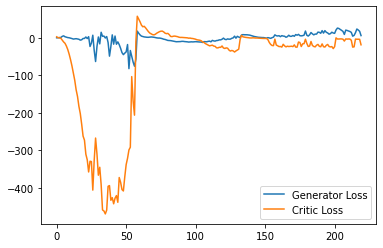

Step 4450: Generator loss: 16.3440182480216, critic loss: 0.4804287800788887


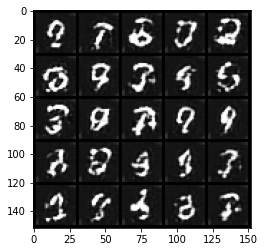

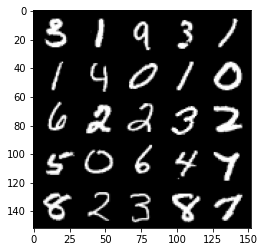

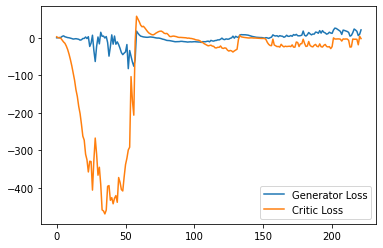

Step 4500: Generator loss: 16.30541347503662, critic loss: -2.447590088367462


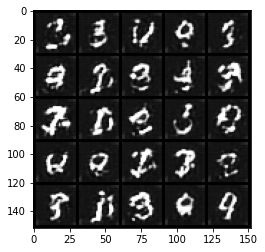

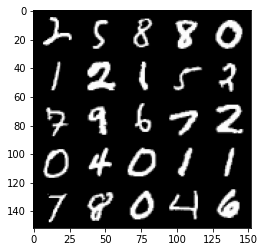

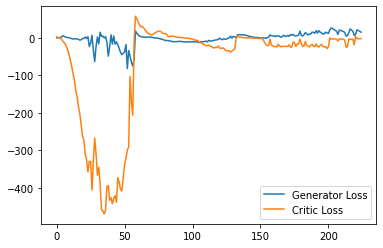

Step 4550: Generator loss: 12.40742208480835, critic loss: -2.6823916740417477


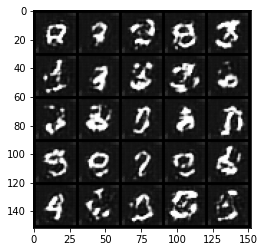

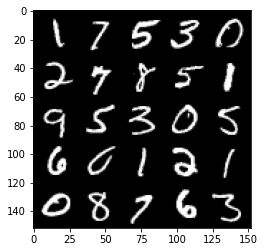

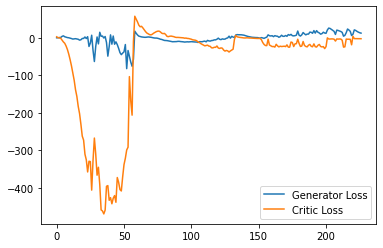

Step 4600: Generator loss: 11.13388614654541, critic loss: -3.0756942901611324


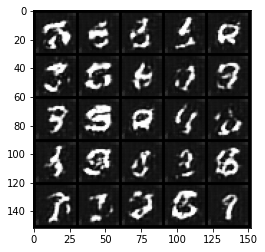

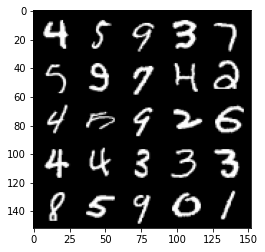

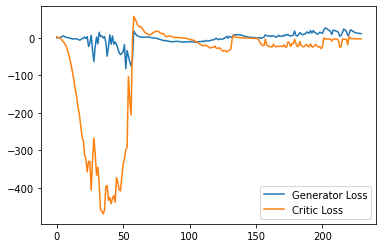

Step 4650: Generator loss: 10.339687538146972, critic loss: -3.5544668979644767


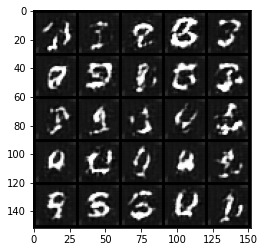

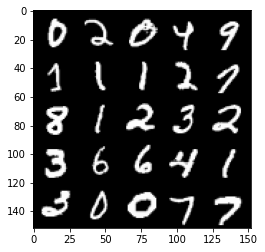

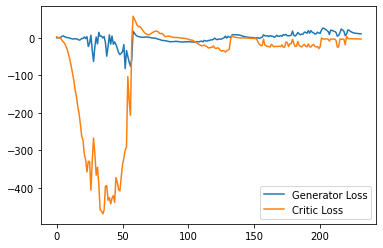

Step 4700: Generator loss: 9.820617065429687, critic loss: -4.15658194065094


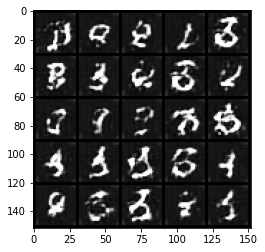

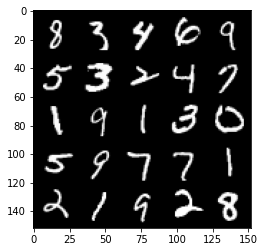

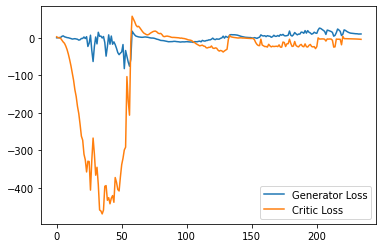

Step 4750: Generator loss: 1.2978111132979393, critic loss: -19.2374353055954


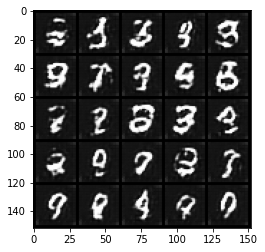

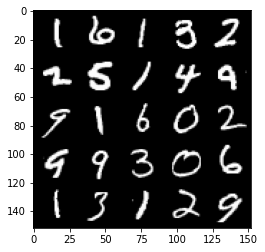

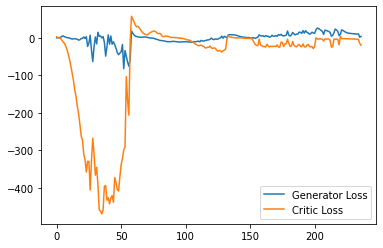

Step 4800: Generator loss: 1.9434726312756538, critic loss: -23.471805977821347


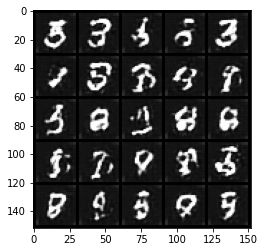

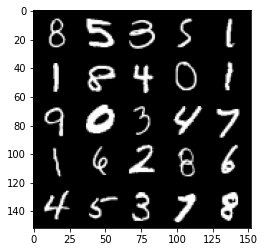

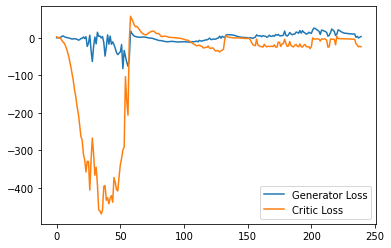

Step 4850: Generator loss: 15.759750472307205, critic loss: 2.463423791885373


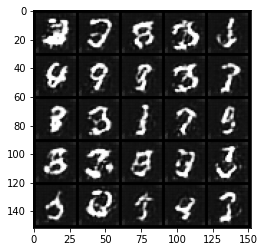

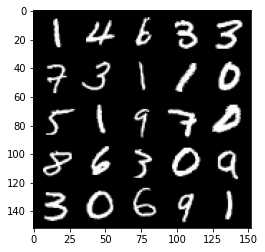

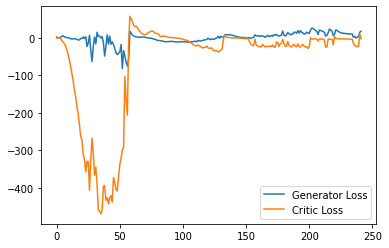

Step 4900: Generator loss: 10.5276540184021, critic loss: -2.8988566026687623


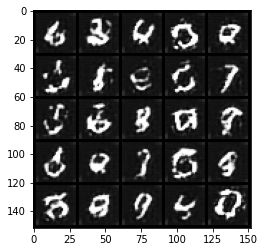

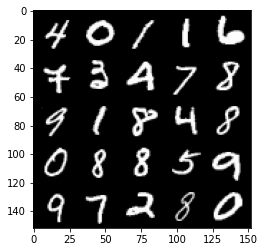

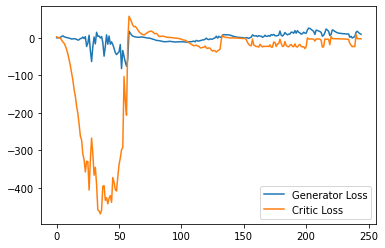

Step 4950: Generator loss: 6.807906708717346, critic loss: -4.042167043685913


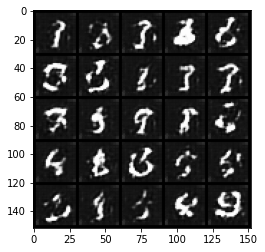

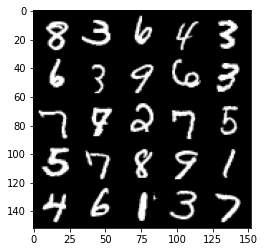

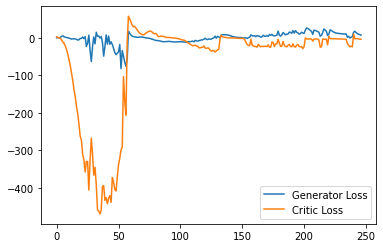

Step 5000: Generator loss: 0.22542327105998994, critic loss: -12.345905193328859


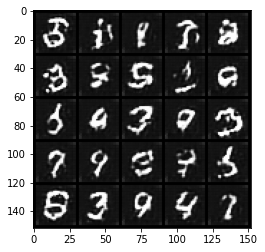

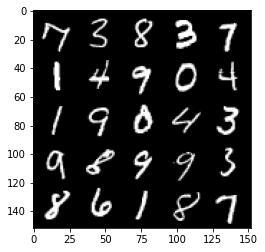

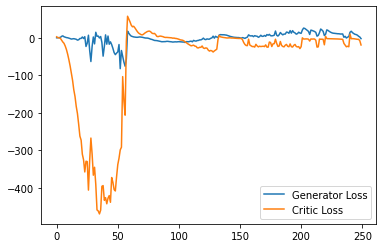

Step 5050: Generator loss: 1.400885568857193, critic loss: -20.218596828460694


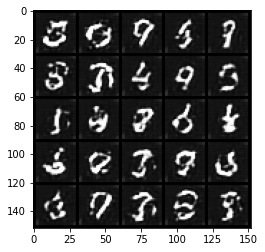

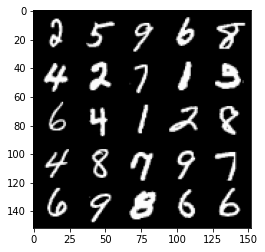

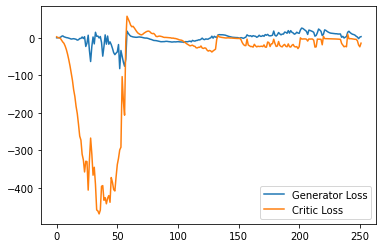

Step 5100: Generator loss: 2.5023143982887266, critic loss: -20.88062337303162


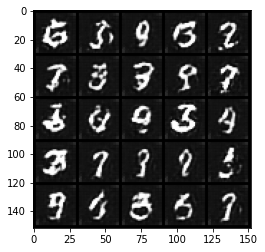

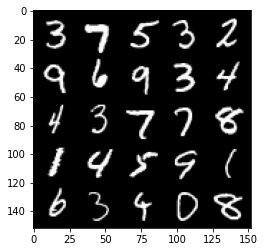

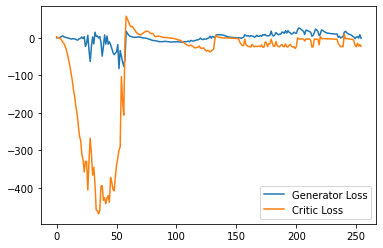

Step 5150: Generator loss: 8.302805270552636, critic loss: -11.923173518180848


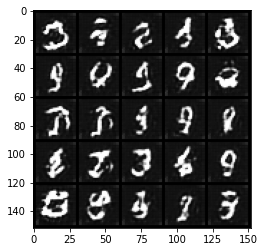

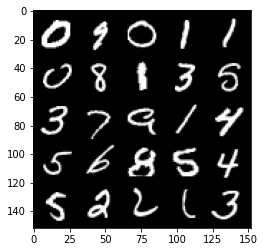

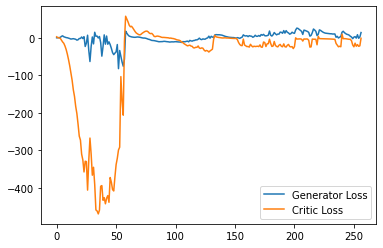

Step 5200: Generator loss: 0.6323949372768403, critic loss: -22.076692724227904


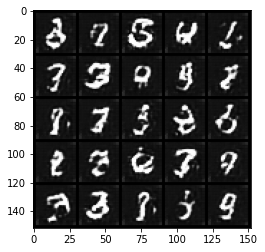

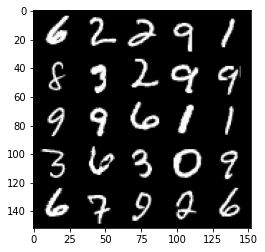

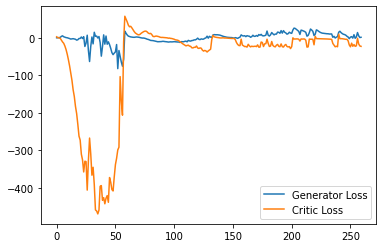

Step 5250: Generator loss: 10.759599823355675, critic loss: -3.1310696039199852


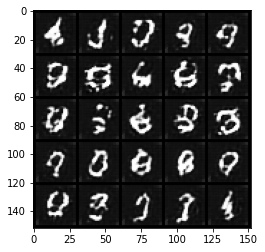

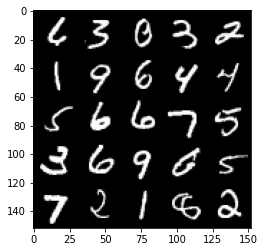

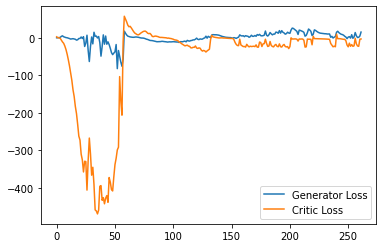

Step 5300: Generator loss: 9.898092136383056, critic loss: -3.56295147705078


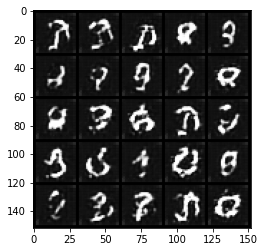

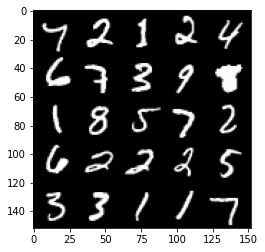

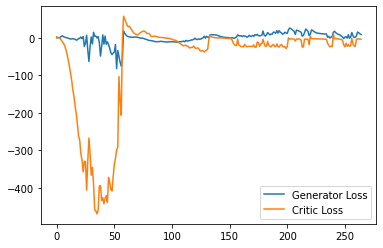

Step 5350: Generator loss: 6.246337788105011, critic loss: -6.155603369712829


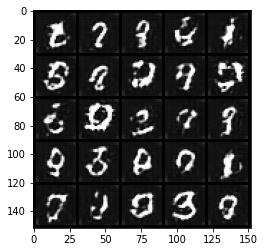

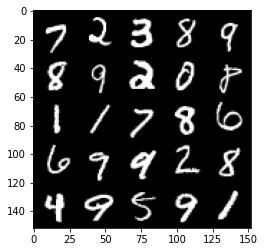

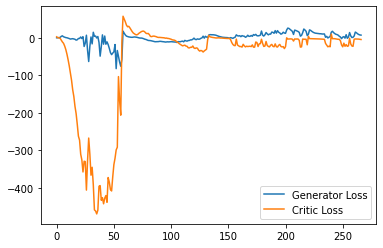

Step 5400: Generator loss: 3.4252364695072175, critic loss: -17.46699629592895


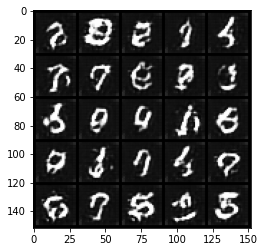

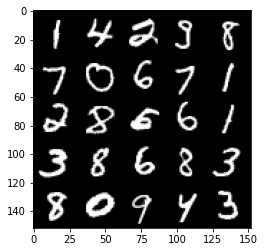

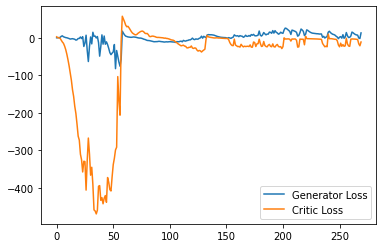

Step 5450: Generator loss: 5.945067245960235, critic loss: -12.841557687759403


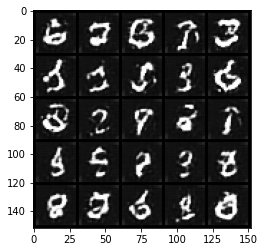

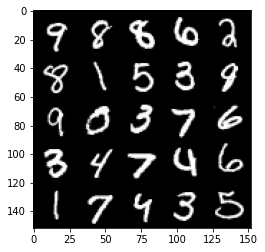

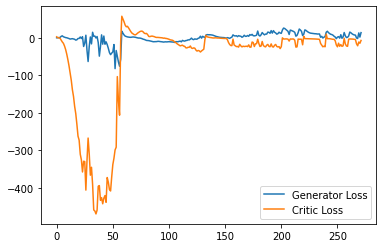

Step 5500: Generator loss: -3.2385525943338873, critic loss: -21.37043306827546


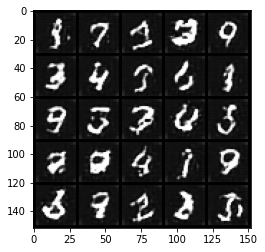

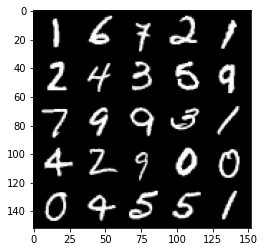

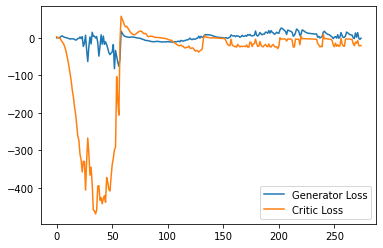

Step 5550: Generator loss: 10.195962613224983, critic loss: -6.094355474472045


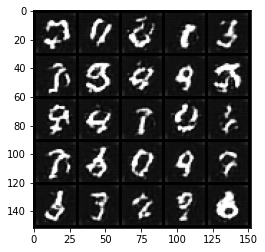

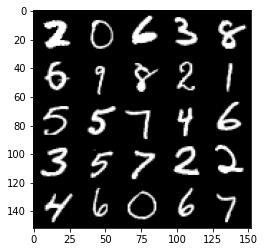

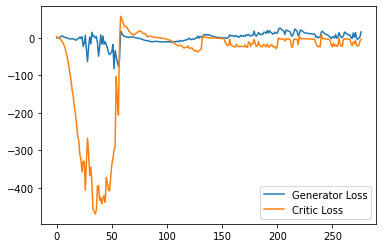

Step 5600: Generator loss: 1.96785740762949, critic loss: -11.5017483587265


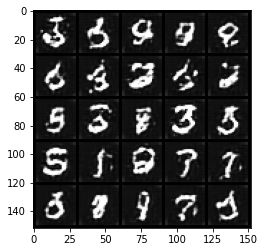

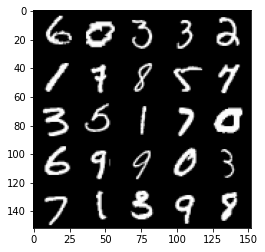

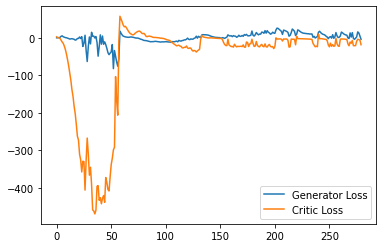

Step 5650: Generator loss: 3.67900205373764, critic loss: -7.038351298332214


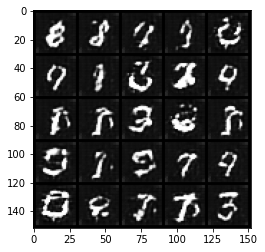

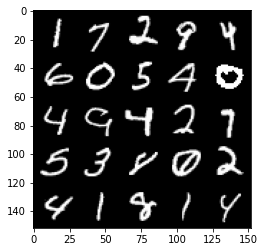

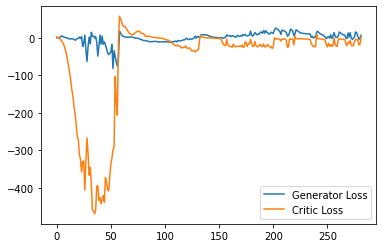

Step 5700: Generator loss: 4.816994119286537, critic loss: -9.975354480266573


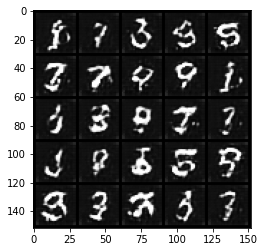

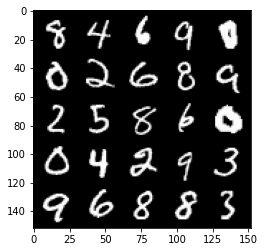

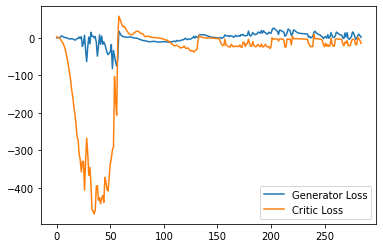

Step 5750: Generator loss: 5.010672352910042, critic loss: -2.3465230526924135


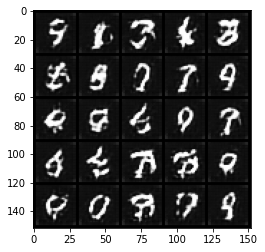

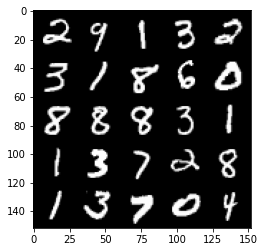

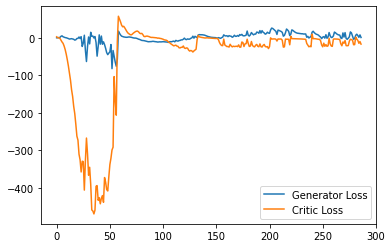

Step 5800: Generator loss: 11.332849245071412, critic loss: -3.63401265335083


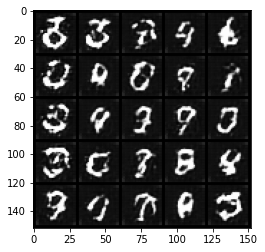

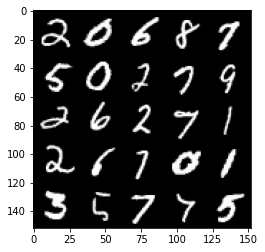

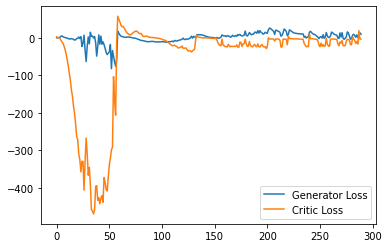

Step 5850: Generator loss: 5.7011816024780275, critic loss: -2.558242455959321


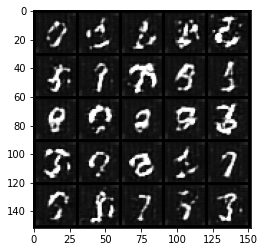

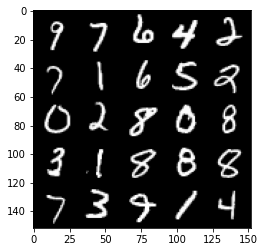

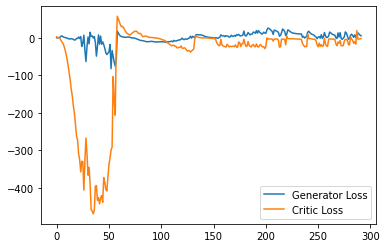

Step 5900: Generator loss: 5.436064319610596, critic loss: -3.3429064354896547


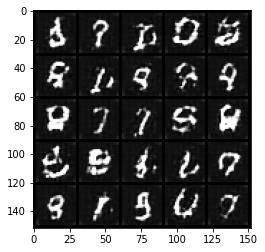

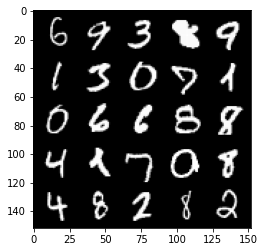

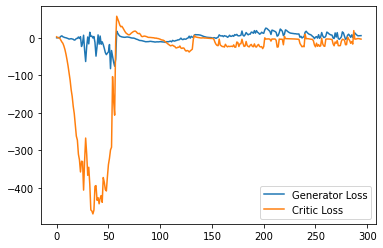

Step 5950: Generator loss: 4.00941198348999, critic loss: -4.206920046806337


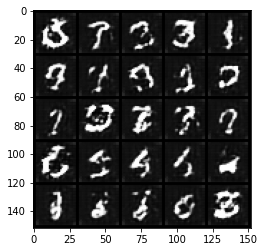

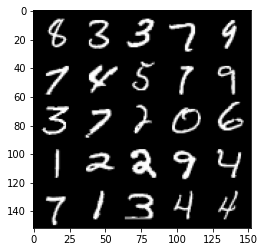

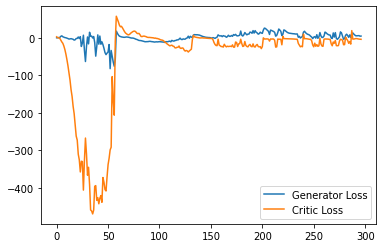

Step 6000: Generator loss: 2.1657640942931176, critic loss: -7.111401505470274


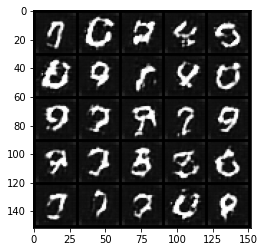

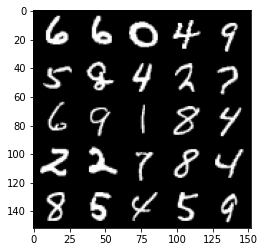

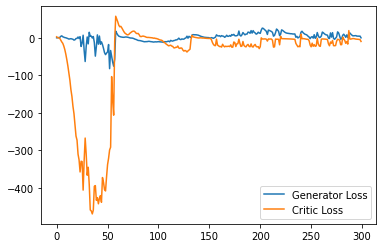

Step 6050: Generator loss: -5.73196550220251, critic loss: -18.351082695961


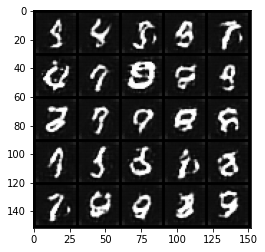

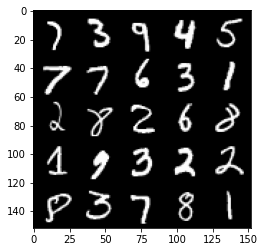

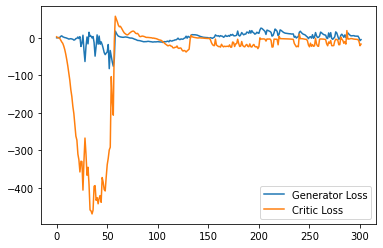

Step 6100: Generator loss: 1.3848183274269104, critic loss: -3.7498680443763686


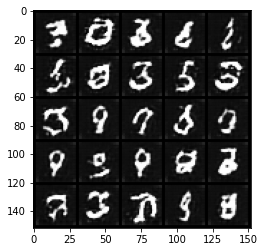

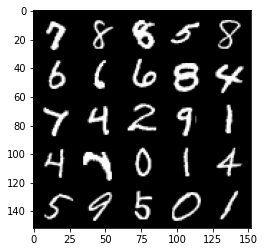

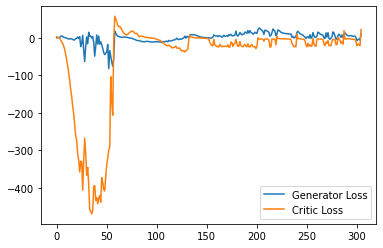

Step 6150: Generator loss: 9.089696207046508, critic loss: -2.2180298004150383


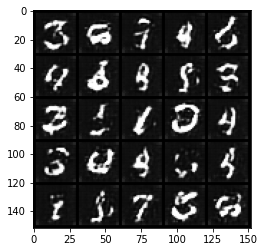

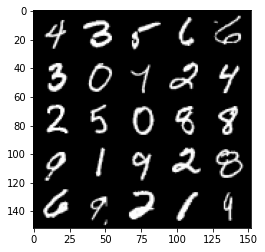

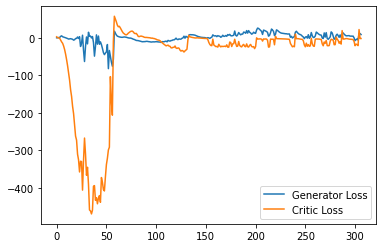

Step 6200: Generator loss: 4.867389516830444, critic loss: -2.1643862347602845


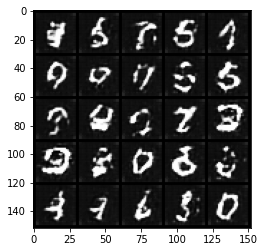

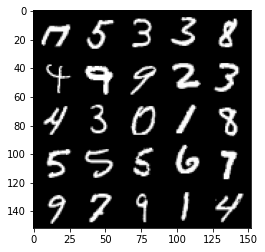

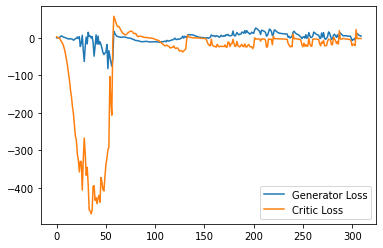

Step 6250: Generator loss: 3.458946762084961, critic loss: -2.438966549873351


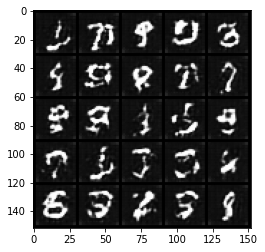

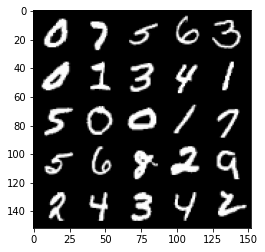

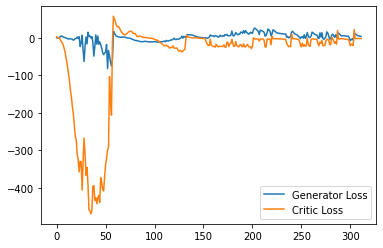

Step 6300: Generator loss: 3.3154929065704346, critic loss: -2.673733158111572


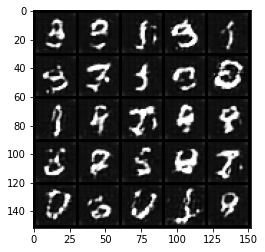

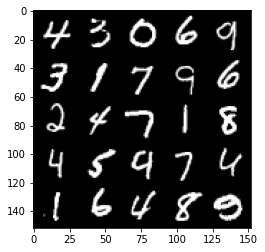

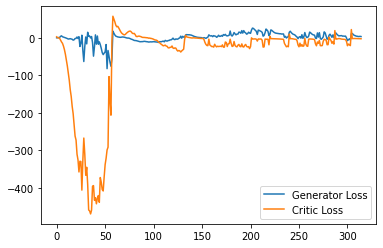

Step 6350: Generator loss: 2.536485695838928, critic loss: -2.8380259933471677


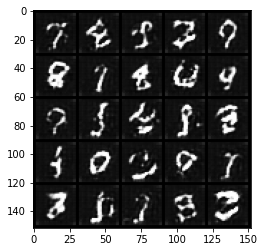

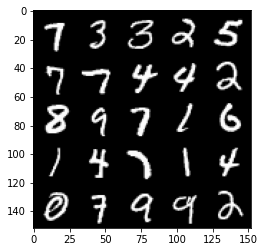

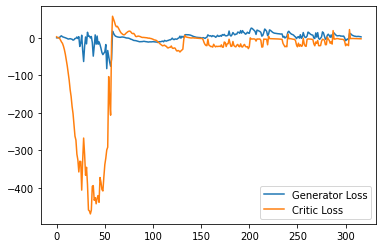

Step 6400: Generator loss: 2.3543495678901674, critic loss: -2.9681607503890985


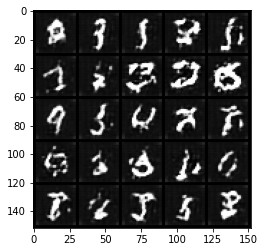

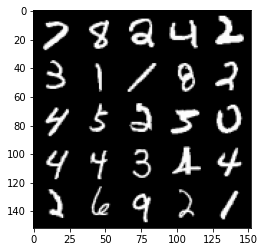

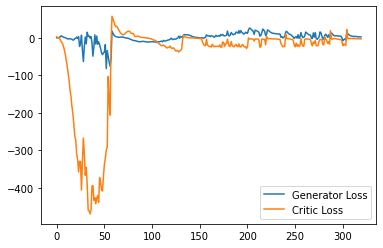

Step 6450: Generator loss: 2.118271043300629, critic loss: -3.160918794631958


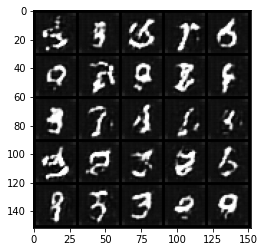

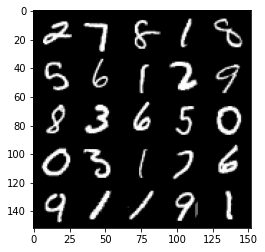

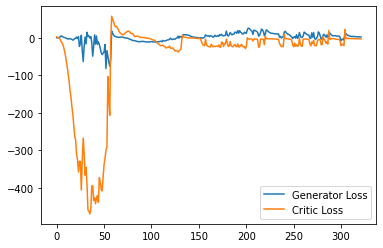

Step 6500: Generator loss: 2.080973267555237, critic loss: -3.4024686069488523


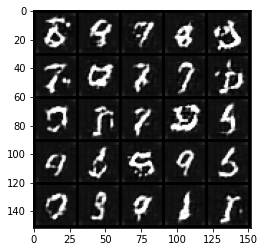

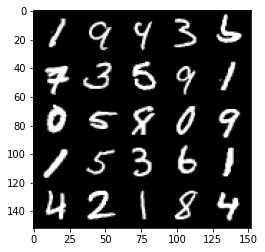

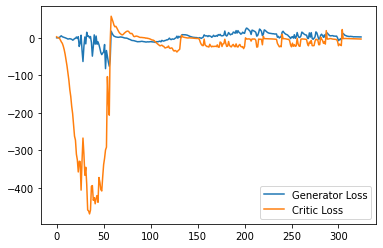

Step 6550: Generator loss: 2.0123479747772217, critic loss: -3.7336118144989014


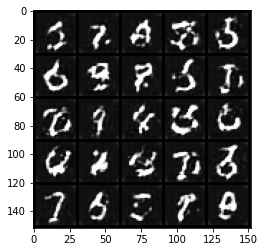

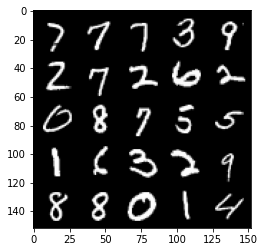

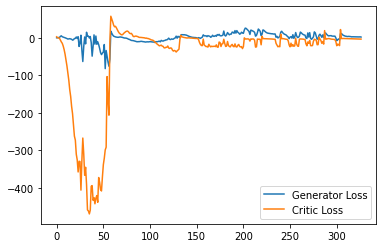

Step 6600: Generator loss: 0.7679734760522843, critic loss: -4.615329287528992


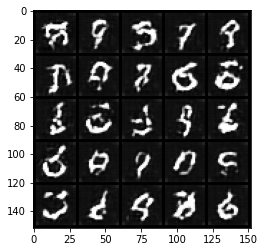

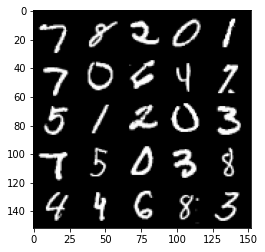

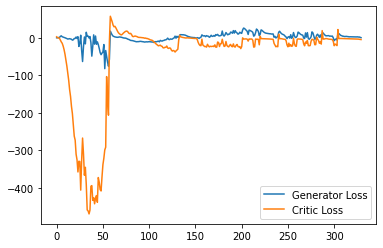

Step 6650: Generator loss: 0.7049183383584022, critic loss: -3.677720633506776


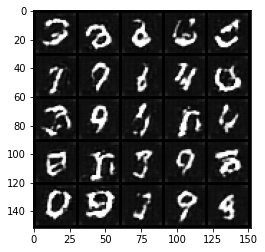

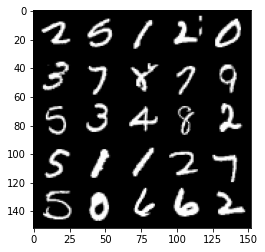

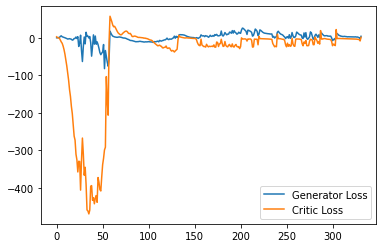

Step 6700: Generator loss: 0.9781346306949854, critic loss: -3.3590108404159547


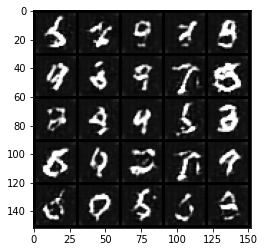

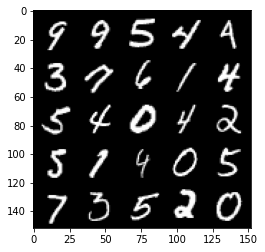

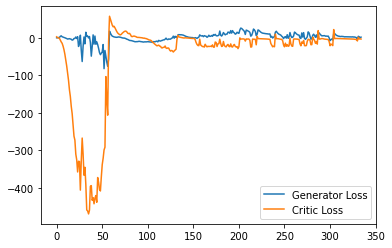

Step 6750: Generator loss: 0.15784824214875698, critic loss: -4.220854888916016


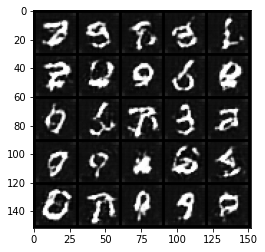

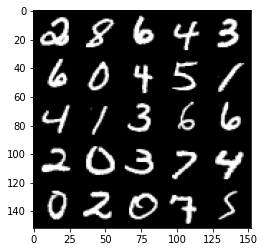

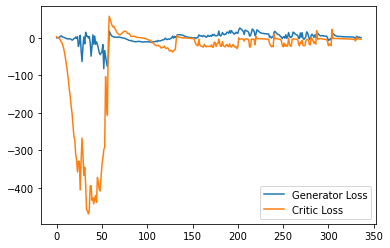

Step 6800: Generator loss: 0.5344463187456131, critic loss: -2.237404095172881


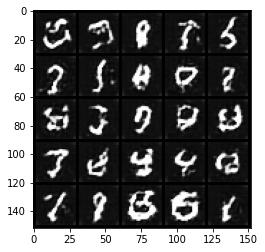

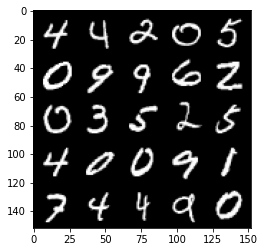

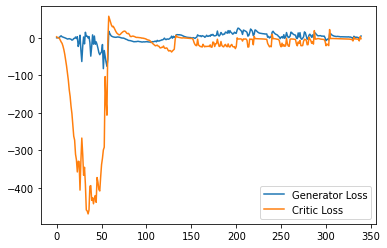

Step 6850: Generator loss: -0.11796752281486989, critic loss: -3.083108325958252


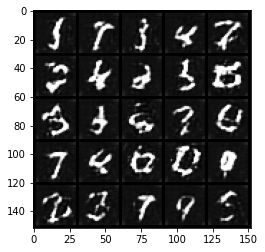

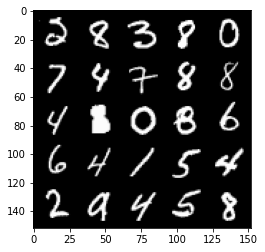

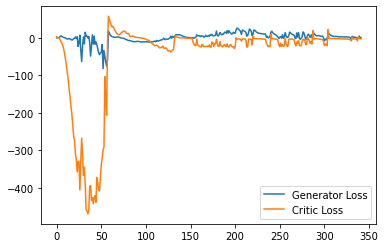

Step 6900: Generator loss: -0.21262502565979957, critic loss: -3.131872704982757


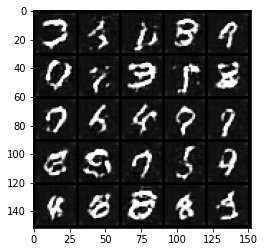

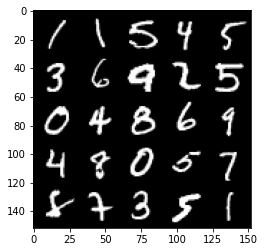

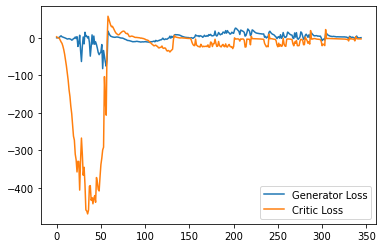

Step 6950: Generator loss: -0.6830040788277983, critic loss: -3.6581327629089344


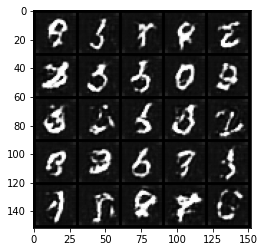

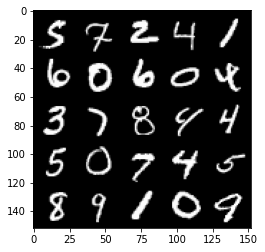

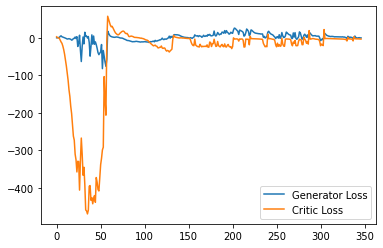

Step 7000: Generator loss: -5.6307773344218734, critic loss: -11.16115253829956


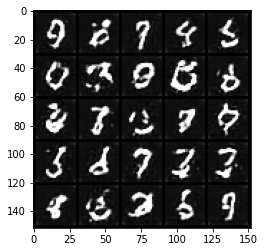

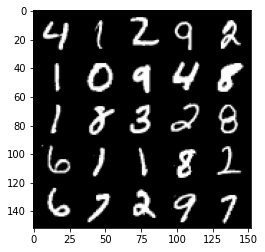

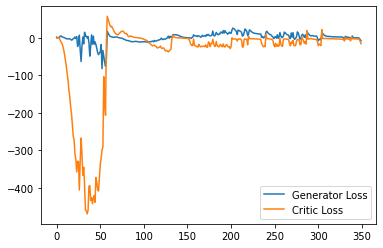

Step 7050: Generator loss: -7.473942048549652, critic loss: -15.62115710878372


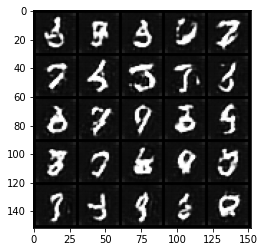

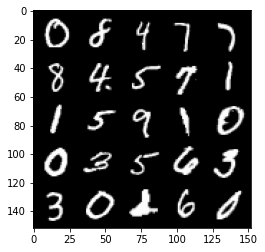

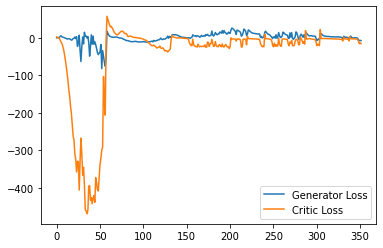

Step 7100: Generator loss: -2.8003662389516832, critic loss: -10.891629882812502


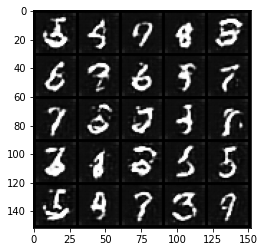

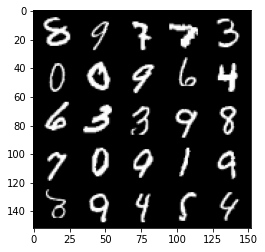

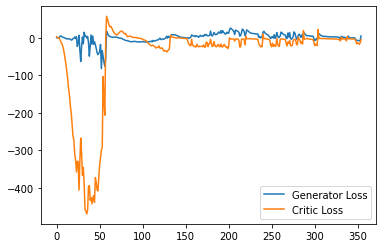

Step 7150: Generator loss: -5.84032031416893, critic loss: -17.417447188377388


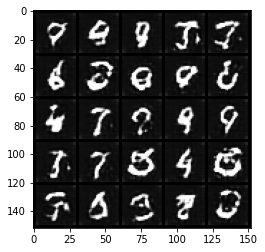

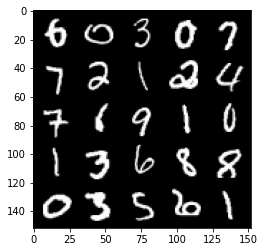

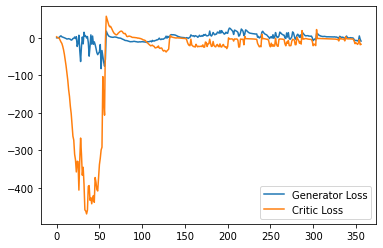

Step 7200: Generator loss: -2.8133030205965044, critic loss: -18.156213252544404


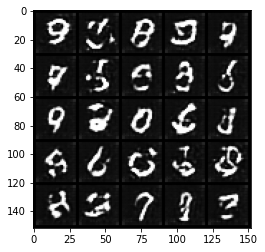

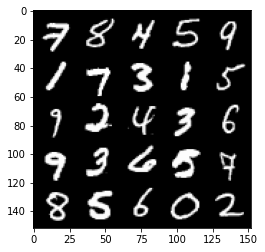

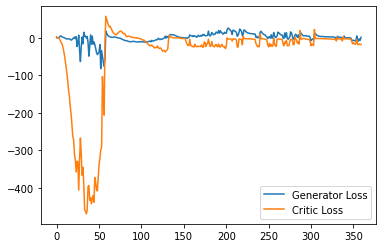

Step 7250: Generator loss: 1.4760245490074158, critic loss: -1.6799218935966493


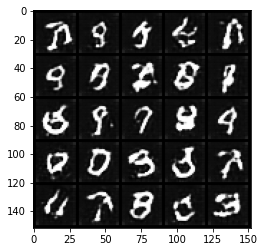

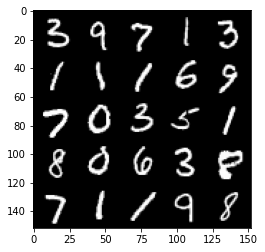

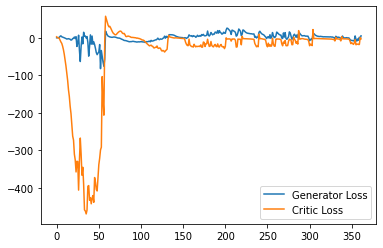

Step 7300: Generator loss: 0.30698836043477057, critic loss: -3.126716474533081


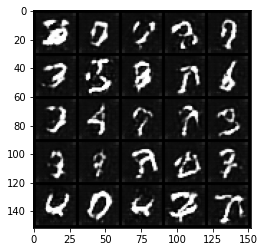

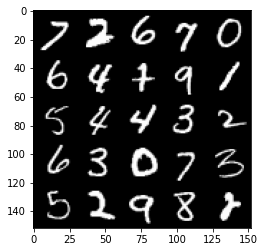

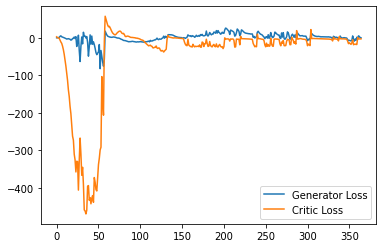

Step 7350: Generator loss: -1.0518236026167869, critic loss: -3.4886627140045166


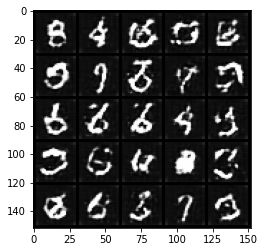

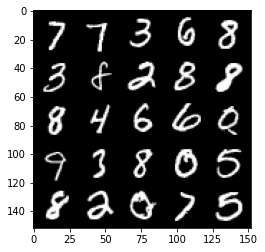

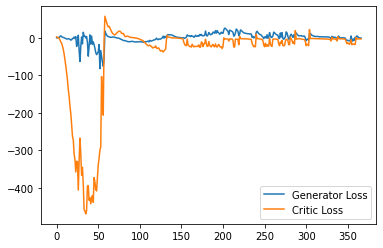

Step 7400: Generator loss: -7.548578035831452, critic loss: -14.292317170143127


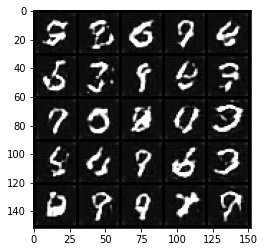

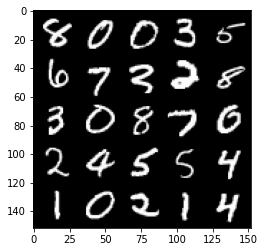

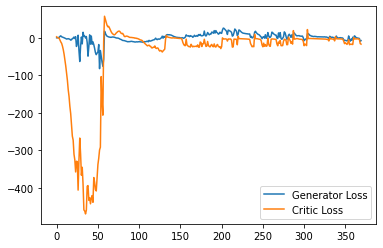

Step 7450: Generator loss: -4.0680464684963225, critic loss: -14.938243815898891


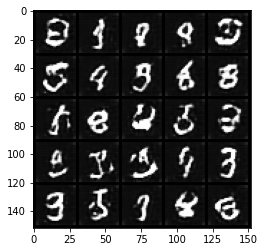

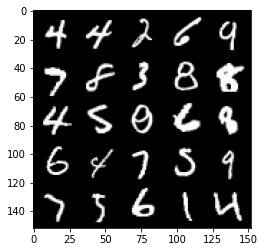

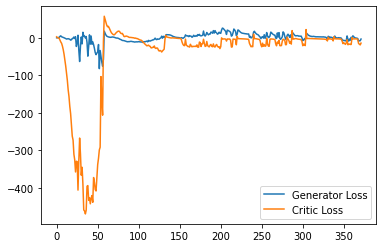

Step 7500: Generator loss: -2.9118827882409097, critic loss: -14.832083873689175


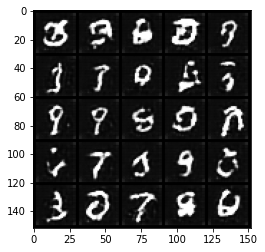

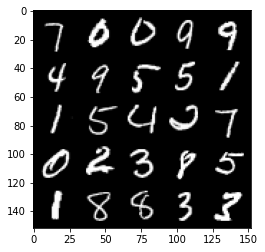

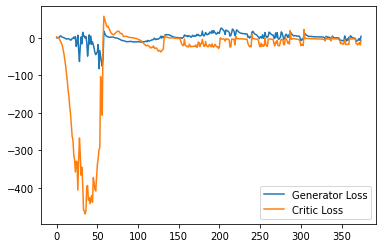

Step 7550: Generator loss: -5.459799088835716, critic loss: -17.394901510238647


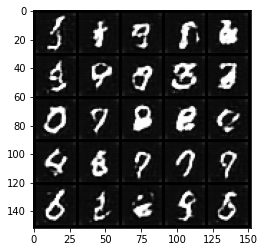

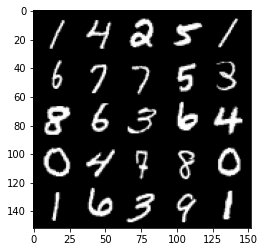

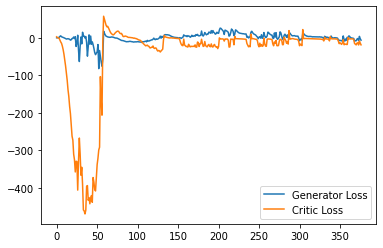

Step 7600: Generator loss: -5.975239945054054, critic loss: -18.057250078201303


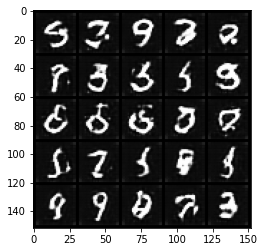

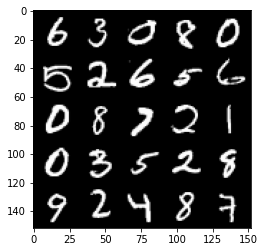

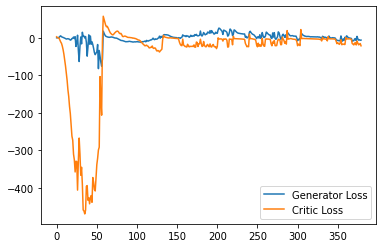

Step 7650: Generator loss: 5.052818774580955, critic loss: -1.0752417788505557


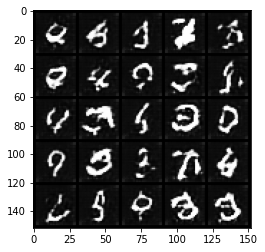

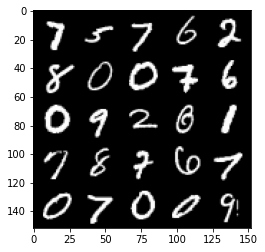

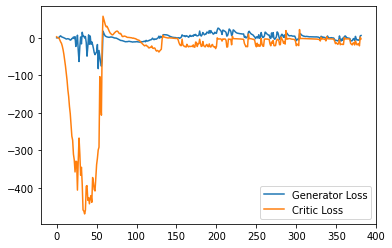

Step 7700: Generator loss: 0.609054390490055, critic loss: -3.2985234766006473


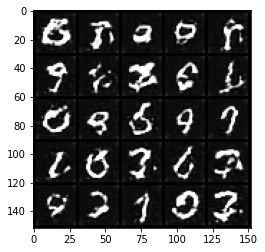

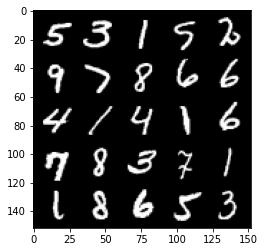

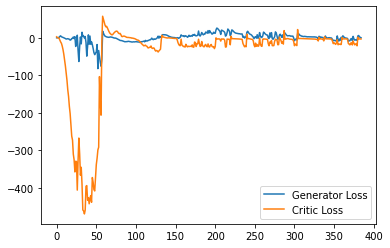

Step 7750: Generator loss: -1.2386273622512818, critic loss: -3.7851339378356927


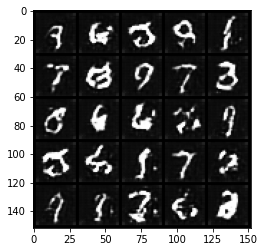

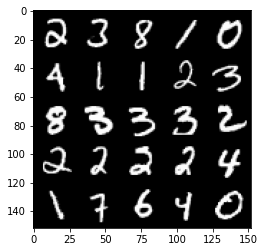

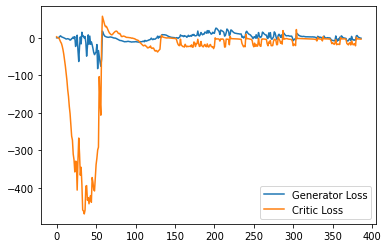

Step 7800: Generator loss: -2.351859943419695, critic loss: -4.786273359298705


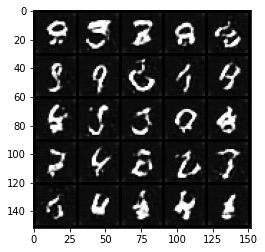

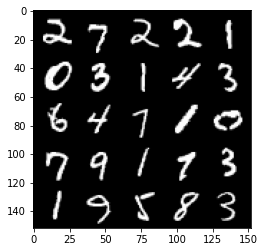

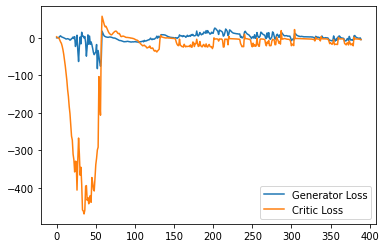

Step 7850: Generator loss: 2.718938372805715, critic loss: -3.628207419395447


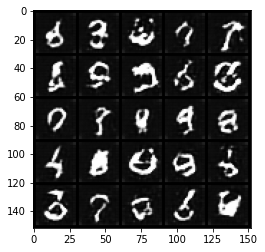

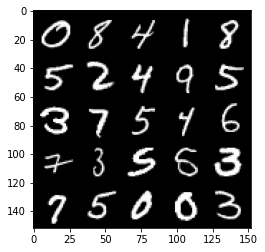

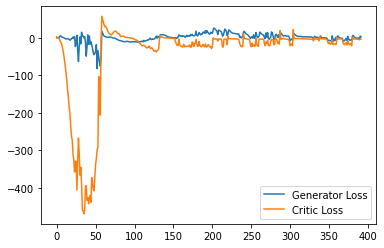

Step 7900: Generator loss: -5.720055199488997, critic loss: -12.933540094375612


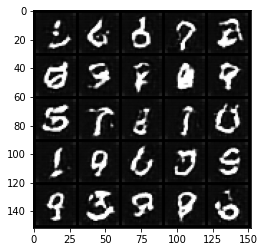

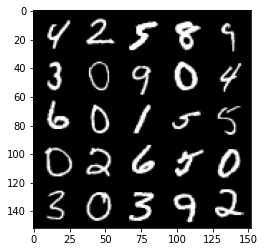

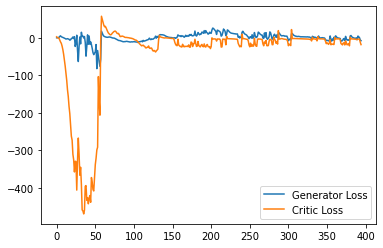

Step 7950: Generator loss: -4.681431212425232, critic loss: -16.996886010885238


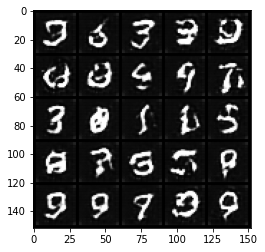

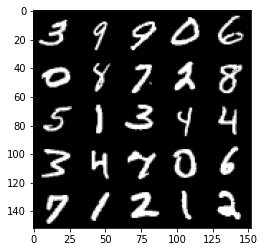

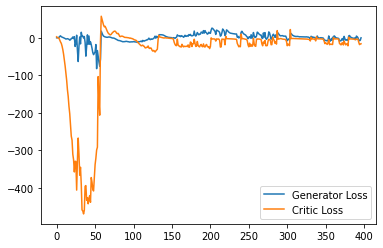

Step 8000: Generator loss: -1.5656514495611191, critic loss: -15.884190415859221


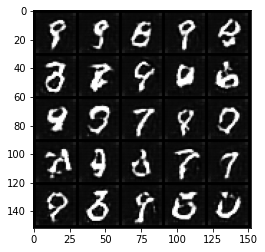

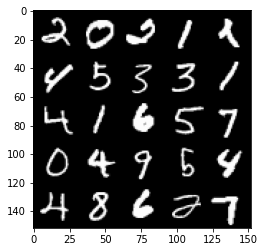

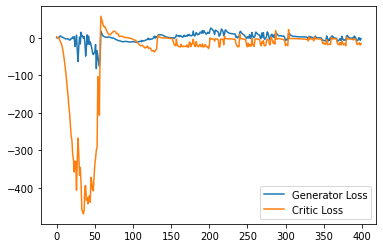

Step 8050: Generator loss: 0.7553521156311035, critic loss: -8.15355472230911


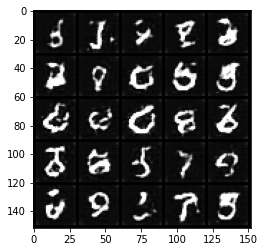

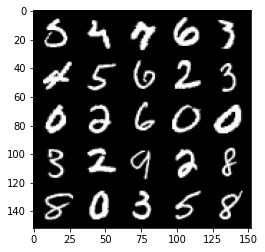

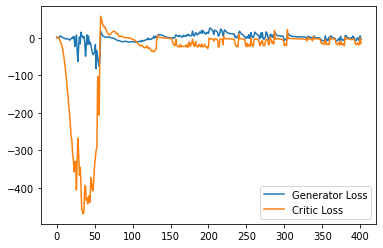

Step 8100: Generator loss: -1.3515120260417461, critic loss: -8.74020486974716


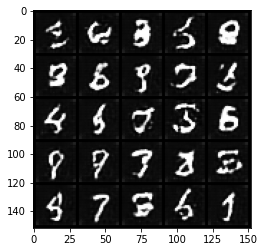

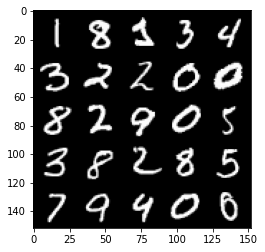

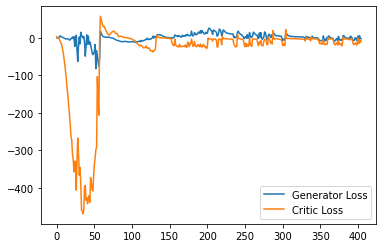

Step 8150: Generator loss: 4.43866346359253, critic loss: -3.0118155069351196


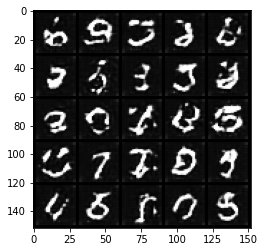

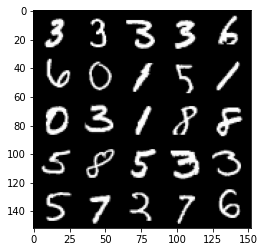

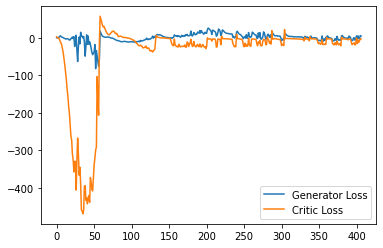

Step 8200: Generator loss: 0.9704635120928288, critic loss: -3.3564852371215816


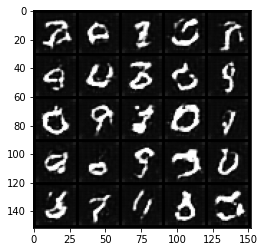

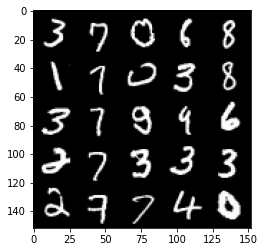

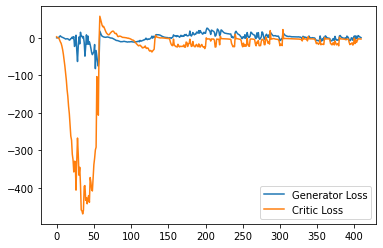

Step 8250: Generator loss: -6.159389725327491, critic loss: -14.705634116649628


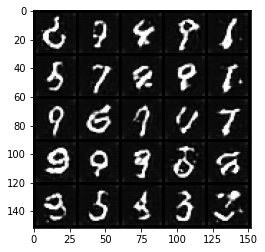

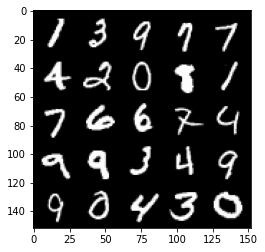

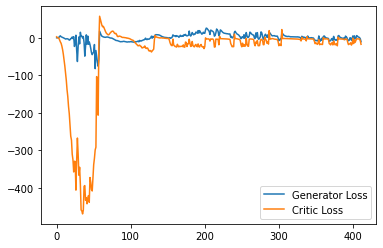

Step 8300: Generator loss: -0.7185756921768188, critic loss: -10.891687927246094


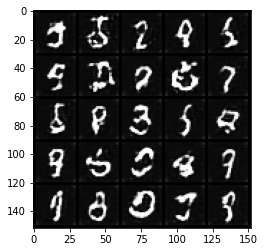

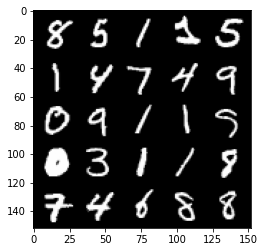

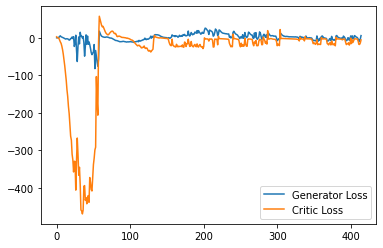

Step 8350: Generator loss: -4.885090836584568, critic loss: -17.5614742603302


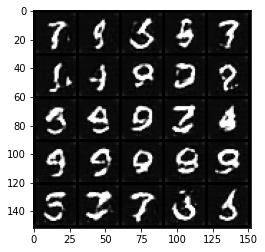

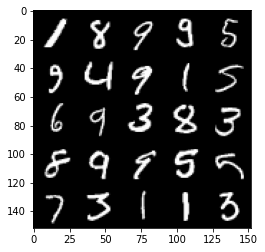

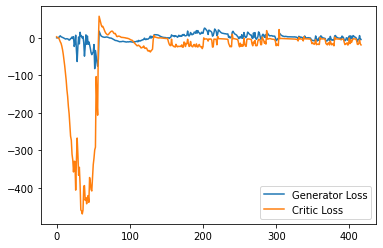

Step 8400: Generator loss: 0.8521924757957459, critic loss: -11.44358486843109


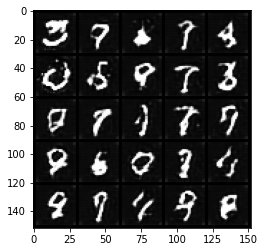

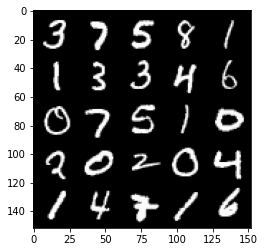

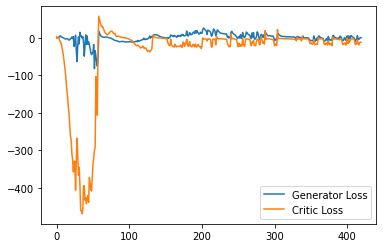

Step 8450: Generator loss: -0.880283944606781, critic loss: -15.285855884790422


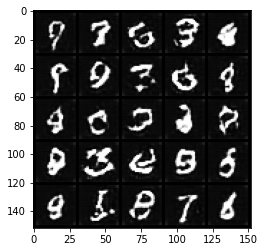

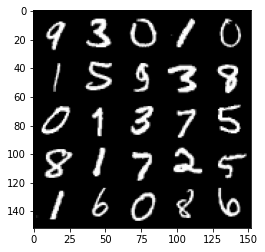

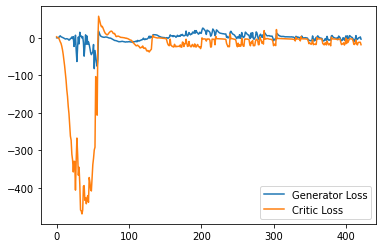

Step 8500: Generator loss: 3.8512970066070555, critic loss: -4.1169653310775765


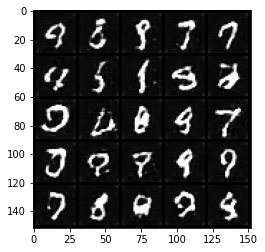

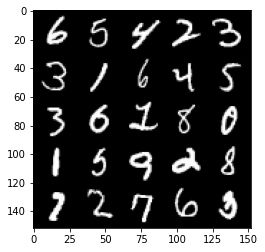

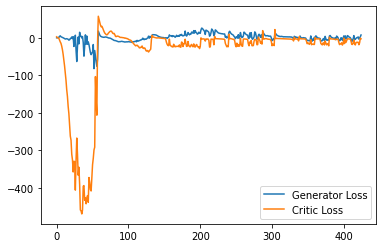

Step 8550: Generator loss: 2.5442042103409768, critic loss: -3.4070165061950686


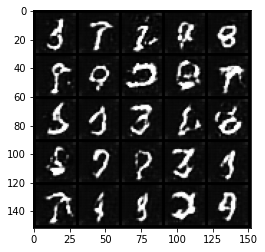

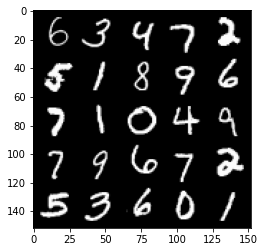

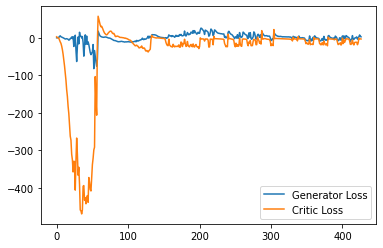

Step 8600: Generator loss: -1.3163760349154472, critic loss: -9.103032914161684


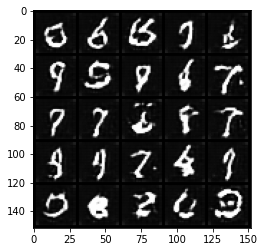

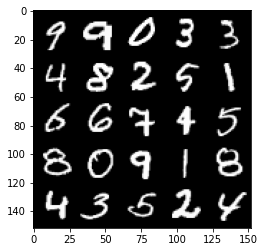

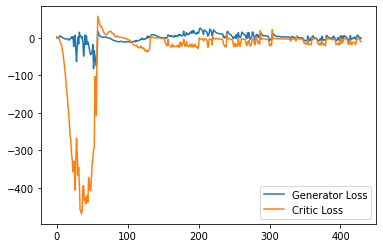

Step 8650: Generator loss: -1.9044859254360198, critic loss: -7.635808485507966


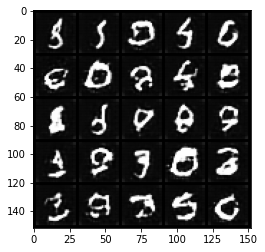

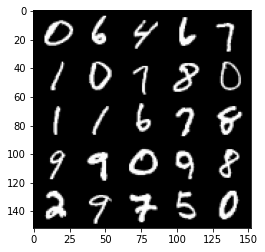

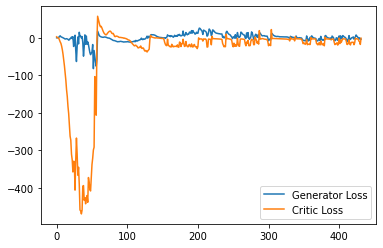

Step 8700: Generator loss: 0.17857565522193908, critic loss: -8.333028623580935


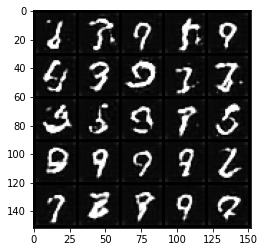

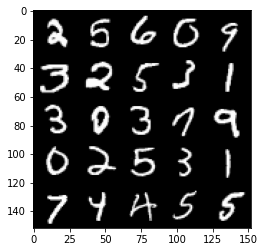

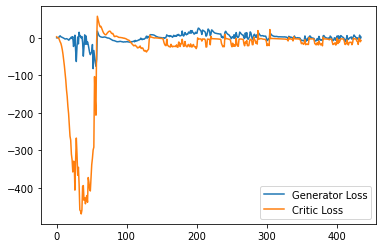

Step 8750: Generator loss: -0.8926166778802872, critic loss: -13.126026104927064


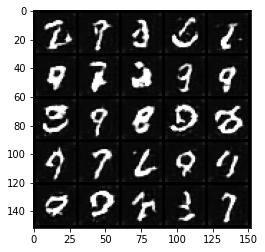

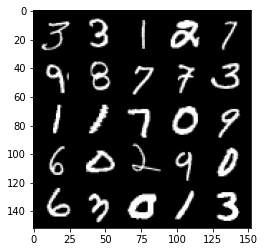

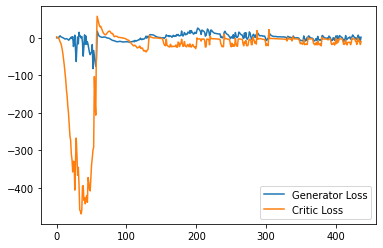

Step 8800: Generator loss: -0.4646162064373493, critic loss: -12.18127710008621


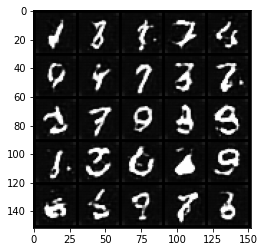

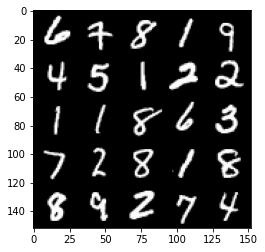

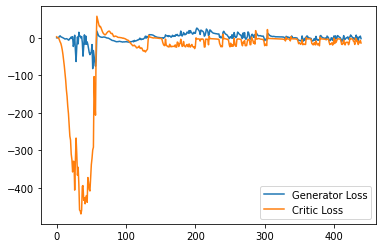

Step 8850: Generator loss: 4.102262538075447, critic loss: -12.343507911682128


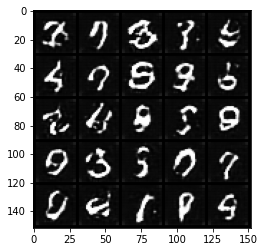

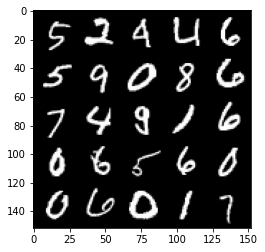

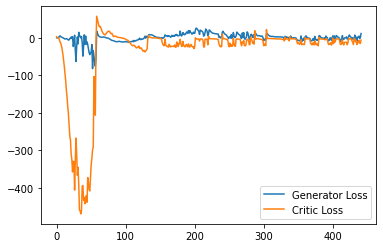

Step 8900: Generator loss: 2.746701081097126, critic loss: -10.55961066055298


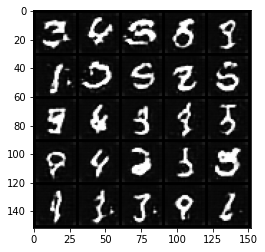

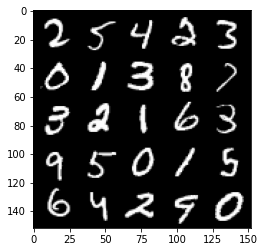

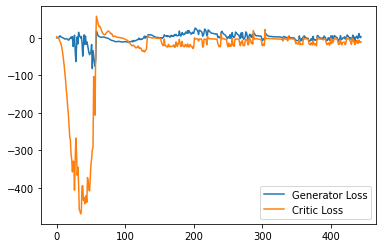

Step 8950: Generator loss: -2.8759156036376954, critic loss: -16.753629326343535


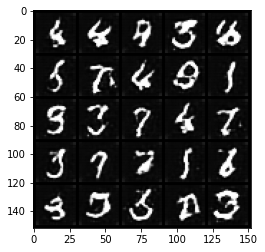

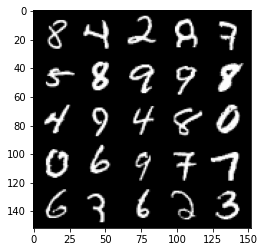

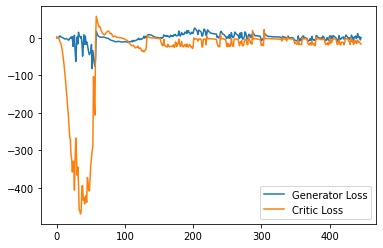

Step 9000: Generator loss: 2.2009472830593584, critic loss: -13.017667272329332


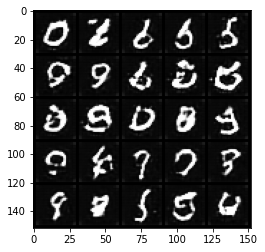

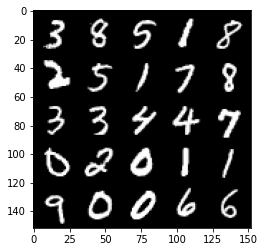

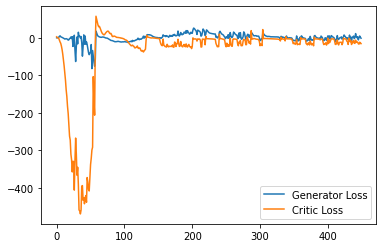

Step 9050: Generator loss: 3.402652306854725, critic loss: -15.356009277105327


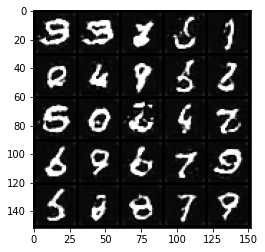

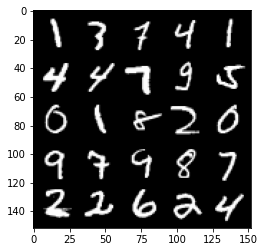

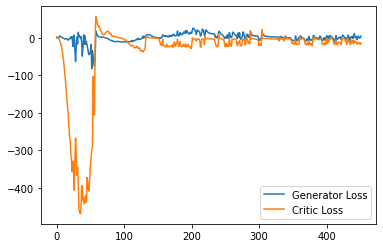

Step 9100: Generator loss: 3.9499323558807373, critic loss: -12.704468260049818


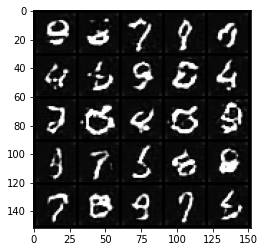

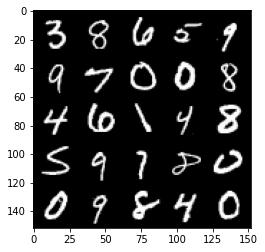

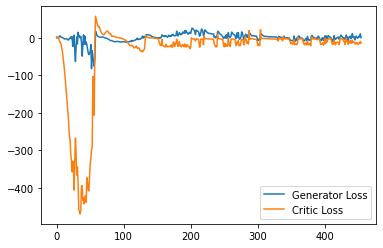

Step 9150: Generator loss: 7.432050639390946, critic loss: -13.364726995706555


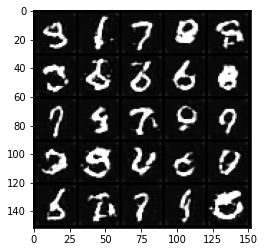

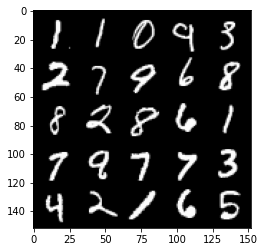

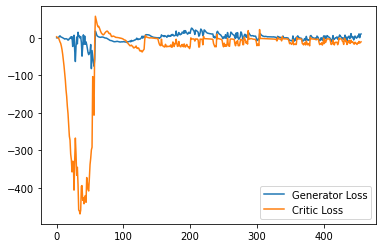

Step 9200: Generator loss: 5.29162212073803, critic loss: -6.807584640026094


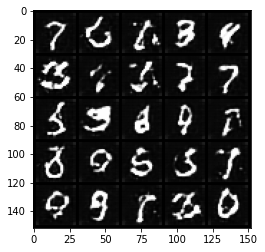

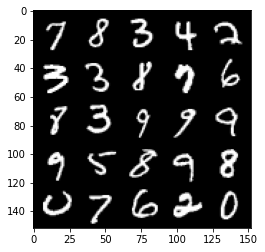

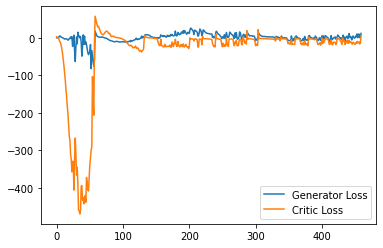

Step 9250: Generator loss: 5.3646135053038595, critic loss: -10.183427683353422


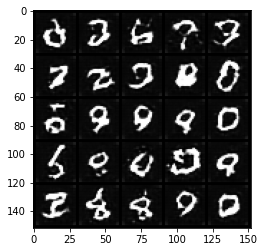

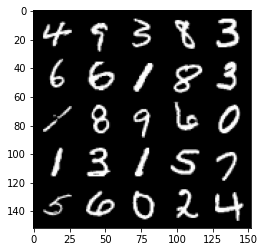

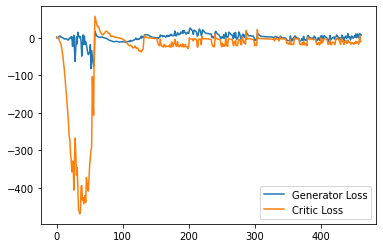

Step 9300: Generator loss: -0.011293039321899415, critic loss: -16.627141036033628


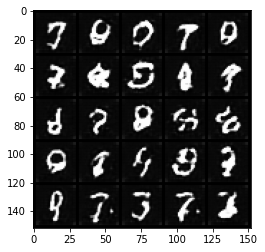

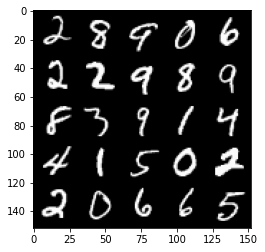

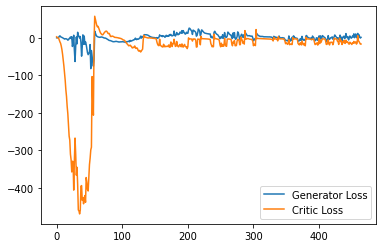

Step 9350: Generator loss: 6.721135683059693, critic loss: -10.242061045646667


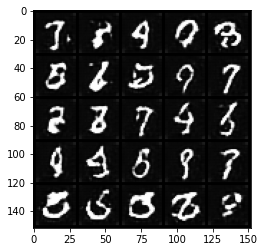

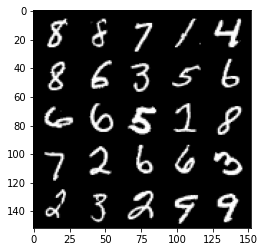

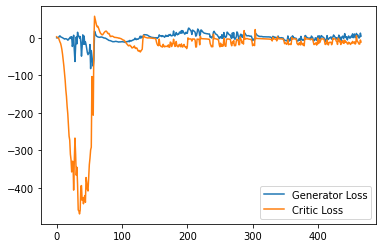

Step 9400: Generator loss: 6.058468902111054, critic loss: -11.89927741265297


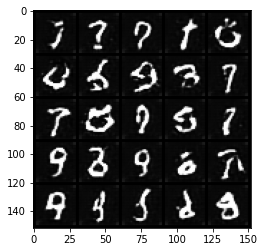

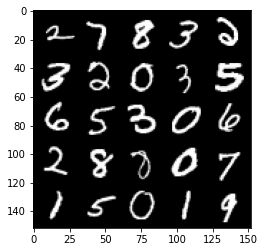

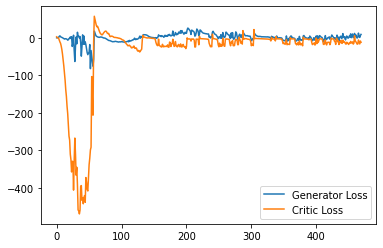

Step 9450: Generator loss: 11.45040661484003, critic loss: -11.35295246744156


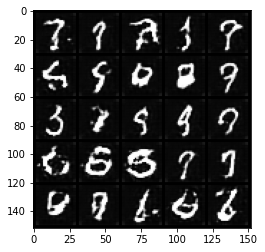

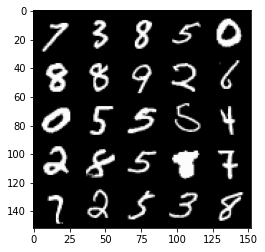

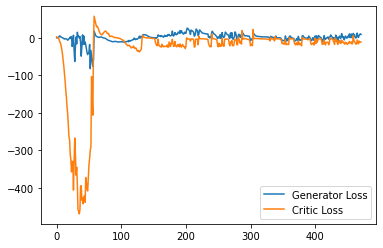

Step 9500: Generator loss: 6.390638361573219, critic loss: -12.655415975928301


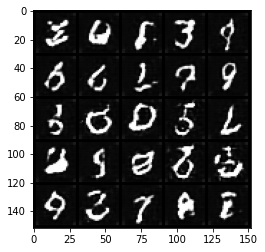

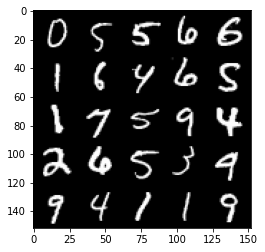

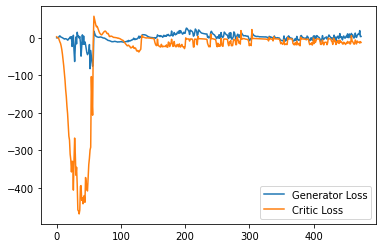

Step 9550: Generator loss: 7.947297746241093, critic loss: -12.321776236534117


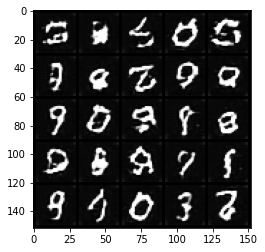

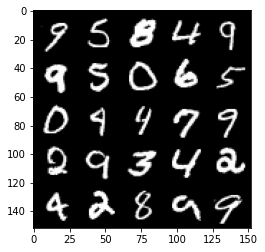

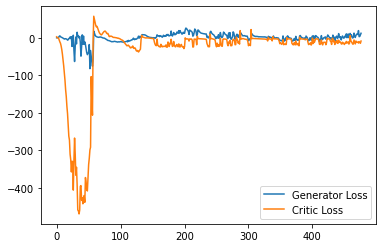

Step 9600: Generator loss: 7.39494961977005, critic loss: -14.228665220975877


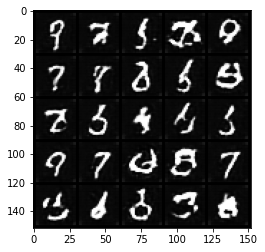

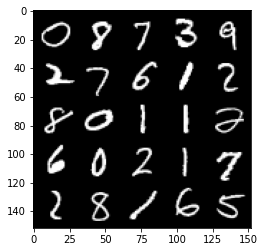

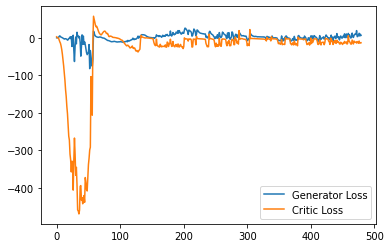

Step 9650: Generator loss: 8.552083878219127, critic loss: -2.156419158220291


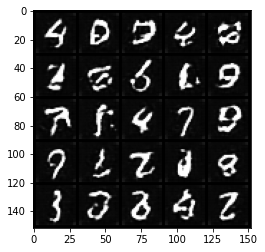

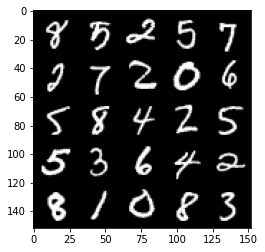

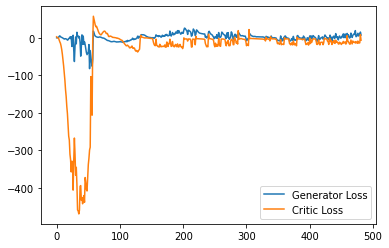

Step 9700: Generator loss: 4.222057352662087, critic loss: -13.264319513082503


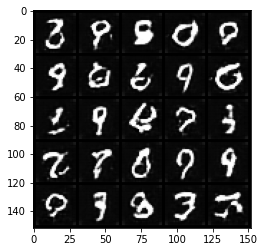

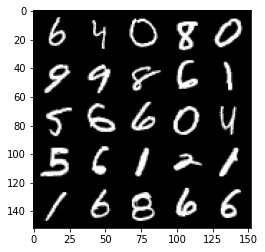

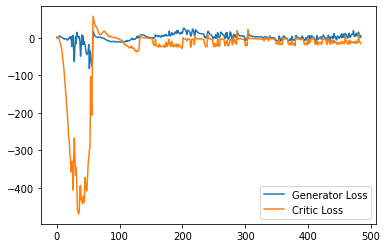

Step 9750: Generator loss: 6.936087906658649, critic loss: -14.096714587688446


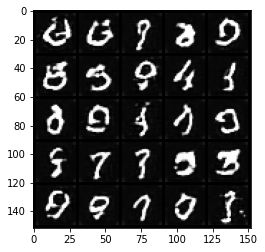

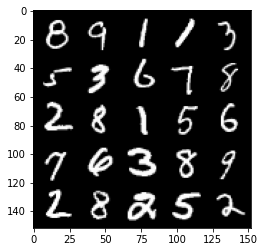

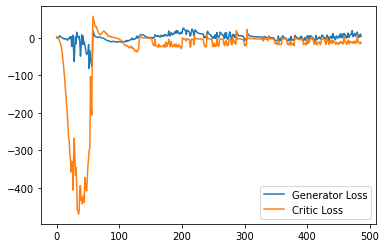

Step 9800: Generator loss: 9.407753656208515, critic loss: -12.844497433423992


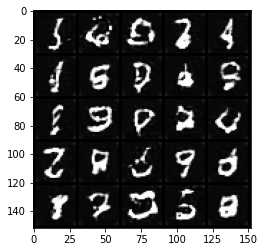

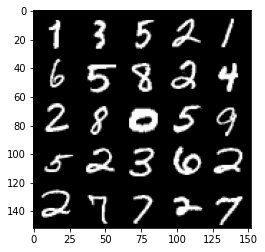

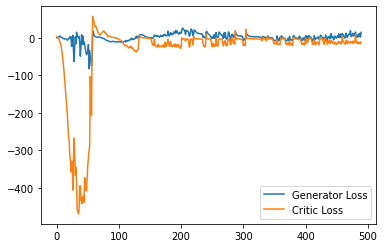

Step 9850: Generator loss: 7.770135859251022, critic loss: -12.789784285545345


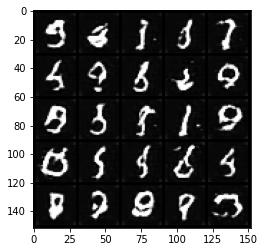

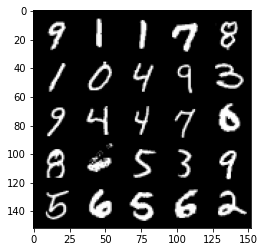

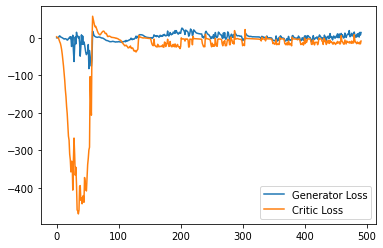

Step 9900: Generator loss: 8.794010691344738, critic loss: -12.468026797294614


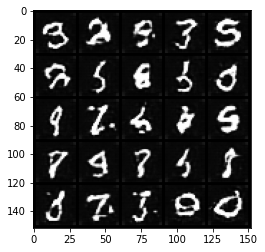

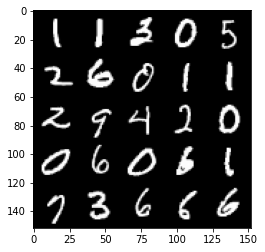

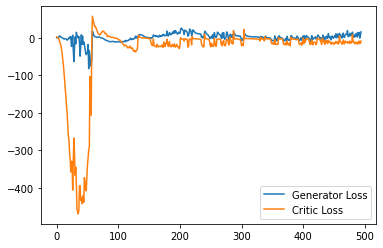

Step 9950: Generator loss: 8.766729688346386, critic loss: -13.13462220668793


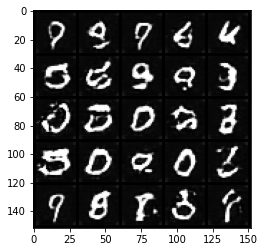

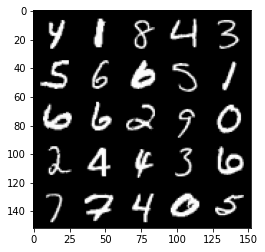

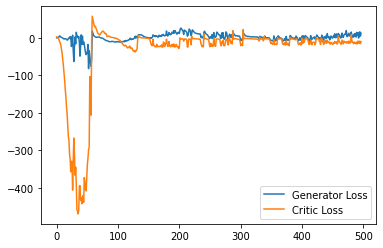

Step 10000: Generator loss: 9.432688580155373, critic loss: -14.47528756356239


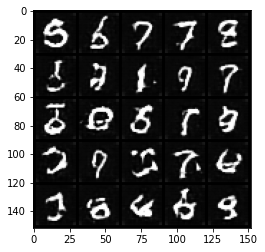

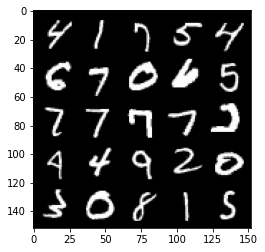

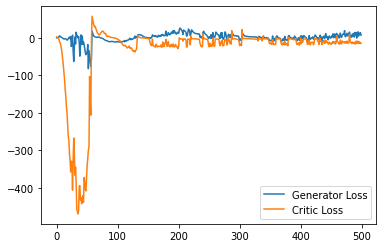

Step 10050: Generator loss: 10.557630751729011, critic loss: -13.915092082023618


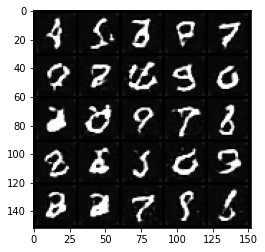

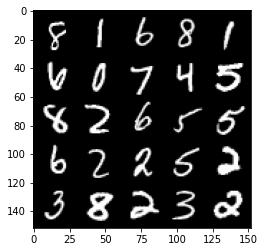

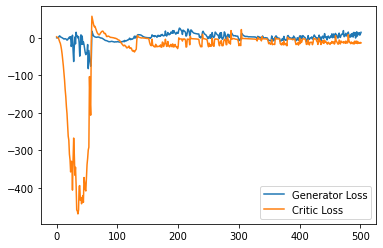

Step 10100: Generator loss: 11.35159952506423, critic loss: -7.155712553262711


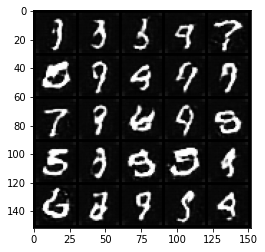

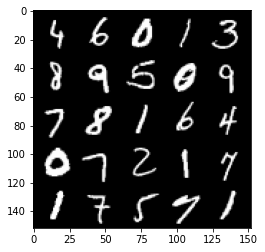

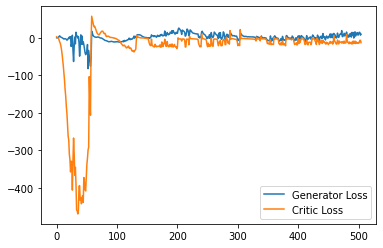

Step 10150: Generator loss: 6.588618279099465, critic loss: -14.562949004173278


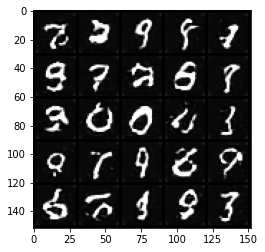

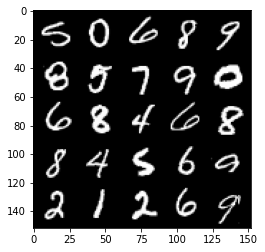

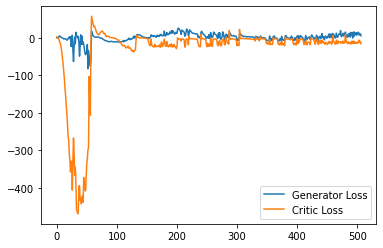

Step 10200: Generator loss: 13.172282364368439, critic loss: -10.78772284603119


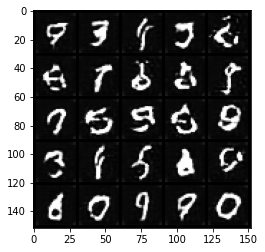

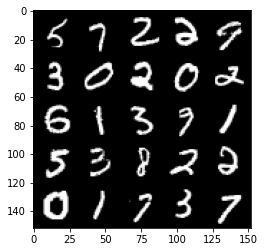

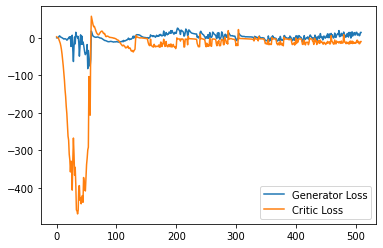

Step 10250: Generator loss: 7.810382900238037, critic loss: -15.456735478639597


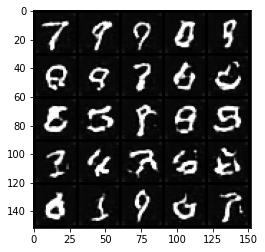

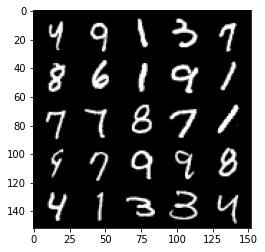

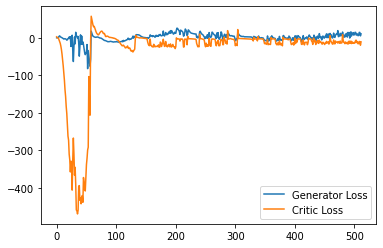

Step 10300: Generator loss: 15.468319630622863, critic loss: -12.55206913995743


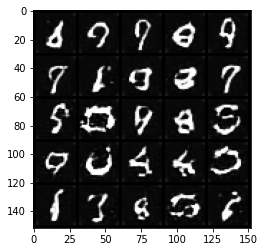

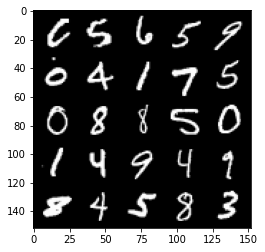

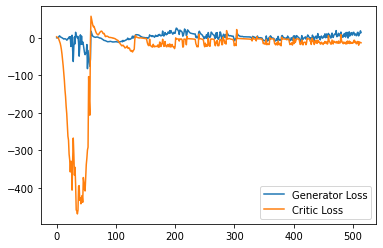

Step 10350: Generator loss: 7.439239224791526, critic loss: -10.283407242894171


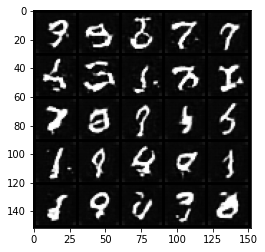

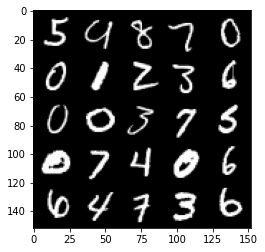

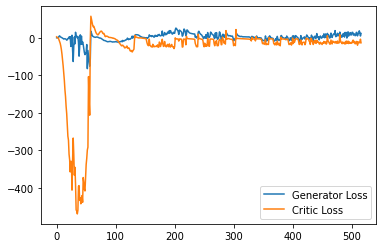

Step 10400: Generator loss: 8.347163974344731, critic loss: -14.88339598155022


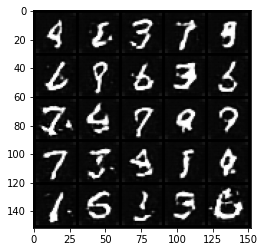

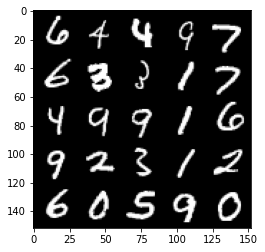

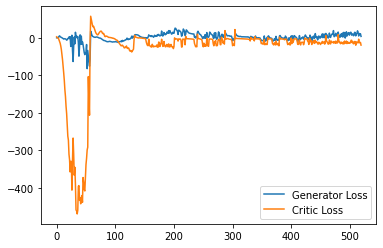

Step 10450: Generator loss: 14.500144542455674, critic loss: -4.182819222927093


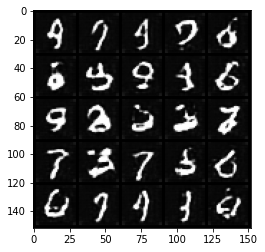

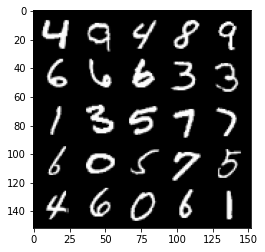

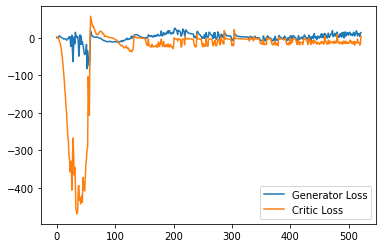

Step 10500: Generator loss: 14.862759189605713, critic loss: -4.745121984958649


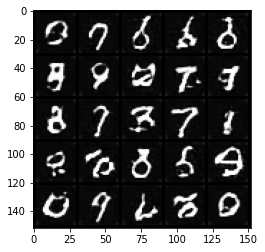

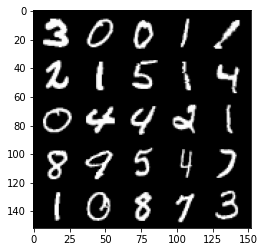

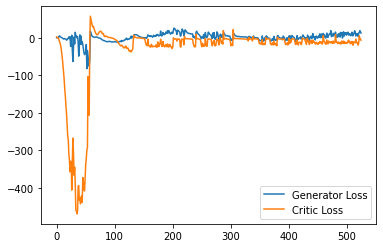

Step 10550: Generator loss: 8.808647240400314, critic loss: -15.723066475868228


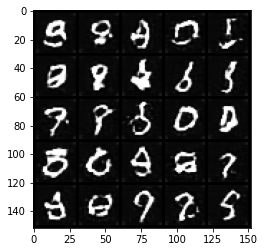

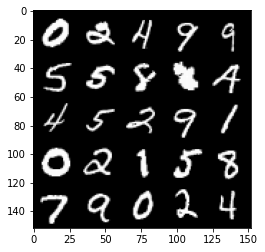

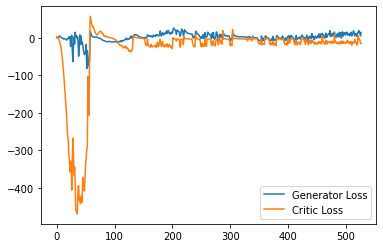

Step 10600: Generator loss: 9.754851614236832, critic loss: -15.877159944057462


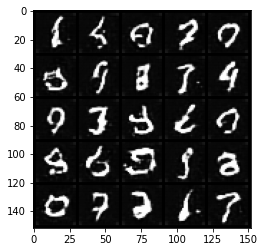

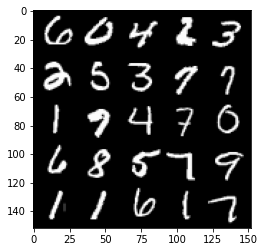

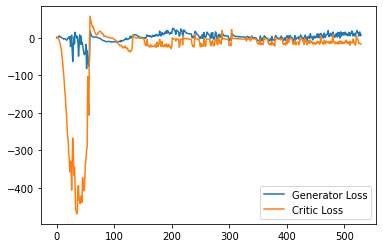

Step 10650: Generator loss: 15.82313009262085, critic loss: -13.211561719179153


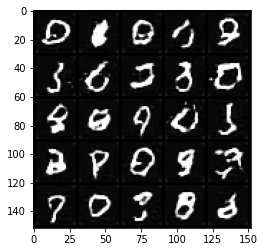

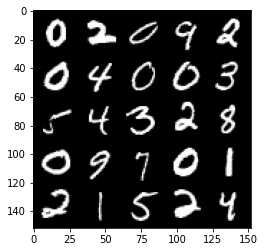

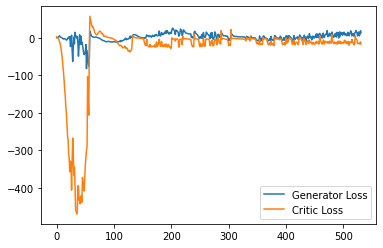

Step 10700: Generator loss: 7.521962200403213, critic loss: -17.583017488479616


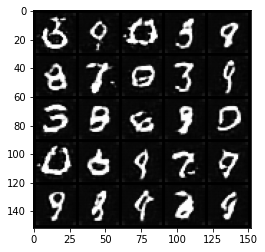

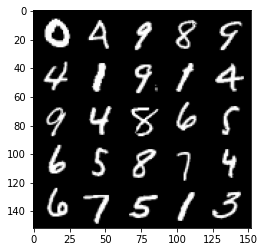

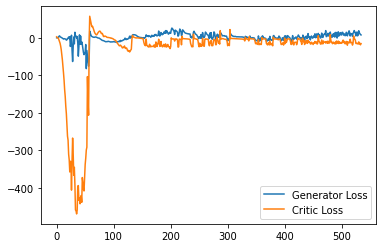

Step 10750: Generator loss: 17.824274294376373, critic loss: -14.484774684906004


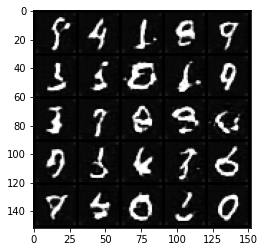

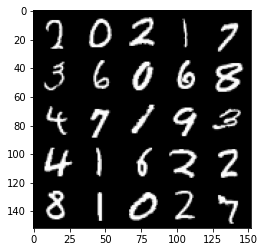

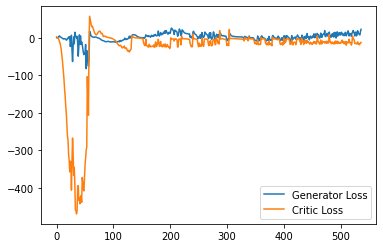

Step 10800: Generator loss: 14.653235325813293, critic loss: -7.267518722891809


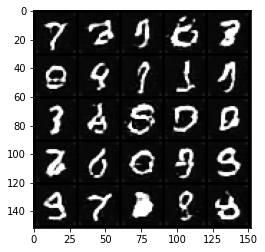

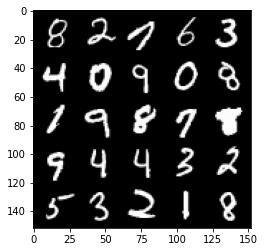

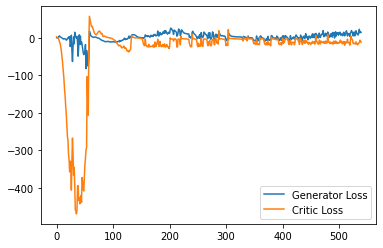

Step 10850: Generator loss: 12.50439480662346, critic loss: -11.865796798229217


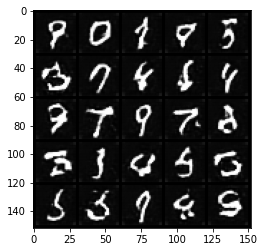

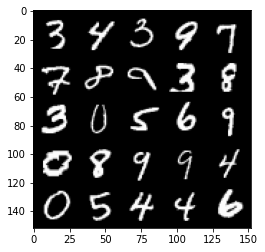

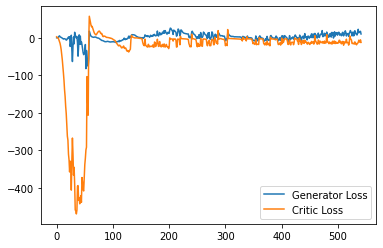

Step 10900: Generator loss: 19.18474054634571, critic loss: -12.605103447914123


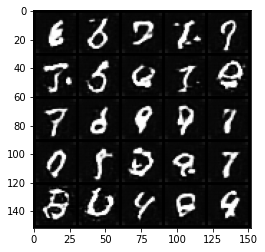

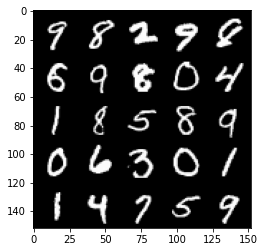

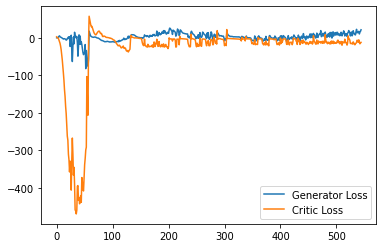

Step 10950: Generator loss: 19.131960101127625, critic loss: -9.914380627393724


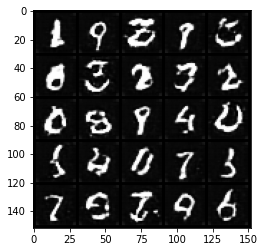

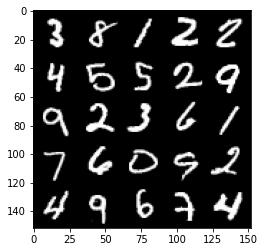

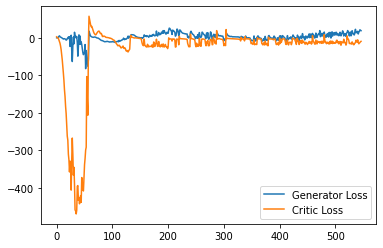

Step 11000: Generator loss: 13.002983468770982, critic loss: -12.57371389389038


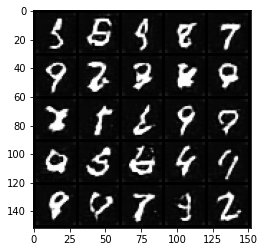

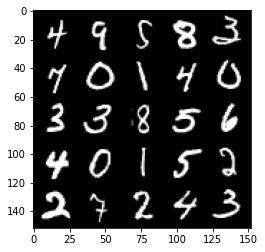

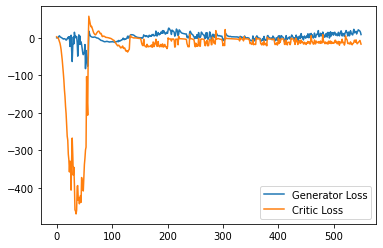

Step 11050: Generator loss: 19.974644708633424, critic loss: -12.747704466819764


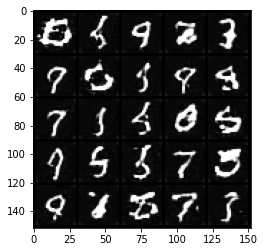

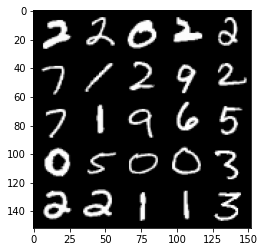

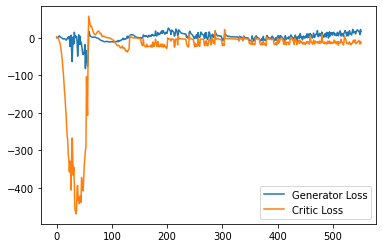

Step 11100: Generator loss: 16.700155205726624, critic loss: -7.441770089745521


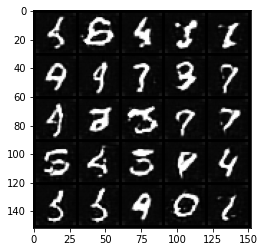

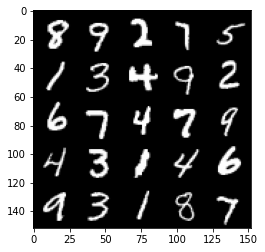

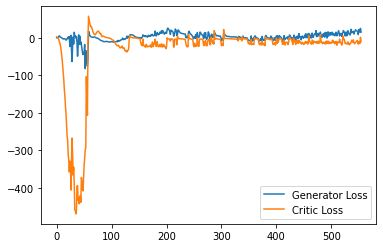

Step 11150: Generator loss: 14.821287683844567, critic loss: -12.104254418849946


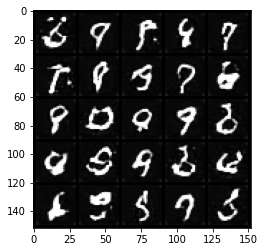

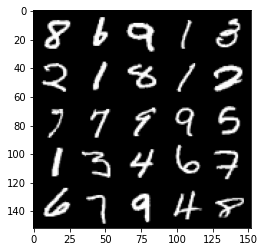

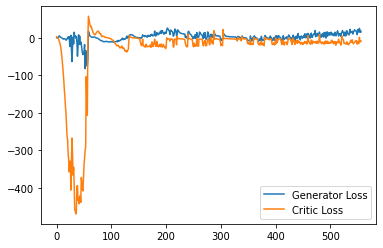

Step 11200: Generator loss: 19.96871767282486, critic loss: -12.733424780368813


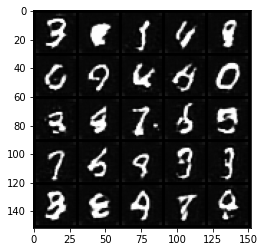

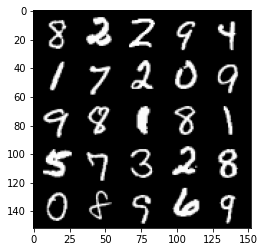

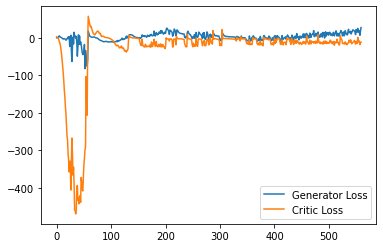

Step 11250: Generator loss: 16.811395139694213, critic loss: -9.393019084453583


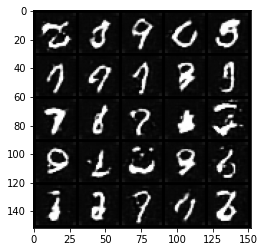

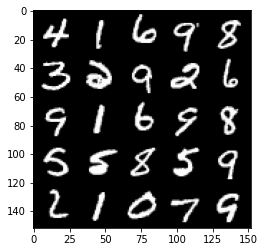

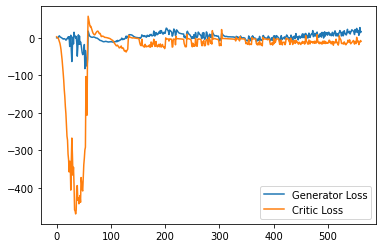

Step 11300: Generator loss: 16.65273790180683, critic loss: -12.07390967941284


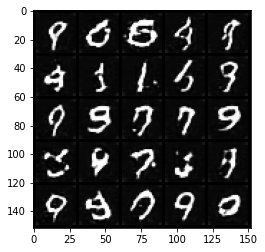

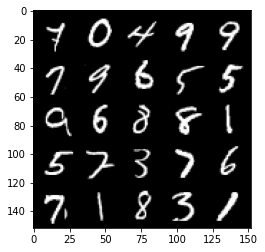

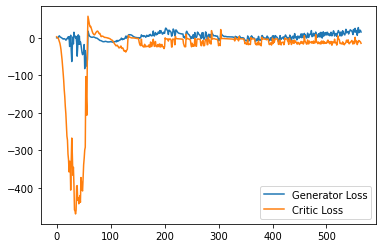

Step 11350: Generator loss: 14.297167966365814, critic loss: -14.66463406038284


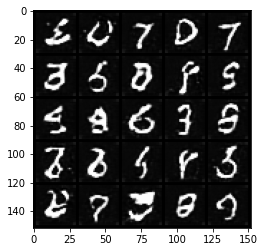

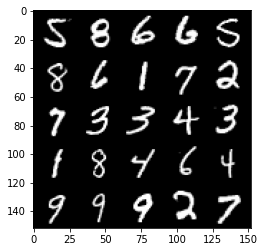

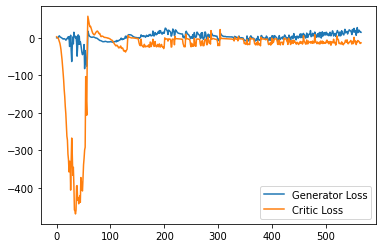

Step 11400: Generator loss: 19.332072072029113, critic loss: -15.756783979892734


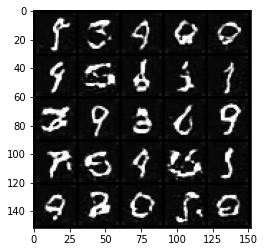

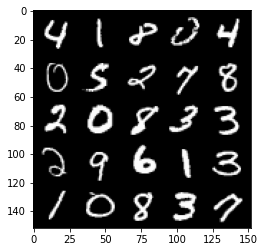

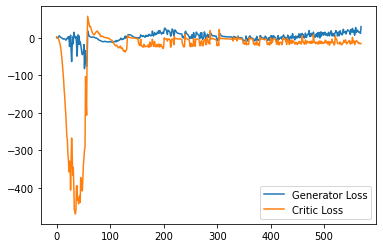

Step 11450: Generator loss: 12.738702149391175, critic loss: -9.144123590946194


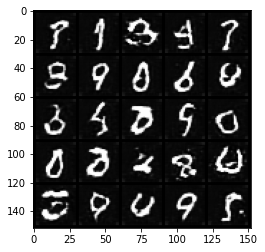

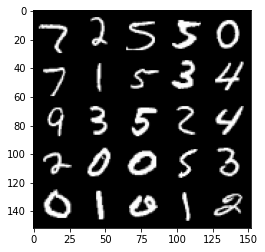

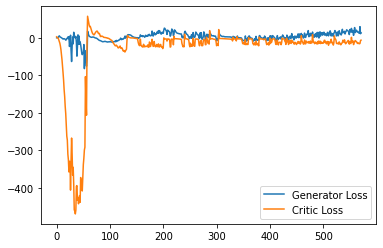

Step 11500: Generator loss: 14.775829627513886, critic loss: -14.106351375103001


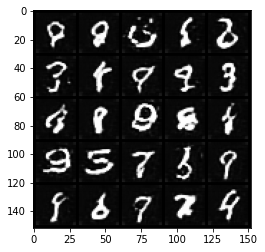

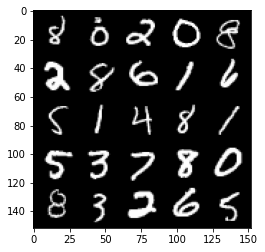

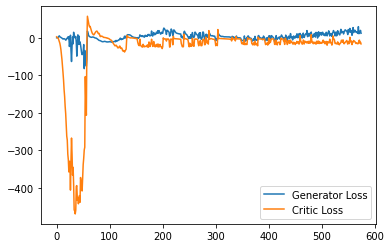

Step 11550: Generator loss: 19.6159833240509, critic loss: -14.887033643364905


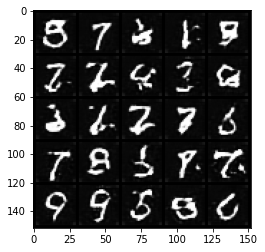

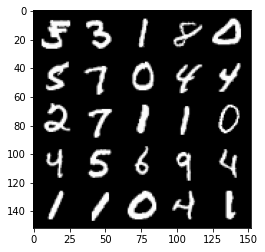

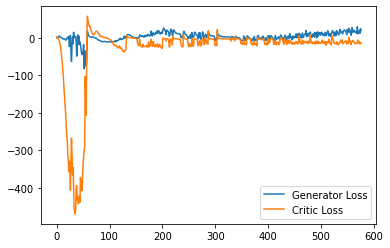

Step 11600: Generator loss: 18.25346503138542, critic loss: -13.78041331458092


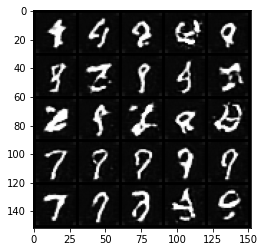

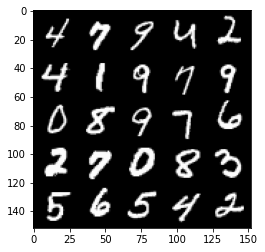

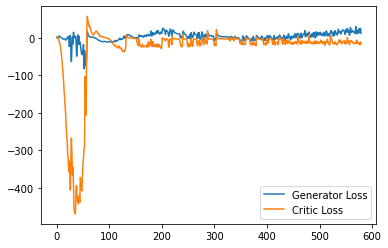

Step 11650: Generator loss: 11.628263368606568, critic loss: -18.88104174208641


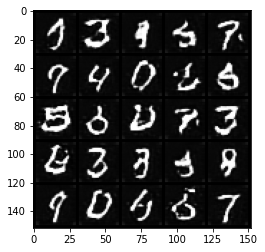

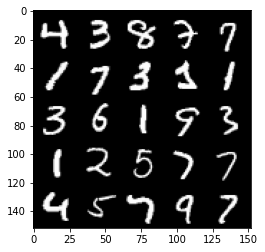

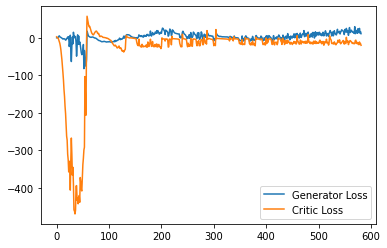

Step 11700: Generator loss: 19.729789599180222, critic loss: -11.721078765869143


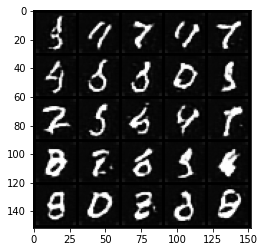

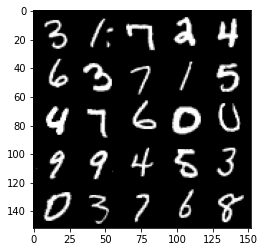

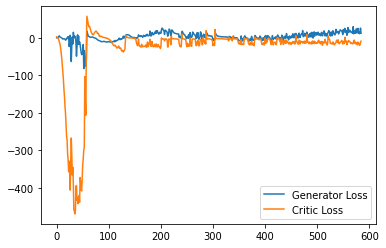

Step 11750: Generator loss: 20.785223615169524, critic loss: -13.036069479465487


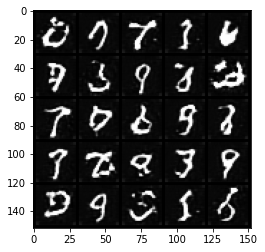

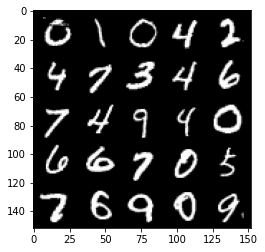

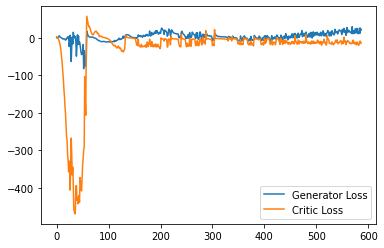

Step 11800: Generator loss: 18.350691819190978, critic loss: -15.852636494398116


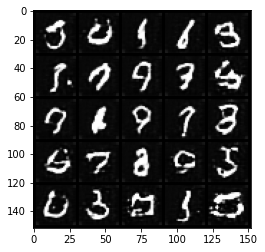

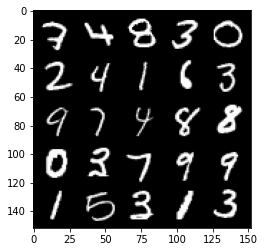

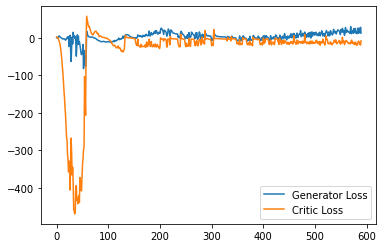

Step 11850: Generator loss: 19.41791334748268, critic loss: -12.042999054789545


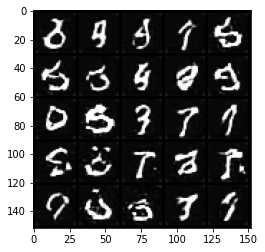

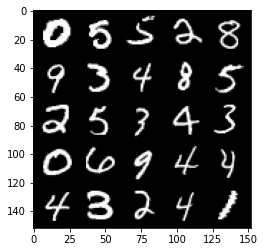

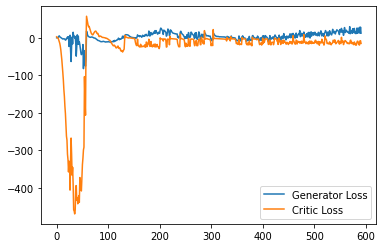

Step 11900: Generator loss: 15.297917239665985, critic loss: -16.27687965774536


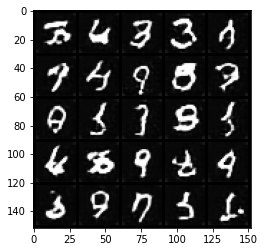

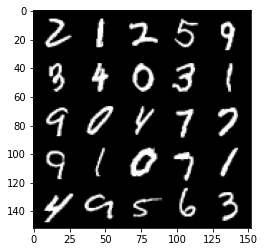

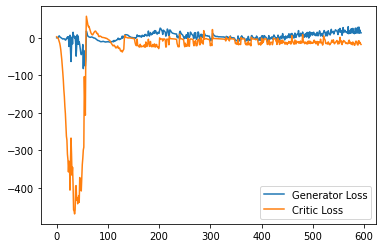

Step 11950: Generator loss: 16.218489903211594, critic loss: -17.654438132643694


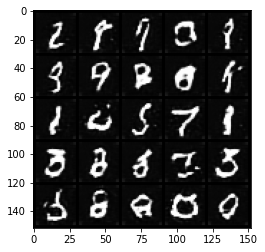

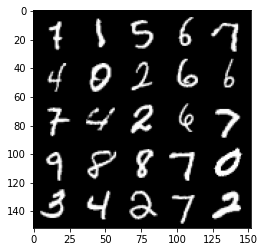

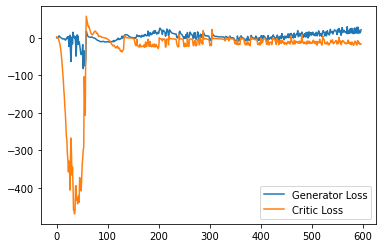

Step 12000: Generator loss: 21.712252259254456, critic loss: -11.731331468343734


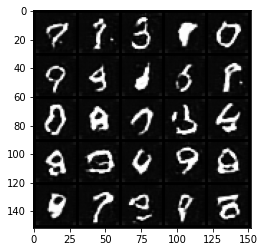

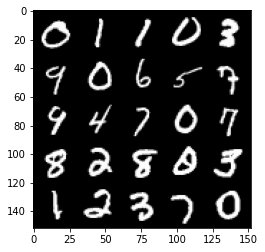

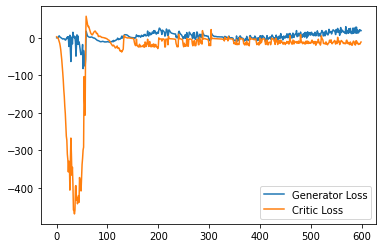

Step 12050: Generator loss: 18.97264697432518, critic loss: -16.618375495910644


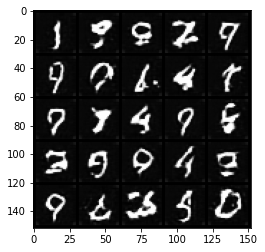

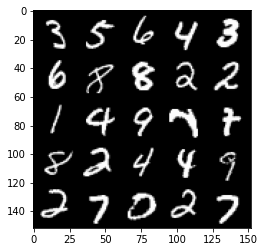

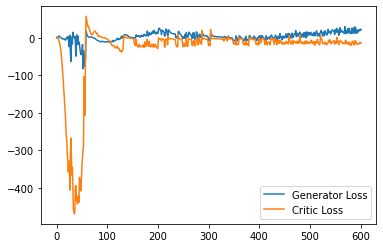

Step 12100: Generator loss: 22.825187163352965, critic loss: -6.463776842594147


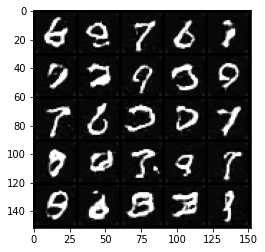

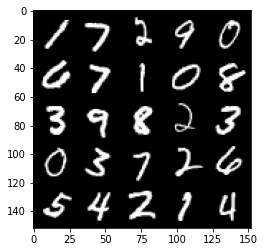

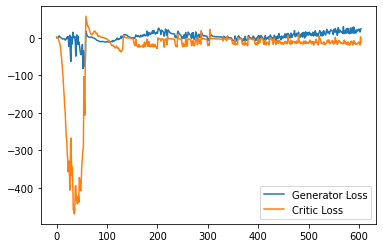

Step 12150: Generator loss: 16.765215282440185, critic loss: -14.734448831081393


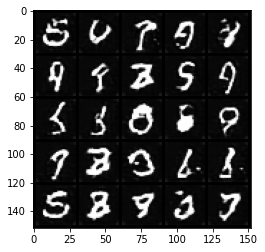

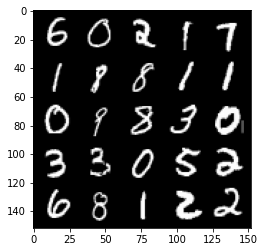

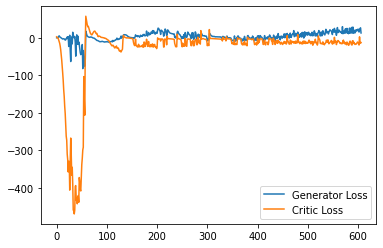

Step 12200: Generator loss: 20.786461653709413, critic loss: -14.407937310695642


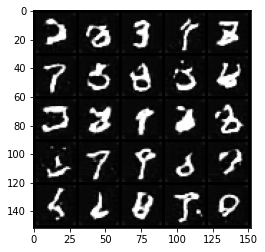

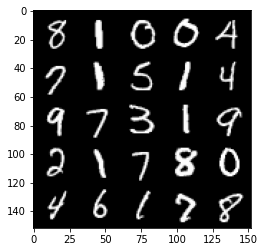

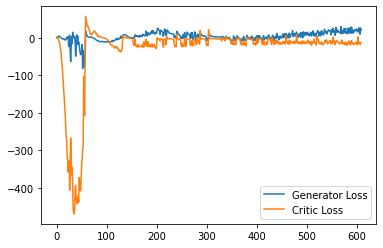

Step 12250: Generator loss: 18.05391382932663, critic loss: -16.358293978095055


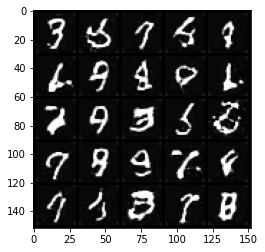

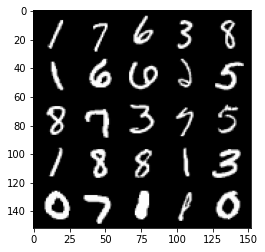

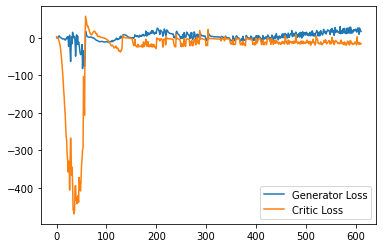

Step 12300: Generator loss: 21.32516324043274, critic loss: -15.038171057224272


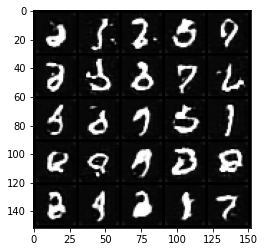

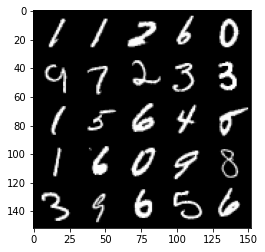

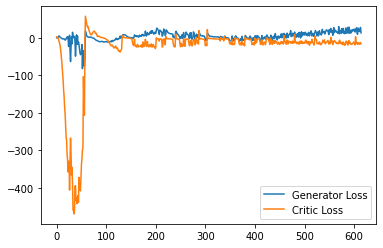

Step 12350: Generator loss: 20.62881867647171, critic loss: -18.61470464372635


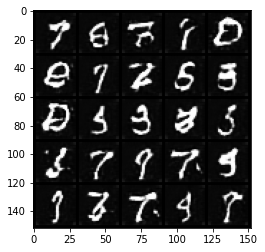

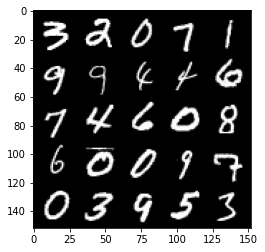

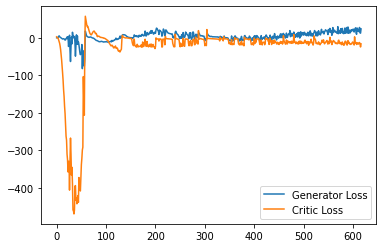

Step 12400: Generator loss: 15.462313055992126, critic loss: -23.638605893373487


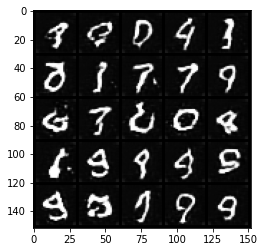

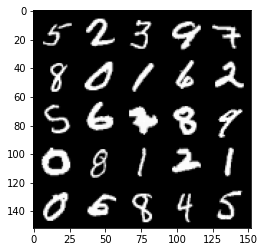

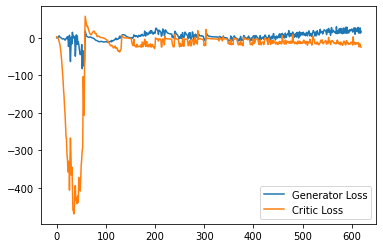

Step 12450: Generator loss: 20.99737639427185, critic loss: -11.818775226354596


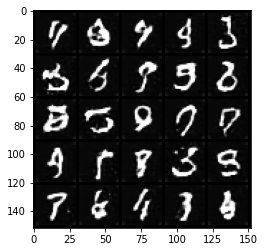

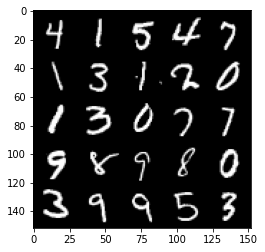

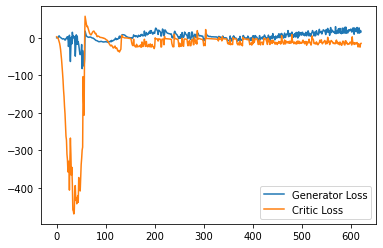

Step 12500: Generator loss: 21.867412548065186, critic loss: -1.8113114743232728


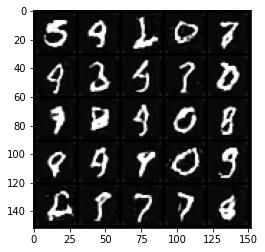

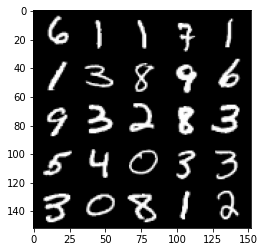

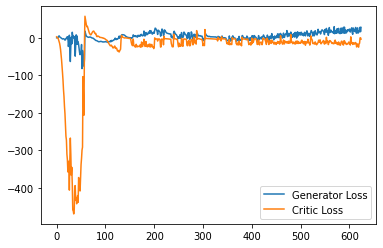

Step 12550: Generator loss: 21.785992938280106, critic loss: -11.623452696561815


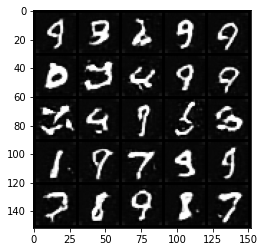

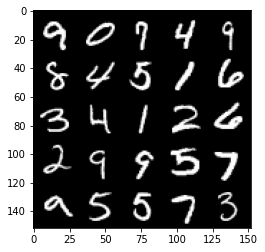

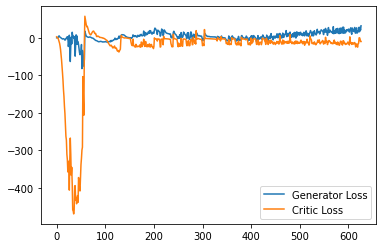

Step 12600: Generator loss: 17.521569462418555, critic loss: -21.064589349985123


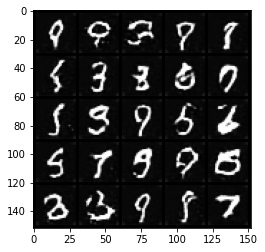

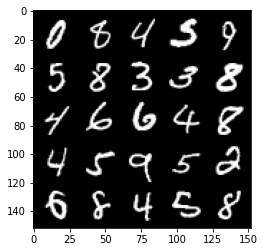

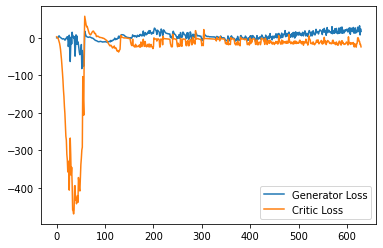

Step 12650: Generator loss: 28.00758487701416, critic loss: -9.612425300121306


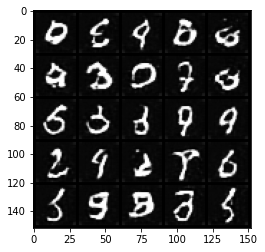

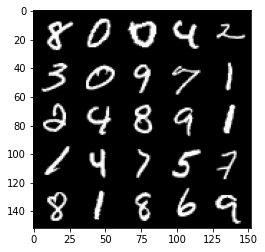

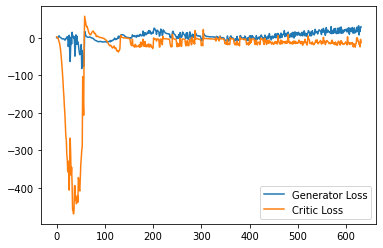

Step 12700: Generator loss: 16.437374150753023, critic loss: -14.999378720045089


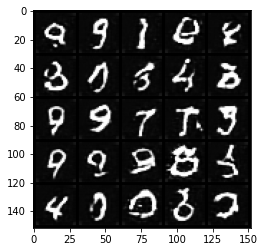

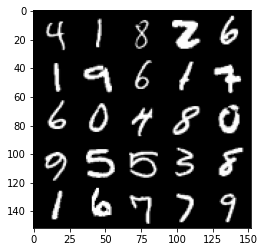

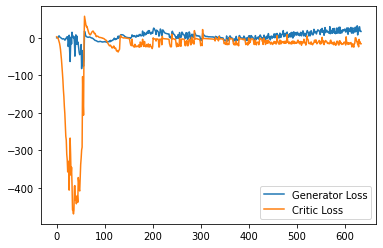

Step 12750: Generator loss: 19.896429270207882, critic loss: -16.802554181814195


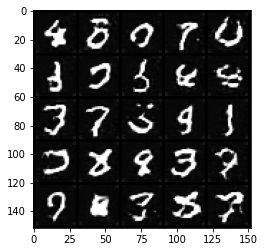

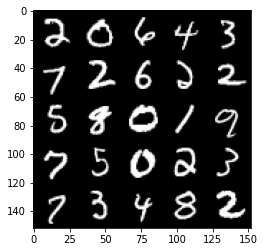

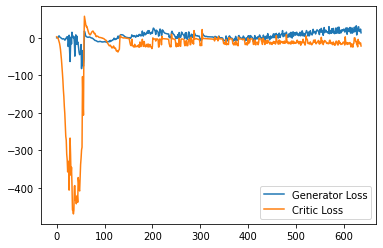

Step 12800: Generator loss: 25.051986451148988, critic loss: -15.034120943665506


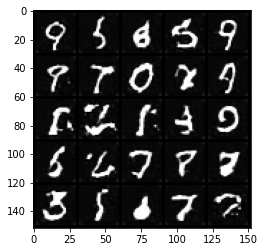

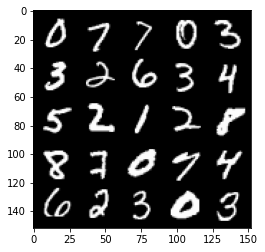

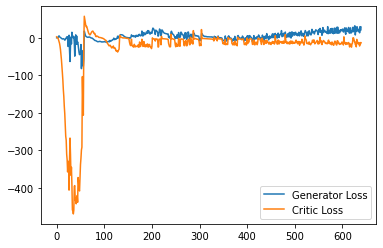

Step 12850: Generator loss: 17.274550009965896, critic loss: -19.61770965242385


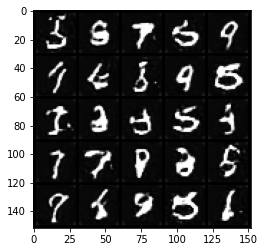

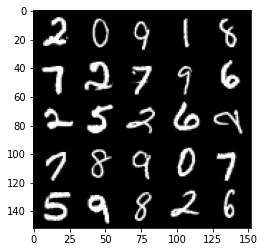

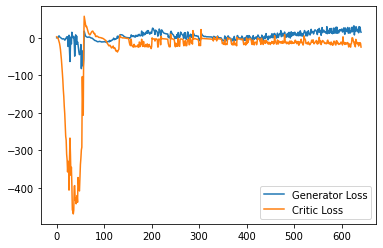

Step 12900: Generator loss: 22.26025975227356, critic loss: -13.103589117527006


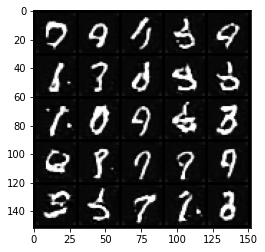

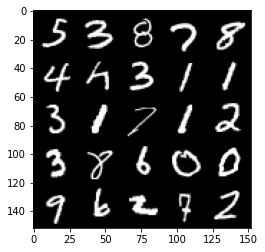

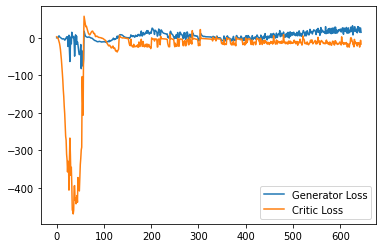

Step 12950: Generator loss: 23.07259178161621, critic loss: -9.439165823578836


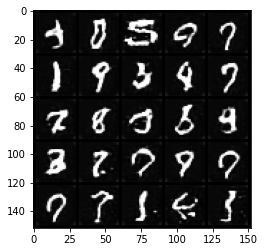

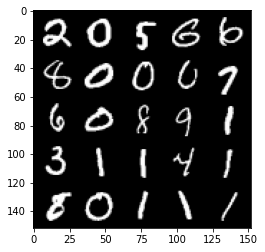

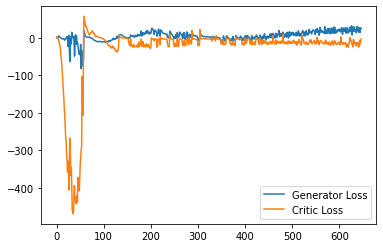

Step 13000: Generator loss: 16.49401183128357, critic loss: -20.019304515838627


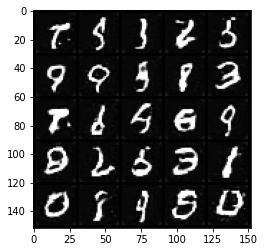

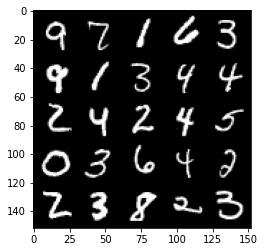

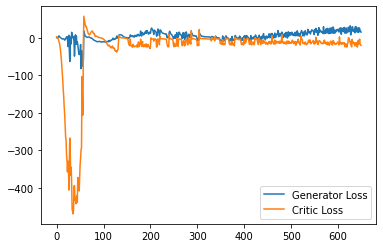

Step 13050: Generator loss: 26.71884485244751, critic loss: -15.327976366043087


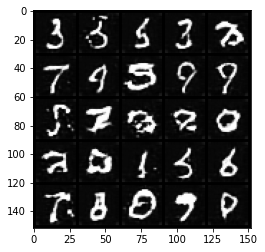

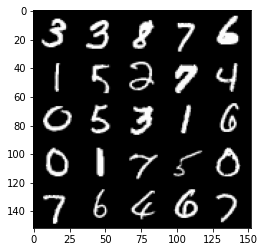

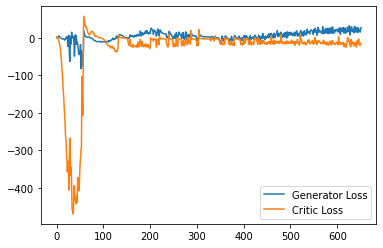

Step 13100: Generator loss: 21.173523494005202, critic loss: -17.031621422290804


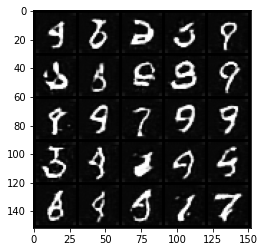

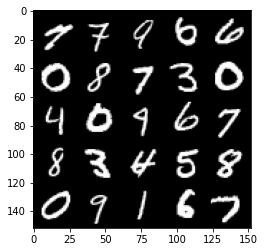

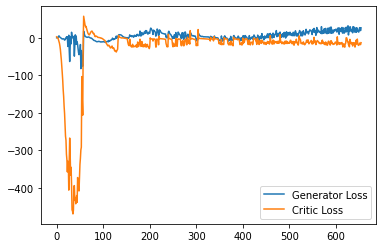

Step 13150: Generator loss: 23.063222877383232, critic loss: -15.855347818136213


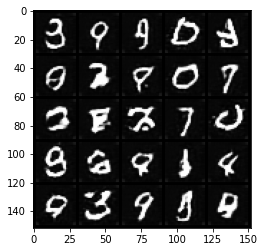

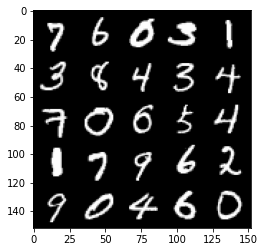

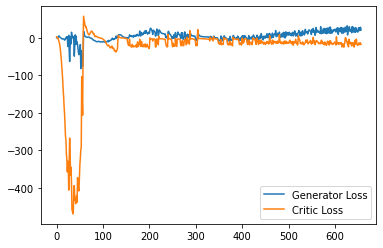

Step 13200: Generator loss: 18.49521584749222, critic loss: -16.846371012091637


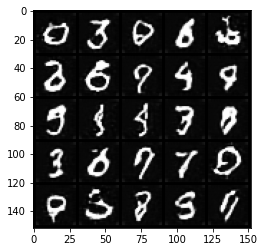

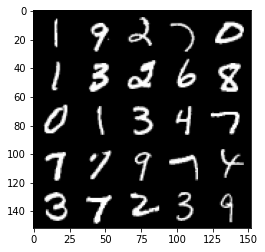

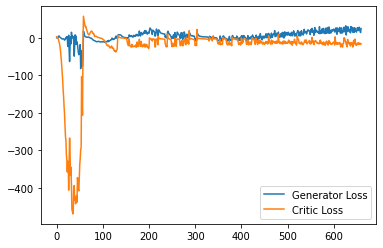

Step 13250: Generator loss: 24.150947041511536, critic loss: -14.393471924185748


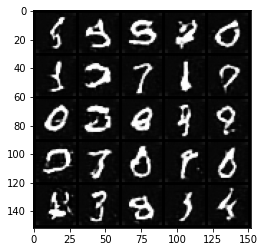

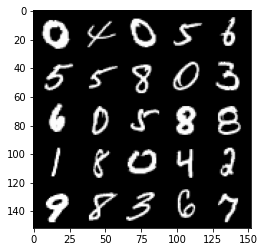

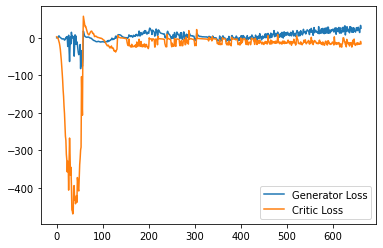

Step 13300: Generator loss: 25.99221787929535, critic loss: -14.940019292354584


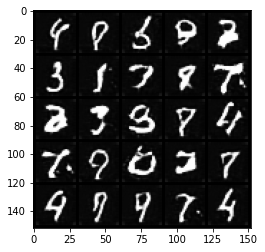

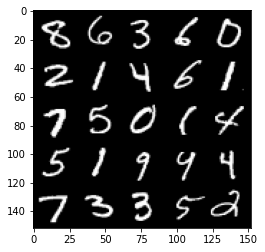

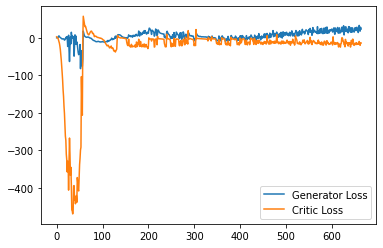

Step 13350: Generator loss: 27.945765960216523, critic loss: -14.322522769689558


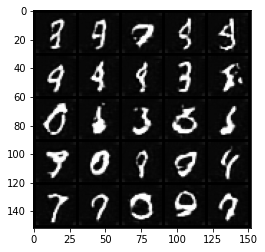

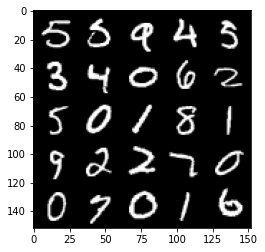

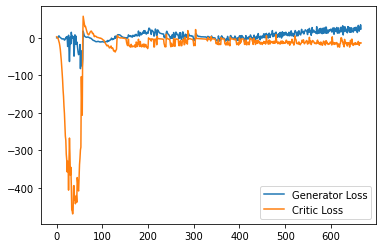

Step 13400: Generator loss: 27.992701110839842, critic loss: -2.907501600384711


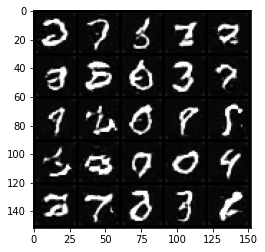

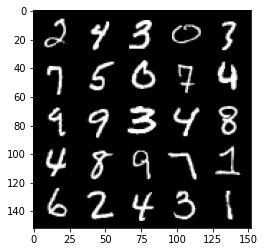

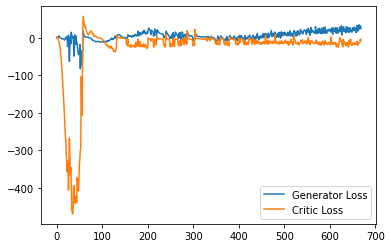

Step 13450: Generator loss: 22.670104885101317, critic loss: -10.051188208580013


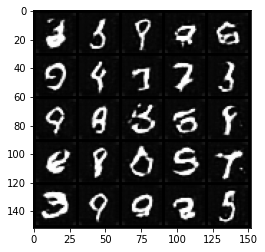

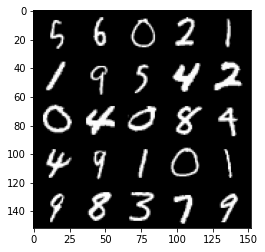

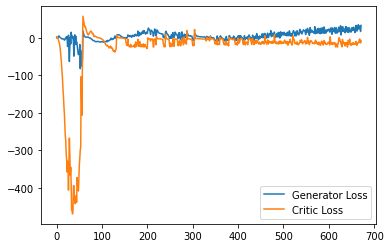

Step 13500: Generator loss: 29.695918974876403, critic loss: -9.606565270423893


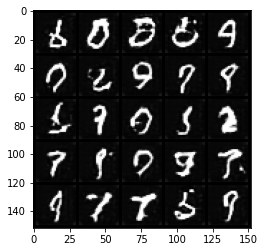

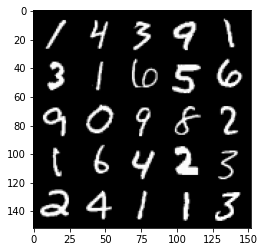

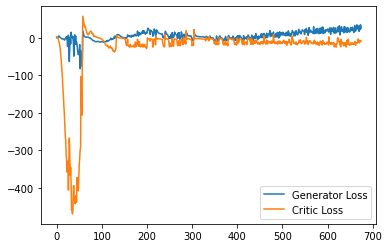

Step 13550: Generator loss: 30.05532042980194, critic loss: -10.491536459445953


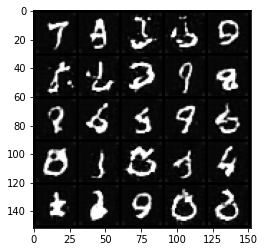

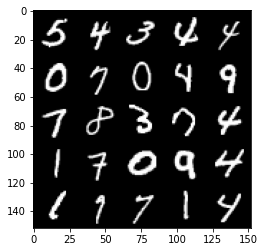

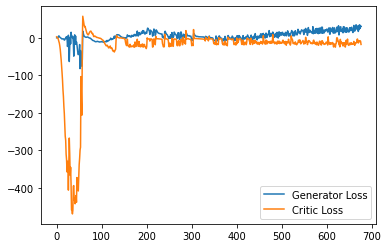

Step 13600: Generator loss: 25.900177192687988, critic loss: -3.7197938473224643


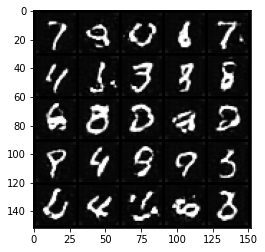

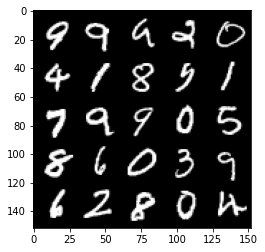

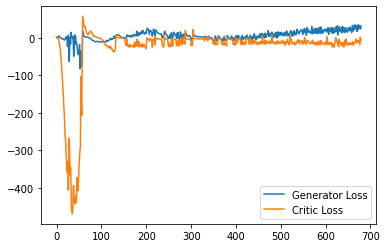

Step 13650: Generator loss: 30.422017803192137, critic loss: -9.763626798629764


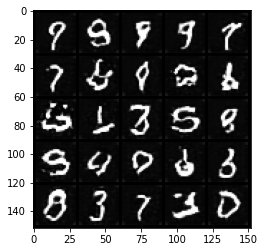

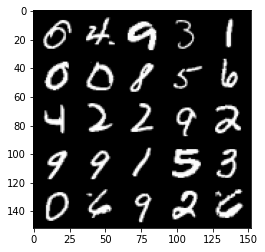

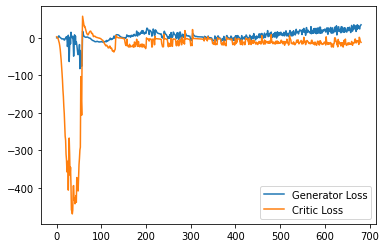

Step 13700: Generator loss: 29.75565793991089, critic loss: -12.256356789588931


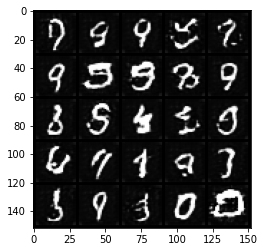

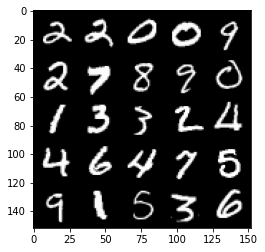

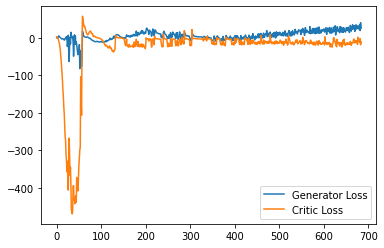

Step 13750: Generator loss: 24.589466190338136, critic loss: -5.4105323073864


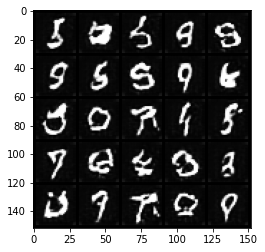

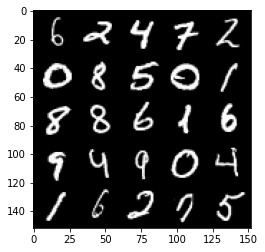

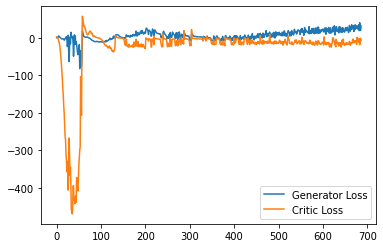

Step 13800: Generator loss: 21.314518984556198, critic loss: -11.781127444744108


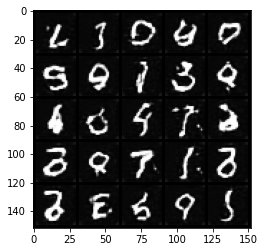

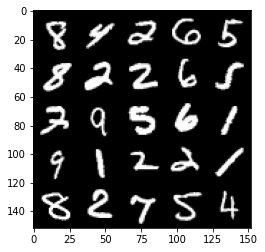

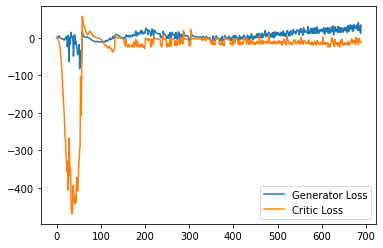

Step 13850: Generator loss: 24.393577756881715, critic loss: -15.904528121471403


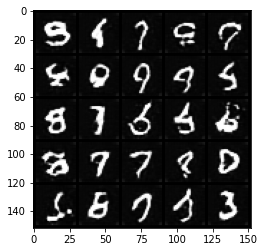

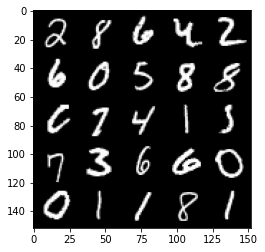

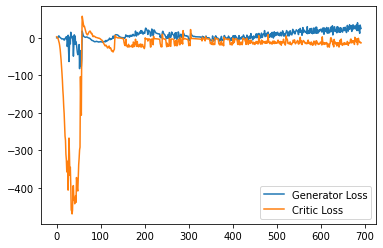

Step 13900: Generator loss: 20.283557100296022, critic loss: -18.032246916532515


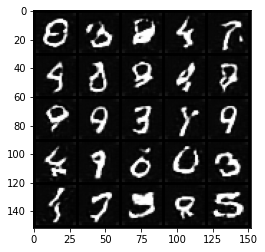

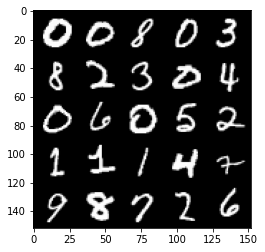

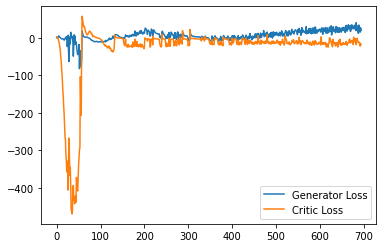

Step 13950: Generator loss: 25.604297490119933, critic loss: -18.63853350162505


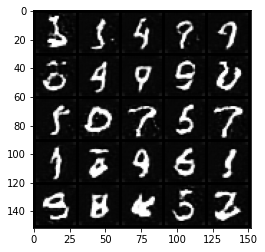

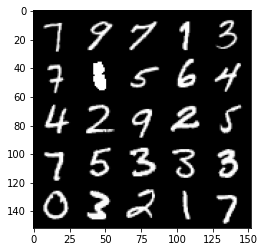

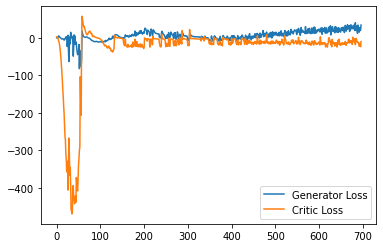

Step 14000: Generator loss: 23.934067508578302, critic loss: -18.395820884943003


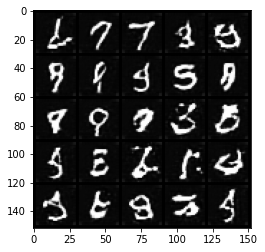

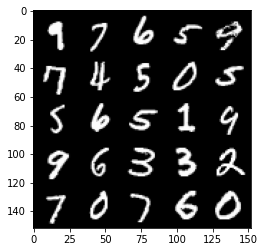

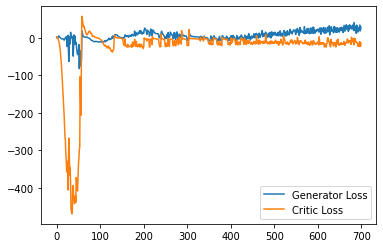

Step 14050: Generator loss: 24.803957362174987, critic loss: -15.384874781966206


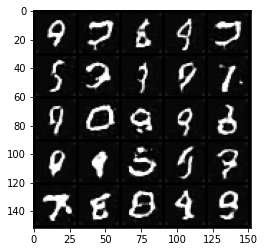

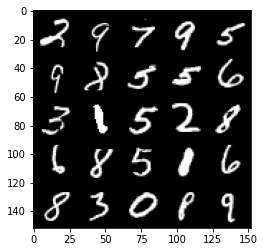

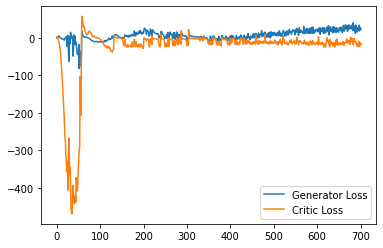

Step 14100: Generator loss: 29.0302548456192, critic loss: -15.825791098356252


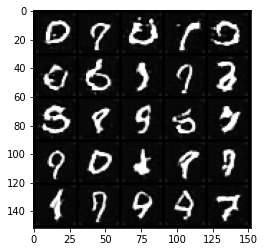

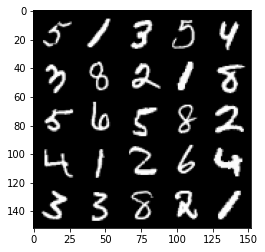

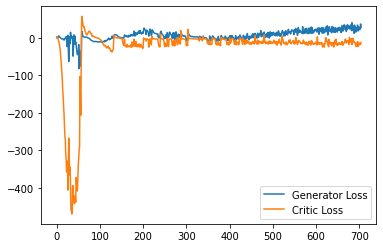

Step 14150: Generator loss: 31.339715547561646, critic loss: -13.987816539049152


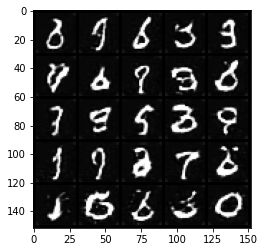

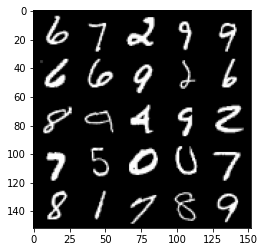

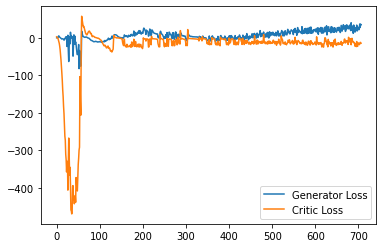

Step 14200: Generator loss: 30.000963304042816, critic loss: -10.014514035701753


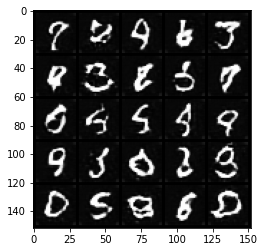

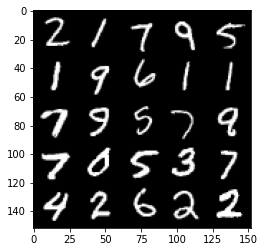

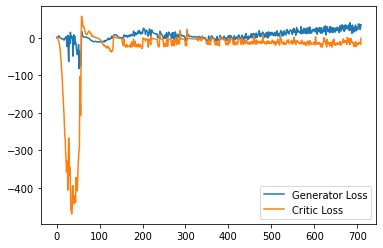

Step 14250: Generator loss: 26.187229189872742, critic loss: -14.039313668966289


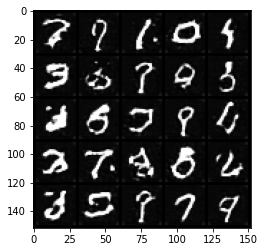

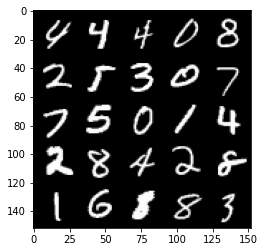

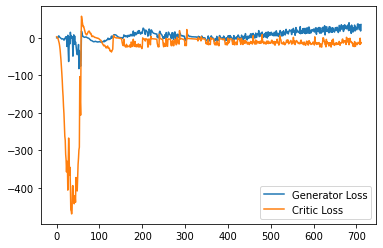

Step 14300: Generator loss: 28.24596223831177, critic loss: -13.714559439659105


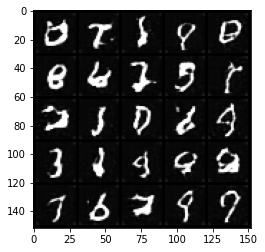

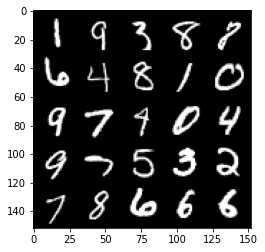

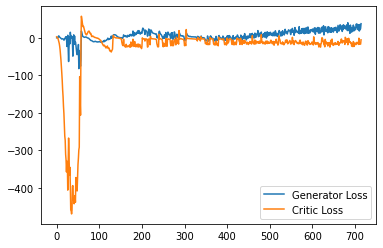

Step 14350: Generator loss: 29.79651062011719, critic loss: -7.114505729675294


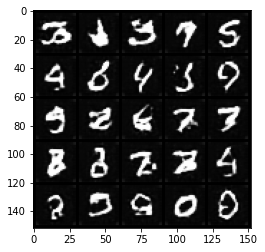

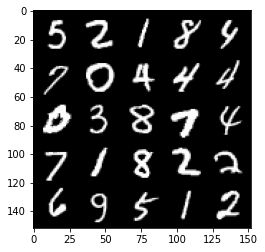

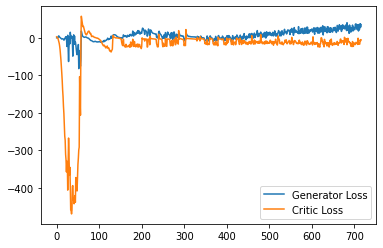

Step 14400: Generator loss: 30.027383365631103, critic loss: -12.2820447640419


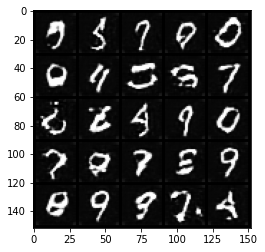

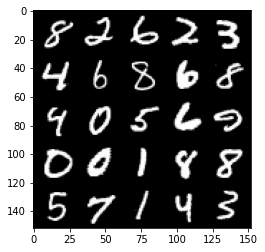

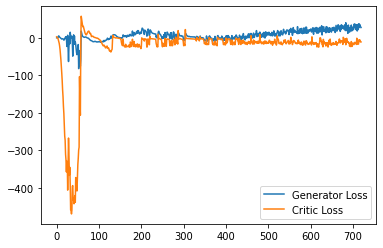

Step 14450: Generator loss: 21.35127435564995, critic loss: -17.090689457535746


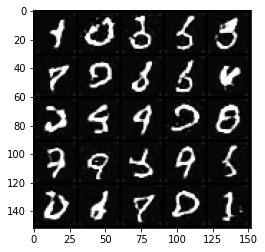

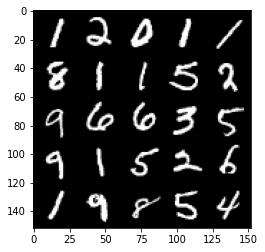

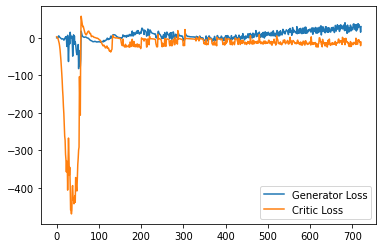

Step 14500: Generator loss: 26.723189659118653, critic loss: -12.864993927478794


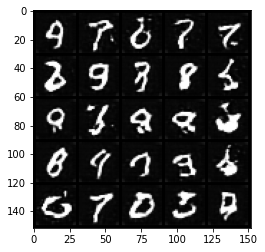

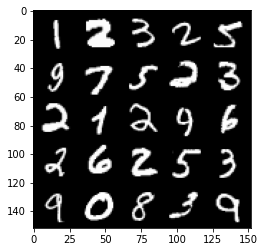

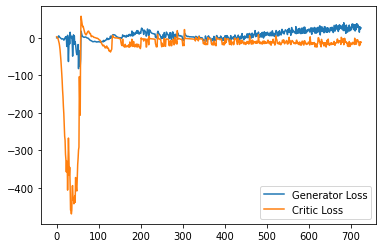

Step 14550: Generator loss: 34.26953818321228, critic loss: -14.998998231530186


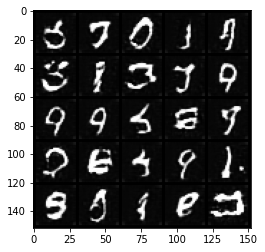

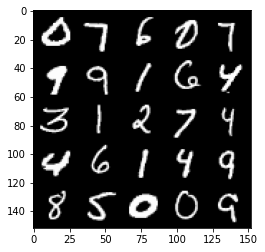

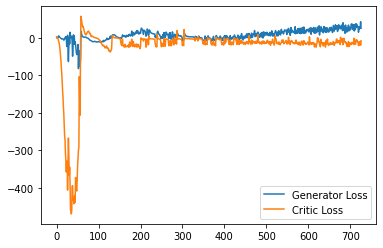

Step 14600: Generator loss: 26.41769735336304, critic loss: -2.1248632128238665


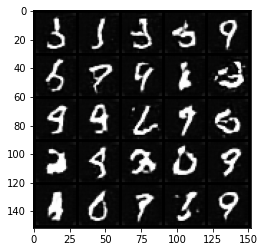

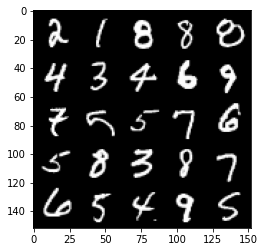

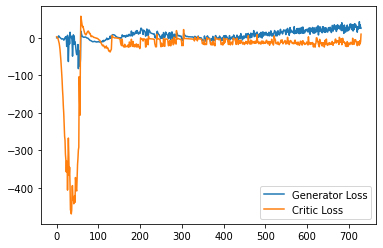

Step 14650: Generator loss: 30.55977844238281, critic loss: -9.920784540891647


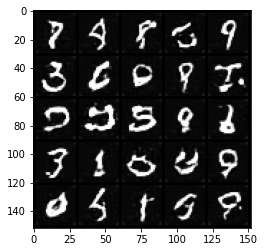

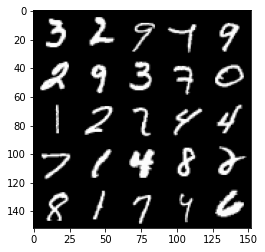

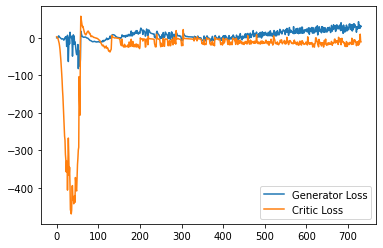

Step 14700: Generator loss: 27.359341020584107, critic loss: -10.257999907732012


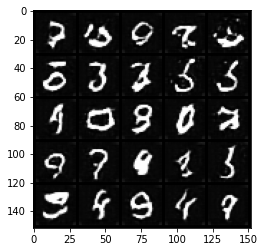

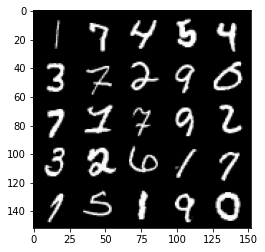

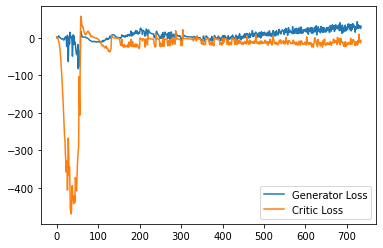

Step 14750: Generator loss: 25.578245161771775, critic loss: -13.209824026346206


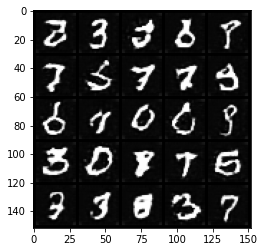

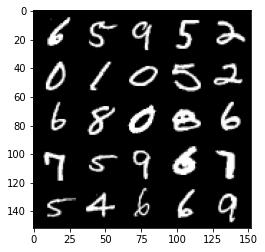

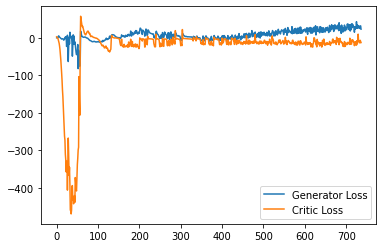

Step 14800: Generator loss: 34.1348655128479, critic loss: -9.912587870121001


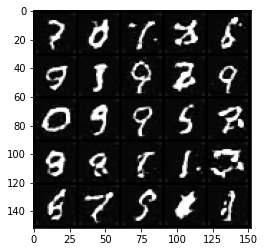

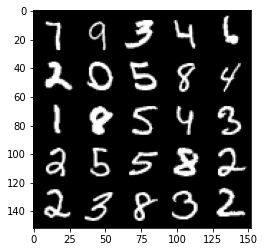

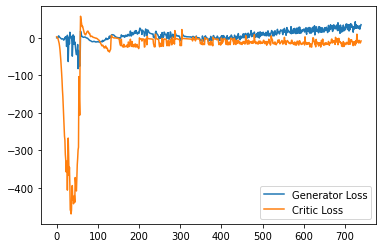

Step 14850: Generator loss: 28.64930926799774, critic loss: -15.642814831495292


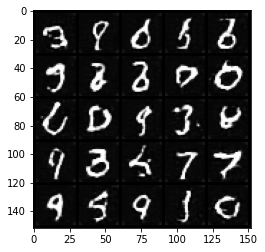

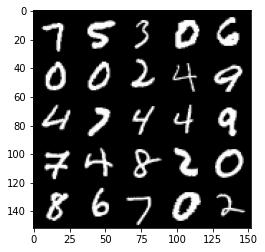

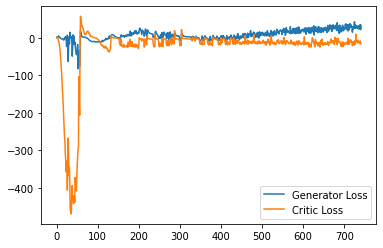

Step 14900: Generator loss: 27.29502948999405, critic loss: -15.069601964473723


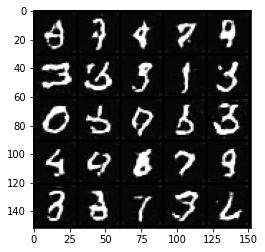

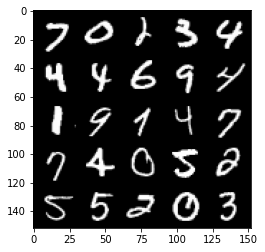

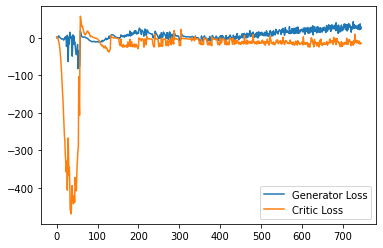

Step 14950: Generator loss: 27.439477195739745, critic loss: -18.156785979747777


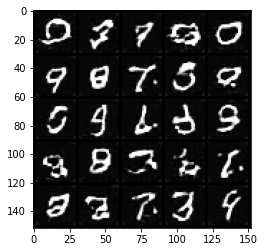

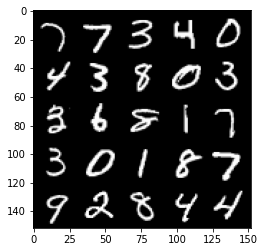

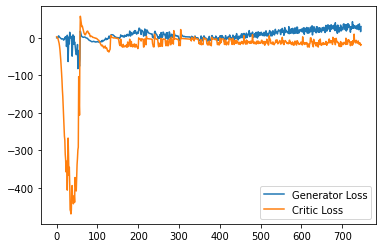

Step 15000: Generator loss: 22.787080171108247, critic loss: -18.430169364929192


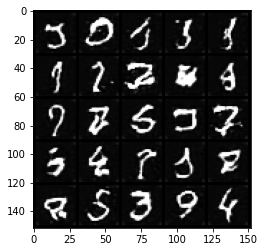

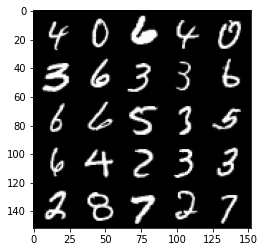

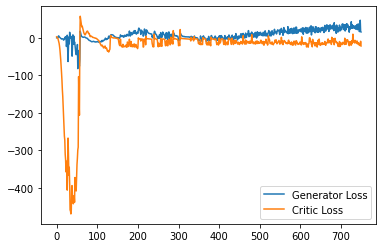

Step 15050: Generator loss: 33.351835005283355, critic loss: -12.879786356449126


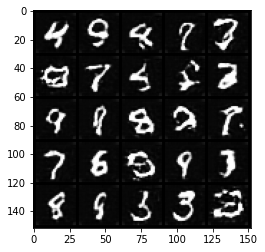

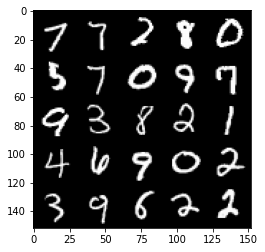

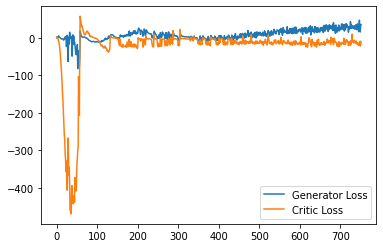

Step 15100: Generator loss: 29.83937622785568, critic loss: -10.099608444452285


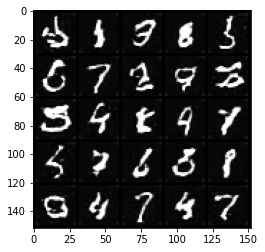

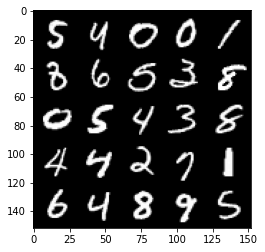

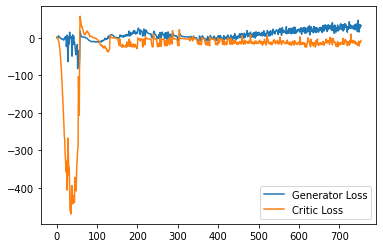

Step 15150: Generator loss: 33.73997934818268, critic loss: -13.49536739057303


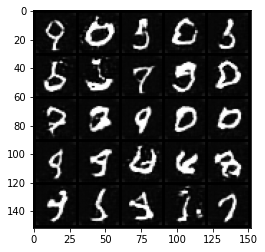

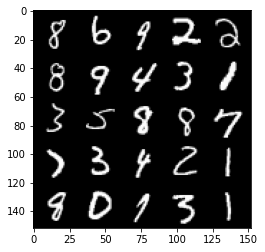

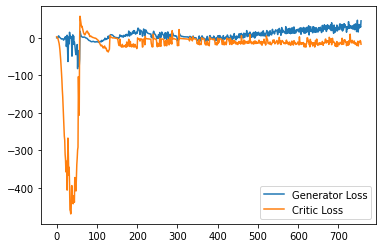

Step 15200: Generator loss: 27.249054866433145, critic loss: -16.37811762857437


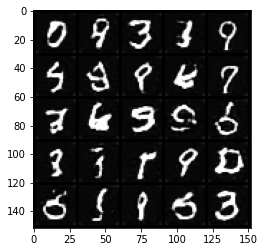

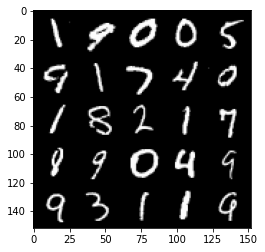

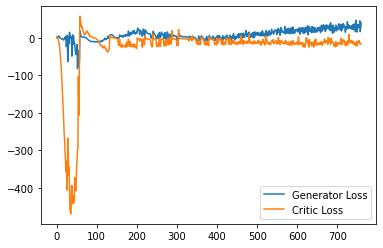

Step 15250: Generator loss: 32.8652802658081, critic loss: -11.432045717895033


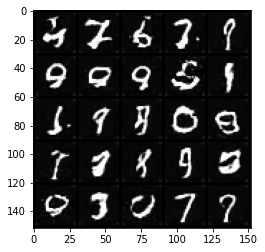

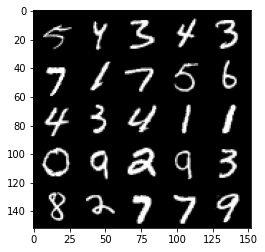

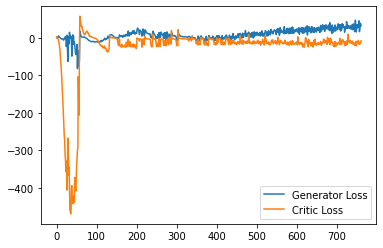

Step 15300: Generator loss: 28.727438464164734, critic loss: -13.216968111276628


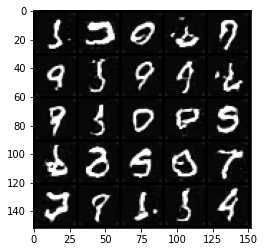

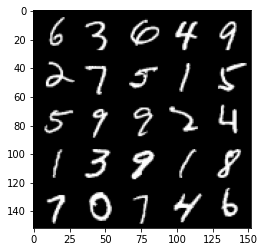

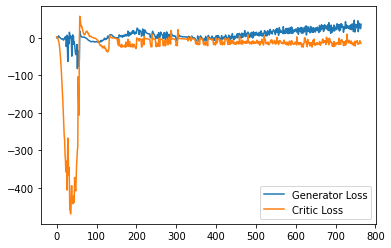

Step 15350: Generator loss: 27.551548285484316, critic loss: -15.063036096572876


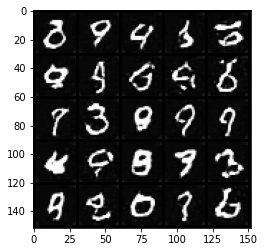

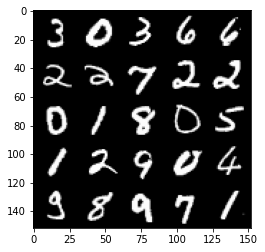

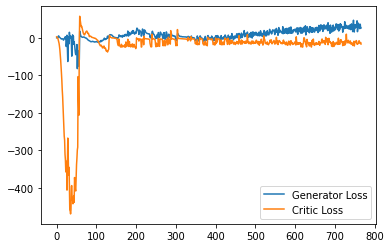

Step 15400: Generator loss: 36.22172389984131, critic loss: 0.5860789809227005


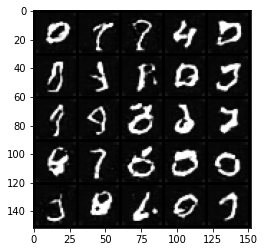

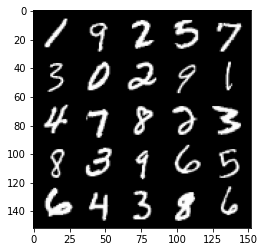

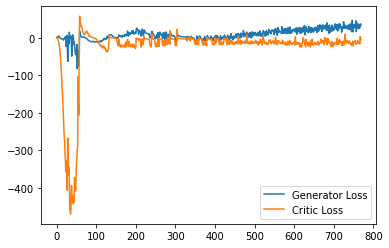

Step 15450: Generator loss: 29.705959923267365, critic loss: -11.173646993160245


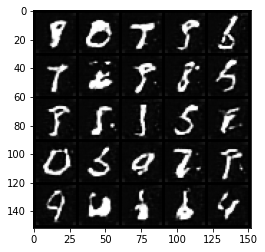

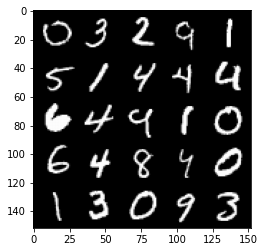

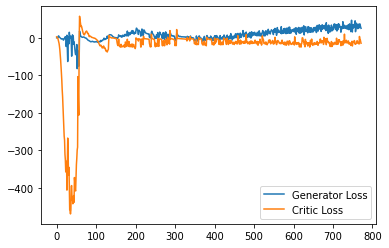

Step 15500: Generator loss: 22.192915019989012, critic loss: -18.106240298032766


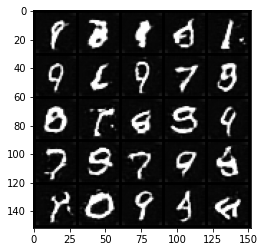

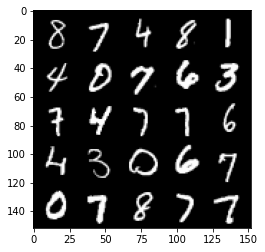

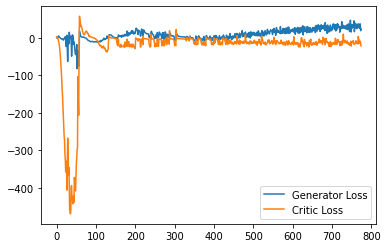

Step 15550: Generator loss: 34.81270248413086, critic loss: -12.658926933526994


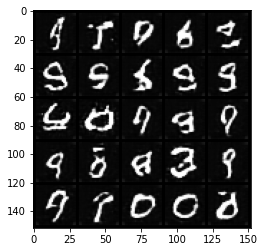

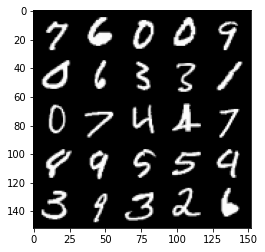

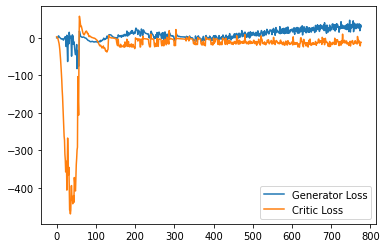

Step 15600: Generator loss: 31.067817001342775, critic loss: -9.802160578250888


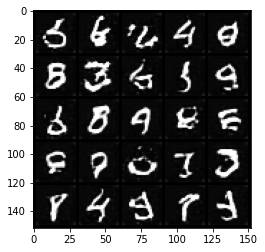

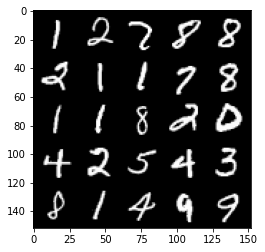

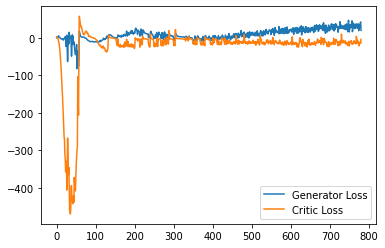

Step 15650: Generator loss: 29.311099948883058, critic loss: -13.621876055240632


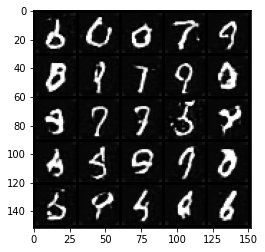

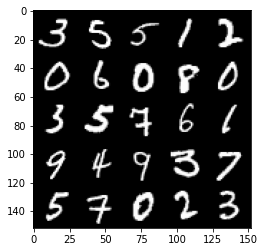

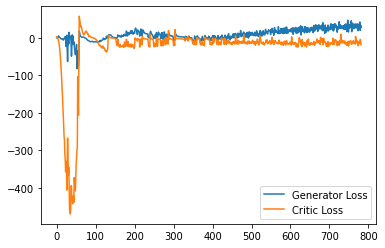

Step 15700: Generator loss: 29.711031227111818, critic loss: -17.435475631237026


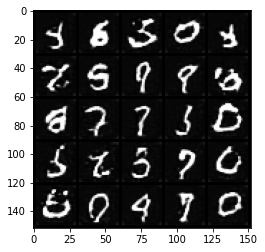

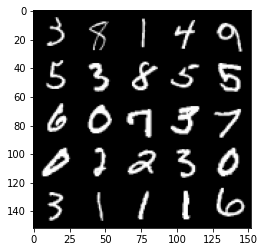

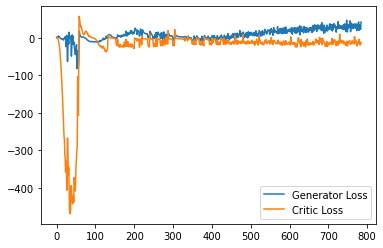

Step 15750: Generator loss: 31.64766369342804, critic loss: -15.310533338904383


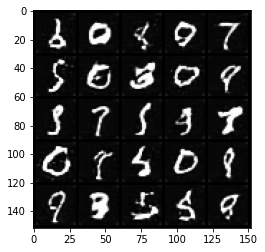

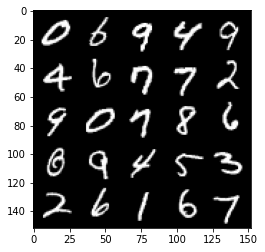

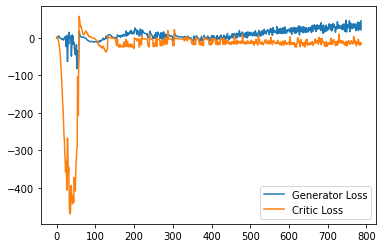

Step 15800: Generator loss: 26.91483277320862, critic loss: -7.357594517827035


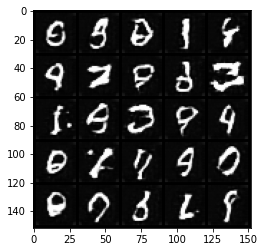

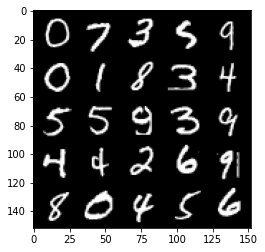

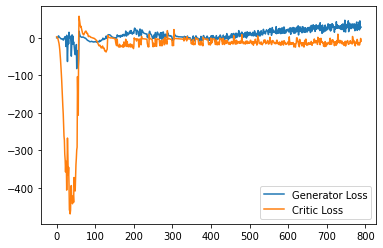

Step 15850: Generator loss: 23.733611906766892, critic loss: -17.678592420101165


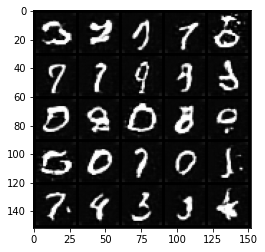

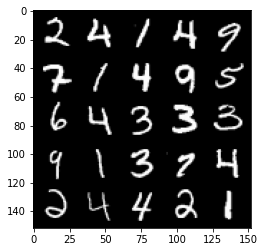

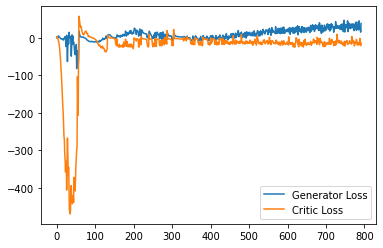

Step 15900: Generator loss: 27.517236915826796, critic loss: -19.79603810477256


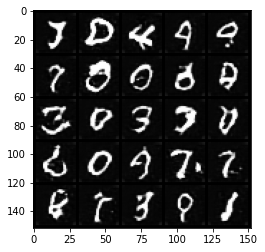

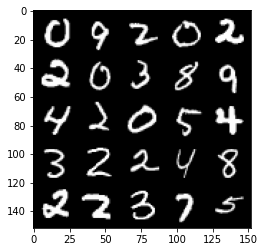

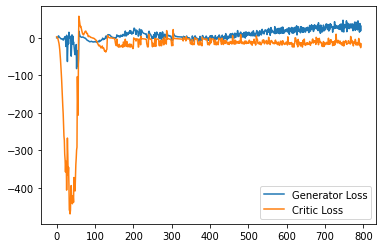

Step 15950: Generator loss: 25.07140739619732, critic loss: -19.608343689441682


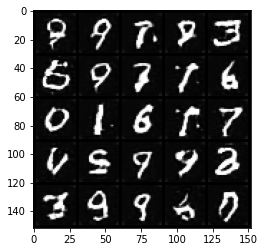

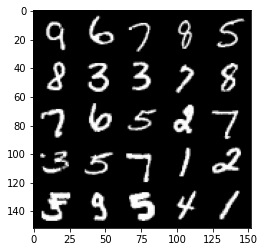

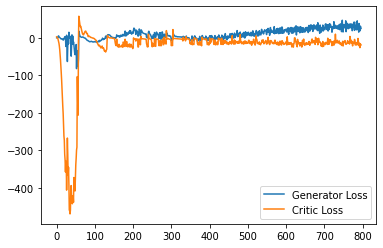

Step 16000: Generator loss: 39.3902996635437, critic loss: -9.775693245887755


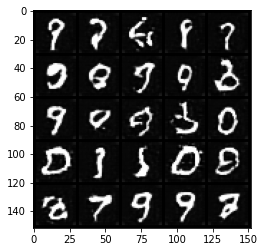

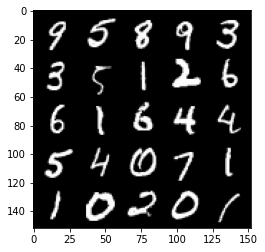

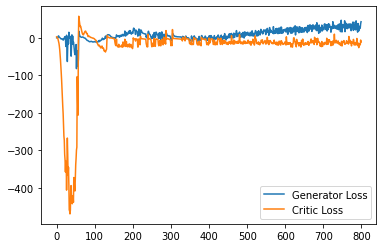

Step 16050: Generator loss: 30.836123657226562, critic loss: -5.999956977844237


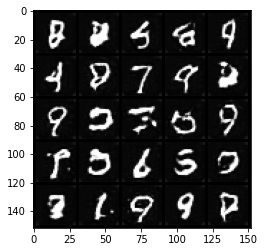

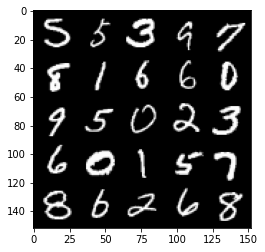

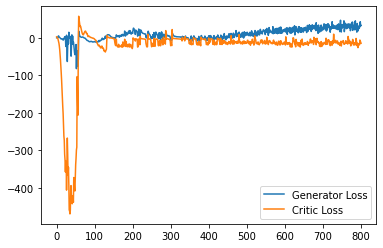

Step 16100: Generator loss: 40.06572196960449, critic loss: -5.685901918888093


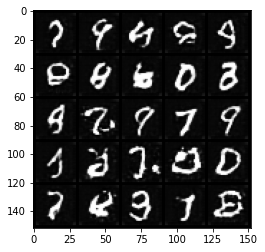

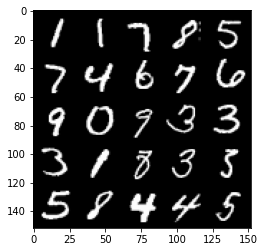

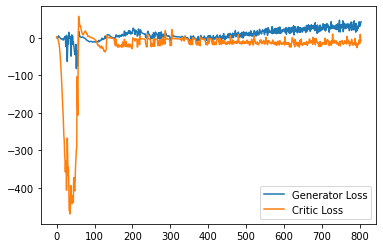

Step 16150: Generator loss: 30.99676739692688, critic loss: -14.710667182445524


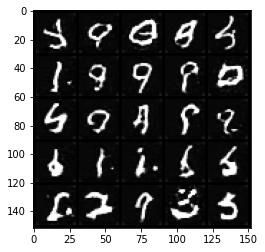

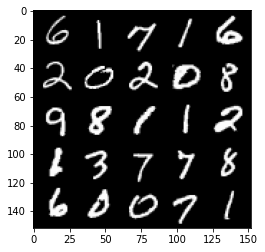

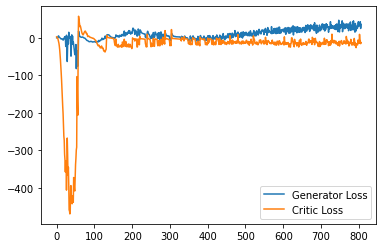

Step 16200: Generator loss: 35.7613877633214, critic loss: -13.84119317293167


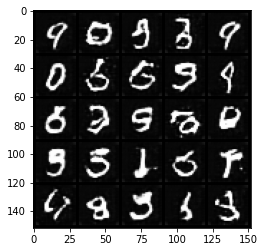

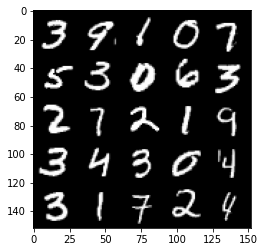

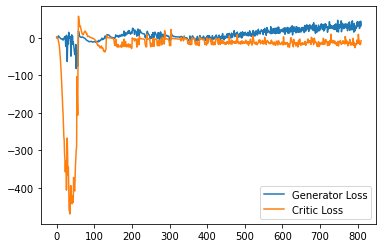

Step 16250: Generator loss: 40.999325618743896, critic loss: -12.051312803268436


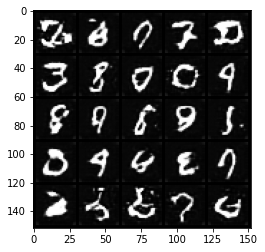

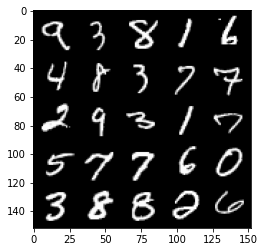

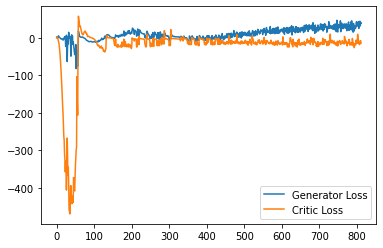

Step 16300: Generator loss: 29.64705314218998, critic loss: -15.513489647150045


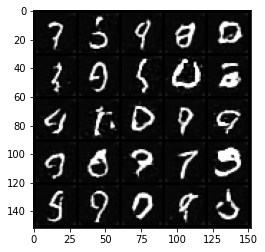

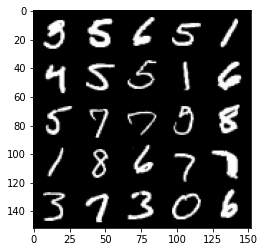

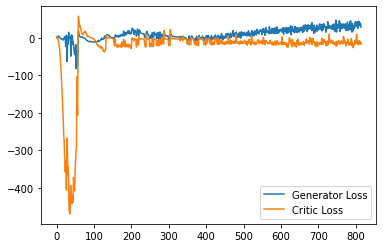

Step 16350: Generator loss: 30.198430371284484, critic loss: -16.556418927788737


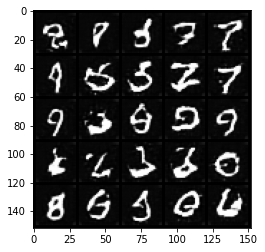

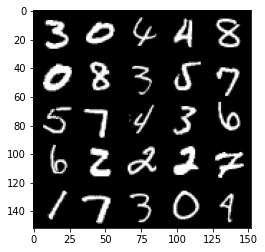

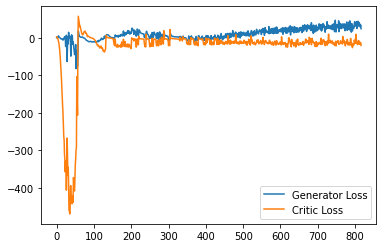

In [45]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1


In [46]:
!pip freeze